In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


###Requirements

In [1]:
!pip install sentence_transformers
!pip install bertopic
!pip install rdflib


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 79 kB 3.4 MB/s 
     |████████████████████████████████| 4.4 MB 42.6 MB/s 
     |████████████████████████████████| 1.2 MB 55.4 MB/s 
     |████████████████████████████████| 86 kB 6.1 MB/s 
     |████████████████████████████████| 596 kB 53.5 MB/s 
     |████████████████████████████████| 6.6 MB 56.3 MB/s 
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.0-py3-none-any.whl size=120747 sha256=7e430bba9eeb371f9fb3f0fd5c481bddbe59765d9602ea80db47725d89da6599
  Stored in directory: /root/.cache/pip/wheels/83/c0/df/b6873ab7aac3f2465aa9144b6b4c41c4391cfecc027c8b07e7
Successfully built sentence-transformers
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wh

In [2]:
import numpy as np
import pandas as pd
import os

from transformers import AutoTokenizer, AutoModelForSeq2SeqLM, pipeline
from sentence_transformers import SentenceTransformer, util
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import defaultdict
import spacy
import math
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from nltk.tokenize import sent_tokenize

from rdflib import Graph, URIRef, Literal

print('Loading models...')

nlp = spacy.load("en_core_web_sm")


import nltk
nltk.download('punkt')

#modelli
embedder = SentenceTransformer('all-MiniLM-L6-v2')
model_name = "deepset/roberta-base-squad2"
qaModel = pipeline(model=model_name, tokenizer=model_name, revision="v1.0", task="question-answering")

#summarizer = pipeline("summarization", model="sshleifer/distilbart-cnn-6-6", tokenizer="sshleifer/distilbart-cnn-6-6") #, framework="tf")

print('Model loaded.')


Loading models...


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/559 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/476M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/189 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/878k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/446k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/150 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/571 [00:00<?, ?B/s]

Model loaded.


###Data preprocessing

In [3]:
def data_preprocessing (df):
  '''
  Transforms the output of the PICO classifier into an ordered dictionary that can be read by the clustering tool.
  *input*:
  - df: file excel | or name of the classifier output.
  *output*
  - dict | dict sorted according to PICO labels
  '''
  list_text = pd.read_excel(df)
  labels = ['A','I','C','R','M','O','P']
  
  text_dict = {k:[] for k in labels}  
  for label in labels:
    for text in list_text['abstract']:
      sent = text.split('].')
      group = []
      for ele in sent:
        if f"[{label}" in ele.strip() :
          group += [' '.join([char for char in ele.replace(f"[{label}",'').strip().split() if '###' not in char])] 
      text_dict[label]+= ['. '.join(group)]
  
  text_dict = {k:[ele for ele in v if ele != ''] for k,v in text_dict.items()}
  v=text_dict['I']

  print(f'Text dict size: {len(text_dict)}')

  return text_dict



In [ ]:
#[1] formato --> sentence per row

# abstract = pd.read_excel('/content/drive/MyDrive/CNR/medical_review_project/valutazioneAbstract.xlsx')
# abstract = pd.DataFrame([row for i,row in abstract.iterrows() if type(row['nostra valutazione']) != float])
# labels = ['A', 'I', 'C','R', 'M','O', 'P']
# abstract = abstract[abstract['nostra valutazione'].isin(labels)]

# labels_index = {label:[r['sentence'] for i,r in abstract.iterrows() if r['nostra valutazione'] == label] for label in labels}
# print(labels_index)

###Clustering

In [6]:
class Clustering_utils:

  @staticmethod
  def plot_dendrogram(model, **kwargs):
      # Create linkage matrix and then plot the dendrogram
      # Create the counts of samples under each node
      counts = np.zeros(model.children_.shape[0])
      n_samples = len(model.labels_)
      for i, merge in enumerate(model.children_):
          current_count = 0
          for child_idx in merge:
              if child_idx < n_samples:
                  current_count += 1  # leaf node
              else:
                  current_count += counts[child_idx - n_samples]
          counts[i] = current_count

      linkage_matrix = np.column_stack(
          [model.children_, model.distances_, counts]
      ).astype(float)
      
      # Plot the corresponding dendrogram
      dendrogram(linkage_matrix, **kwargs)

  @staticmethod
  def distance (corpus):
    corpus_embeddings = ClusteringManager.get_instance().get_embedder().encode(corpus)

    #calcola la soglia per la distanza: numero di default iniziale.
    default_number = 100

    # Normalize the embeddings to unit length
    corpus_embeddings = corpus_embeddings /  np.linalg.norm(corpus_embeddings, axis=1, keepdims=True)
    # Perform clustering
    clustering_model = AgglomerativeClustering(n_clusters=None, 
                                              distance_threshold=default_number)  
    
    #calcola la soglia a posteriori e rettifica il numero di default. 
    count = sorted(clustering_model.fit(corpus_embeddings).distances_,reverse=True)
    distance_treeshold = count[1]
    return distance_treeshold

  @staticmethod
  def clustering (corpus, out_file: str = None): 
    corpus_embeddings = ClusteringManager.get_instance().get_embedder().encode(corpus)

    #calcola la soglia per la distanza. 
    number_of_distance = Clustering_utils.distance(corpus)
    print(f"Treeshold for clustering: {number_of_distance}")

    # Normalize the embeddings to unit length
    corpus_embeddings = corpus_embeddings /  np.linalg.norm(corpus_embeddings, axis=1, keepdims=True)
    # Perform clustering
    clustering_model = AgglomerativeClustering(n_clusters=None, 
                                              distance_threshold= number_of_distance) #parti dal livello più alto e poi filtra l'albero. 
    
    clustering_model.fit(corpus_embeddings)
    cluster_assignment = clustering_model.labels_

    #plot
    plt.title("Hierarchical Clustering Dendrogram")
    # plot the top three levels of the dendrogram
    Clustering_utils.plot_dendrogram(clustering_model.fit(corpus_embeddings), truncate_mode="level") #, p=3)
    plt.xlabel("Number of points in node (or index of point if no parenthesis).")

    if out_file:
      plt.savefig(out_file)
    else:
      plt.show()

    clustered_sentences = defaultdict(list) 
    for sentence_id, cluster_id in enumerate(cluster_assignment):
        clustered_sentences[cluster_id].append((sentence_id,corpus[sentence_id]))

    results = []
    for i, cluster in clustered_sentences.items():
      results+=[cluster]

    return results

  @staticmethod
  def tf_idf_Chunk (cluster_doc,document_doc):
    '''
    La metrica è calcolata prendendo in considerazione sia i chunks che compongono il singolo cluster sia tutti i chunks ricavati dall'analisi del campione dato originariamente in input.
    >>> chunks sottoinsieme label X : chunks all labels
    '''
    # Lemmatizzazione, divisione in chunk ed eliminazione punteggiatura e stopwords dagli elementi che compongono il cluseter.
    # cluster_lemma_tot = [chunk1, chunk2, ...] >>> tutti i chunk che compongono quel dato cluster
    cluster_chunked = [[chunk.text for chunk in nlp(sent).noun_chunks] for i,sent in cluster_doc]
    cluster_lemma = [[' '.join([chunk.lemma_.lower() for chunk in nlp(ele) if chunk.is_stop == False and chunk.is_punct == False]) for ele in sent] for sent in cluster_chunked]
    cluster_lemma_tot = [char for ele in cluster_lemma for char in ele if char != '']
    # document_doc = chunks ricavati dall'intero sample.  
    document_lemma_tot = [char for ele in document_doc for char in ele if char != '']

    # tf = {word: word count in cluster / number of sentences in the cluster}
    # i.e. 'Covid-19' è contenuto 5 volte nel cluster 'A'. Questo cluster è composto da 100 elementi >>> {'Covid-19':5/100, ...}
    tf = {word: cluster_lemma_tot.count(word)/len(cluster_lemma) for word in set(cluster_lemma_tot)}
    #idf = {word: logarithm of the ratio of the number of documents in the collection to the number of items in the collection that include 'word'}
    # i.e. 'Covid-19' è contenuto in 10 frasi prendendo in considerazione la collezione di tutti i documenti che compongono la classificazione PICO iniziale (num_word).
    #       Il numero totale di documenti che compongono la collezione è pari a 1000. >>> {'Covid-19': log(10/1000), ...}  
    num_word = {word:sum([1 for doc in document_doc if word in doc]) for word in set(cluster_lemma_tot) } #numero di doc in cui la parola compare nell'insieme totale di abstract che compongono il sample
  
    idf = {word: math.log(len(document_doc)/num) for word,num in num_word.items()}
    #tf-idf = tf*idf
    tf_idf = {word:tf_value*idf[word] for word,tf_value in tf.items()}
    tf_idf = {k: v for k, v in sorted(tf_idf.items(), key=lambda item: item[1], reverse=True)}

    print("WordCloud for chunks according to Tf-Idf score:")
    word_cloud = WordCloud(collocations = False, background_color = 'white').fit_words(tf_idf)
    # Display the generated Word Cloud
    plt.imshow(word_cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

    return tf_idf

  # def tf_idf_Chunk (doc):
  #   doc_chunked = [[chunk.text for chunk in nlp(sent).noun_chunks] for i,sent in doc]
  #   doc_lemma = [[' '.join([chunk.lemma_.lower() for chunk in nlp(ele) if chunk.is_stop == False and chunk.is_punct == False]) for ele in sent] for sent in doc_chunked]
  #   doc_lemma_tot = [char for ele in doc_lemma for char in ele]
  #   #tf(t,d) = count of t in d / number of words in d
  #   tf = {word:doc_lemma_tot.count(word)/len(doc_lemma_tot) for word in set(doc_lemma_tot) if word != ''}
  #   #idf(t) = log(N/(df + 1)) --> N = len(documenti); df = numero di documenti che contiene quella data parola 
  #   idf = {word:math.log(len(doc_lemma)/(len([doc for doc in doc_lemma if word in doc])+1)) for word in set(doc_lemma_tot) if word != ''}
  #   #TF/IDF = TF * IDF 
  #   tf_idf = {k:round(v*values,2) for k,v in tf.items() for key,values in idf.items() if k==key }
  #   tf_idf = {k: v for k, v in sorted(tf_idf.items(), key=lambda item: item[1],reverse=True)}

  #   return tf_idf
    
  @staticmethod
  def word_frequency (doc):
    doc_chunked = [[chunk.text for chunk in nlp(sent).noun_chunks] for i,sent in doc]
    doc_lemma = [[' '.join([chunk.lemma_.lower() for chunk in nlp(ele) if chunk.is_stop == False and chunk.is_punct == False]) for ele in sent] for sent in doc_chunked]
    doc_lemma_tot = [char for ele in doc_lemma for char in ele]
    list_for_count = [char.strip() for ele in doc_lemma_tot for char in ele.split()]
    count = {word:list_for_count.count(word) for word in list_for_count}
    count = {k: v for k, v in sorted(count.items(), key=lambda item: item[1],reverse=True)}
    
    # WordCloud
    print("WordCloud for chunks frequency in the cluster")
    word_cloud = WordCloud(collocations = False, background_color = 'white').generate(' '.join(list_for_count))
    # Display the generated Word Cloud
    plt.imshow(word_cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

    return count

  


###Topic Detection

In [7]:
class ClusteringManager:
   
  __instance__ = None

  def __init__(self):
    # Model for semantic similarity and clustering
    self.__embedder = SentenceTransformer('all-MiniLM-L6-v2') 
    # Model for Question Answering
    self.__qaModel = pipeline(model="deepset/roberta-base-squad2", tokenizer="deepset/roberta-base-squad2", revision="v1.0", task="question-answering")

    self.__report_folder = '.'

  @staticmethod
  def get_instance():
    if not ClusteringManager.__instance__:
      ClusteringManager.__instance__ = ClusteringManager()
    
    return ClusteringManager.__instance__

  def set_report_folder(self, out_report_folder):
    self.__report_folder = out_report_folder
  
  def get_embedder(self):
    return self.__embedder

  def get_qa_model(self):
    return self.__qaModel

  def execute(self, PICO_element, PICO_label = None, operation_number = None, cluster_number = None, keyword = None, original_file = None): 
    '''
    Clustering function. It calls inside the argument detection function.
    *input*
    - PICO_element: dict | dictionary with classification results for PICO elements ({P:[sentences P in abstract1, sentences P in abstract2 .. ], ..})
    - PICO_label: optional | list of one or more elements | label or labels you want to analyze ([A, P, ..]). If not present, a general overview will be 
                  provided to the user
    - operation_number: int | index number indicating the number of the operation being performed. It are used to associate each report created with an 
                        identifier reported by the user. 
    - cluster_number: optional | int | number of the cluster to be analyzed
    - keyword: list | list of keywords to compare against the cluster for similarity affinity retrieval
    - original_file: file excel | original file containing pico classifier results.
    *output*
    - cluster: dict | clustered sentences. If you want to do more searches, the output can be taken as input for a deeper clustering.
    '''
    
    # from the second step onwards
    if cluster_number != None:
      PICO_element = {k:[sent for i,sent in v[cluster_number]] for k,v in PICO_element.items() if k in PICO_label }
    
    # Clustering and visualization 
    cluster = defaultdict(list)
    for label,sent in PICO_element.items():
      if PICO_label != None:
        for ele in PICO_label:
          if label == ele:
            print(f'Sent is {sent}')
            print(f'Hierarchical Clustering dendrogram for label {label}')
            cluster[label] += Clustering_utils.clustering(sent)
      else:
        print(f'Hierarchical Clustering dendrogram for label {label}')
        cluster[label] += Clustering_utils.clustering(sent)
    
    # Topic Detection
    if len(cluster.keys()) == 1:
      analisi = self.topic_detection(PICO_element, cluster,[ele for ele in cluster.keys()][0],operation_number, keyword = keyword, original_file = original_file)
    else:
      for ele in cluster.keys():
        analisi = self.topic_detection(PICO_element, cluster,ele,operation_number, keyword = keyword, original_file = original_file )
    
    return cluster 

  
  def topic_detection (self, PICO_element, cluster, PICO_label, operation_number, keyword, original_file):
    '''
    It assigns a label to the clusters, identifies them and produces a report with their analysis.
    *input*:
    - cluster: dict | PICO_element in ClusteringManager.clustering_execution
    - PICO_label: list | label of PICO elements
    - operation_number: int | see ClusteringManager.clustering_execution
    - keyword: list | see ClusteringManager.clustering_execution
    *output*:
    - Number of elements for each cluster analyzed;
    - More frequent chunks (syntagms detected);
    - More frequent words;
    - Topic detection by QA;
    - optional | yes/no | List of the sentences that make up the cluster;
    - Similarity function: similarity score between the keywords and the analyzed cluster;
    - Report: optional | summary DataFrame with all the previous data. 
    '''
    # Chunk & Frequency:  
    # Lemmatizzazione, ed eliminazione punteggiatura e stopwords di tutti i dati all'interno del campione di arrivo (esito classificazione PICO)
    # document_lemma = [[sent1], [sent2], ... ] per tutte le label. 
    
    #[1]
    #doc_forChunks = pd.read_excel(original_file)['abstract'].tolist()
    #cluster_TfIdf = [' '.join([word.strip() for word in ele.split()[1:] if word[0] != '[' and word[-1] != ']' and len(word) != 3]) for ele in doc_forChunks]
    #document_lemma = [[' '.join([str(word).lower() for word in nlp(abstract) if word.is_stop == False and word.is_punct == False])] for abstract in cluster_TfIdf]


    #[2]
    cluster_TfIdf = [sent for ele in PICO_element.values() for sent in ele]     
    document_chunked = [[chunk.text for chunk in nlp(sent).noun_chunks] for sent in cluster_TfIdf ] 
    document_lemma = [[' '.join([chunk.lemma_.lower() for chunk in nlp(ele) if chunk.is_stop == False and chunk.is_punct == False]) for ele in sent] for sent in document_chunked]

    #print(document_lemma)
    
    
    for num,ele in enumerate(cluster[PICO_label]):

      print('*********************')
      print(f"Analysis of the label '{PICO_label}'")
      start_doc = ele
      print(f"\n- Number of elements per cluster n.{num}: {len(ele)}")

      # Chunk and words: 
      chunk = Clustering_utils.tf_idf_Chunk(start_doc, document_lemma)
      print(f"\n- More frequent chunks: {', '.join([k for k in chunk.keys()][:3])}") 
      words = Clustering_utils.word_frequency (start_doc)
      print(f"\n- More frequent words: {', '.join([k for k in words.keys()][:3])}")
      
      # Topic detection by QA
      print(f"\n- Main topics in cluster:")
      text = '\n'.join([sent for i,sent in ele]) 
      QA_input = {
        'question': 'what are the main topics in text?',
        'context': text
        }
      model = self.get_qa_model()
      res = model(QA_input)
      resQA = res['answer'] 
      print(resQA)

      # Similarity function:
      keywords = ', '.join(keyword) #'Covid-19, prophylaxis' 
      sentence_list = ', '.join([sent for i,sent in start_doc]) 
      embeddings1 = self.get_embedder().encode(sentence_list, convert_to_tensor=True) ##
      embeddings2 = self.get_embedder().encode(keywords, convert_to_tensor=True) ##
      # Compute cosine-similarits
      # It could be also associate each individual phrase with a similarity score based on keywords.
      cosine_scores = util.cos_sim(embeddings1, embeddings2) 
      sim_score = cosine_scores[0][0].tolist()
      print(f"Similarity between keywords and proposed clusters: {round(sim_score,2)}")

      # List of the sentences that make up the cluster
      txt = '\n'.join([f"Text {i}: {sent}" for i,sent in ele]) 
      print(f"\n{txt}")
      '''
      print(f"\nDo you want to view the contents in the cluster? Y/N")
      question = input()
      txt = '\n'.join([f"Text {i}: {sent}" for i,sent in ele]) 
      if 'y' in question.lower():
        print(f"\n{txt}")
      else:
        pass 
      question = ''
      '''
      print('***********************')

         
      #For Graph Generator:
      #print('Do you want an extended version of report? Y/N \nIt is only recommended in case of KG creation.')
      #question_graph = input()
      #if 'y' in question_graph.lower():
      #Report con tutte le info che servono per generare il KG.
      doc = pd.read_excel (original_file)['abstract'].tolist()
      txt_num = ['\n'.join([f"{abstract.split()[0]} - Text {index}: {w}" for ab in sent_tokenize(w) for abstract in doc if ab in abstract]) for index,w in enumerate([sent for i,sent in ele])]
      articles = [list(set([abstract for ab in sent_tokenize(w) for abstract in doc if ab in abstract])) for w in [sent for i,sent in ele]]
      articles = '\n'.join([c for ele in articles for c in ele])

      word_dict = defaultdict(list)
      for k,v in words.items():
        word_dict[v].append(k)

      chunk_dict = defaultdict(list)
      for k,v in chunk.items():
        chunk_dict[v].append(k)
      
      #For Chunk_index (span and index of chunks)
      chunk_index = [[(k, ele[:ele.index(':')], f"[{', '.join([str(pos-1) +'-'+ str(pos+len(k)-2) for pos in list(range(len(ele))) if ele[pos:].startswith(k)])}]") for ele in txt_num if k in ele] for k,v in chunk.items()]
      chunk_index_ = defaultdict(list)
      for ele in chunk_index:
        for w,text,span in ele:
          chunk_index_[w].append([text, span])

      chunk_index_ = {k: [', '.join(ele) for ele in v] for k,v in chunk_index_.items()}

      #For Words_index (span and index of words)
      word_index = [[(k, ele[:ele.index(':')], f"[{', '.join([str(pos-1) +'-'+ str(pos+len(k)-2) for pos in list(range(len(ele))) if ele[pos:].startswith(k)])}]") for ele in txt_num if k in ele] for k,v in words.items()]
      word_index_ = defaultdict(list)
      for ele in word_index:
        for w,text,span in ele:
          word_index_[w].append([text, span])

      words_index_ = {k: [', '.join(ele) for ele in v] for k,v in word_index_.items()}

      out = {'Label': [PICO_label],
            'Cluster_number':[num],
            'More frequent words': [', '.join([k for k in words.keys()][:3])],
            'More frequent chunks':[', '.join([k for k in chunk.keys()][:3])],
            'Topic':[resQA],
            'Similarity score': [round(sim_score,2)],
            'List of Chunks':[''.join([f"{key}: {', '.join(values)}; \n" for key, values in chunk_dict.items()])],
            'GRAPH Chunks Span and Index': ['\n'.join([f"{k}: {'  '.join(v)}" for k,v in chunk_index_.items() ])],
            'List of words' :[''.join([f"{key}: {', '.join(values)}; \n" for key, values in word_dict.items()])],
            'GRAPH Words Span and Index': ['\n'.join([f"{k}: {'  '.join(v)}" for k,v in words_index_.items() ])],
            'List of sentence': ['\n'.join(txt_num)],
            'List of articles': [articles],
             "Number of cluster's elements":[len(start_doc)]
            
            }

      #self.__to_kg(pd.DataFrame(out))

      self.scrittura_file (pd.DataFrame(out),'', os.path.join(self.__report_folder, f'Graph_report{operation_number}.csv'), [ele for ele in out.keys()])
      #else:
      #  pass
      #question_graph = ''
    

  def __to_kg(self, df: pd.DataFrame) -> Graph:
    def __kg(self, r):
      cl_id = r['Cluster_number']
      print(cl_id)

    df.apply(__kg)

  def scrittura_file(self, df, path, nome_file, header):
    if not os.path.isfile(nome_file):
        df.to_csv(nome_file, index=False, header=header)
    else:
        df.to_csv(nome_file, mode='a', index=False, header=False)
      
    
  



###Execution

In [ ]:
folder = os.path.join('gdrive', 'MyDrive', 'BANDO MIUR FISR', 'parte operativa', 'Tool')
xlsx_sample = os.path.join(folder, 'sample.xlsx')
labels_index = data_preprocessing(xlsx_sample) #rdf
#for testing --> "sample.xlsx in MIUR FISR field"

out_report_folder = os.path.join('gdrive', 'MyDrive', 'BANDO MIUR FISR', 'parte operativa', 'Deep-PICO-Detection', 'KnowledgeGraph')

Text dict size: 7


Step1: prendendo in considerazione i file di input, lo strumento genera una panoramica dei risultati a un livello superiore della gerarchia in base all'etichetta PICO desiderata.
In questo specifico caso, il tool restituisce i cluster generati a partire dall'esito della classificazione PICO ("sample.xlsx") per la totalià delle label presenti nella tassonomia (vd. PICO_label = ['A','P', 'I', 'O', 'M', 'R', 'C']). Qualora si volesse esaminare un solo sottoinsieme, bisognerebbe escludere le opzioni non volute (ad esempio, PICO_label = ['A','P'] -> cluster per le etichette contrassegnate con 'A' e 'P'). 
Per ogni singola label specificata, il tool prende in considerazione tutti i cluster generati ad un livello più alto della gerarchia (Ad esempio, il programma prende in esame gli insieme di elementi corrispondenti al livello 1.76 nel corrispondente 'Hierarchical Clustering Deontogram' generato per la label 'A' ed 1.14 per la label 'I'. Questa informazione è esplicitata dal codice durante la sua esecuzione dal valore affiancato alla voce 'Treeshold for clustering').

In [11]:
clustering_manager = ClusteringManager()
clustering_manager.set_report_folder(out_report_folder)

pico_labels = ['A']

step1 = clustering_manager.execute(labels_index, PICO_label=pico_labels,operation_number=1, keyword = ['Covid-19'], original_file=xlsx_sample) 
print(step1)

In [ ]:
print(len(step1['A'][1]))

22


Sent is ['Main skin manifestations of COVID-19 have been recently classified. However, little is known about cutaneous histopathological patterns and the presence of SARS-CoV-2 in these skin lesions', "Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initiate pre-exposure prophyl

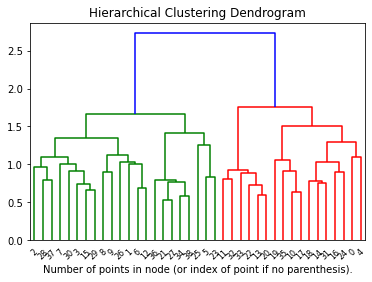

Sent is ['Treatment with drugs that may prolong QT in the last month before randomization for more than 7 days including: azithromycin, chlorpromazine, cisapride, clarithromycin, domperidone, droperidol, erythromycin, halofantrine, haloperidol, lumefantrine, mefloquine, methadone, pentamidine, procainamide, quinidine, quinine, sotalol, sparfloxacin, thioridazine, amiodarone. Treatment with fluvoxamine. Treatment with benzodiazepines or benzodiazepine analogues such as zolpidem, zopiclone or zaleplon', "com.ua, for passing of testing and/or to receive equal counseling on PrEP, at Alliance.Global's testing points. All confirmed HIV-positive MSM have been provided a social support to receive ART; for HIV-negative MSM, we proposed to become a member of the free PrEP program. Outcomes/Results Thanks to advertising on two web resources, during September-December 2020, 841 MSM registered for HIV/HCV/STI testing through the GetTest website and 80% of them were tested (the number of HIV-positiv

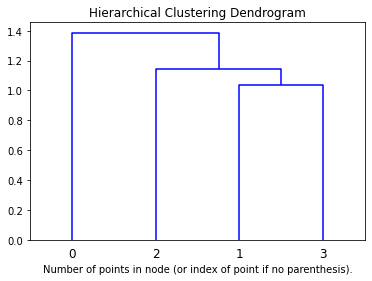

Sent is ['Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions', 'Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing', 'Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence', 'Whilst it is vital that eGFR testing is not missed, over-testing wastes clinical and finan

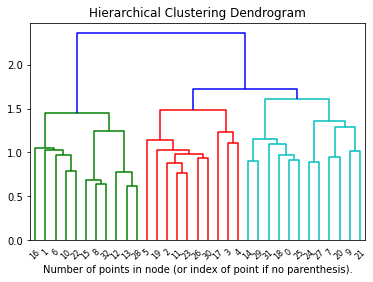

Sent is ['PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity', 'Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consumption (23.1%), problems with sleep (67.3%) and mental health (78.4%). Further, disruptions in access to Pre-Exposure Prophylaxis or PrEP–a daily pill to prevent HIV–occurred (33.3% of 18 p

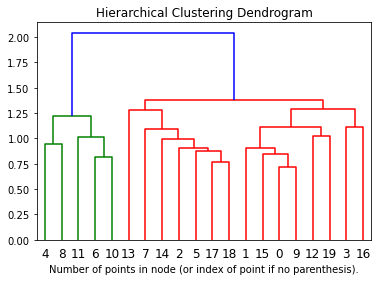

Sent is ['Data were collected via telephone calls for in-depth interviews or Zoom for FGDs and manually analysed by inductive content analysis. Setting Fourteen private security companies in two Uganda districts', 'In April 2020, 847 HIVnegative and untested participants completed questionnaires assessing changes in PrEP use as a result of COVID-19 public health measures. Binary logistic multiple regression was used to estimate adjusted odds ratios (aOR) and 95% confidence intervals (95% CI) to compare changes in PrEP use behaviors. Results: Among 847 men, mean age was 44.1 years (SD: 12.7)', "Patients that should not be included in the study at the judgment of the research team. Participants will be recruited from the following eight hospitals in Madrid, Spain: Hospital Universitario La Paz, Hospital Ramón y Cajal, Hospital Infanta Sofía, Hospital 12 de Octubre, Hospital Clínico San Carlos, Hospital Central de la defensa Gómez Ulla,Hospital de La Princesa and Hospital Infanta Leonor. 

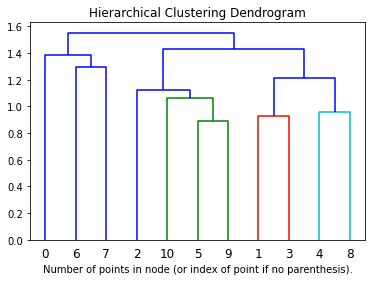

Sent is ["Active hepatitis B infection. Renal failure (CrCl < 60 mL/min/1.73 m2) or need for hemodialysis. Osteoporosis. Myasthenia gravis. Pre-existent maculopathy. Retinitis pigmentosa. Bradycardia (less than 50 bpm). Hereditary intolerance to galactose, Lapp lactase deficiency or glucose or galactose malabsorption. Pregnancy. Breastfeeding. History of potentially immune derived diseases such as: lupus, Crohn's disease, ulcerative colitis, vasculitis or rheumatoid arthritis. Insulin-dependent diabetes mellitus. Known history of hypersensitivity to the study drug or any of its components", 'We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and experiences with quarantine; 2) Health and healthcare access; 3) Employment and economic impact of COVID-19', 'To understand the acceptability of PrEP teleconsultation and HIV self-testing, we conducted a 

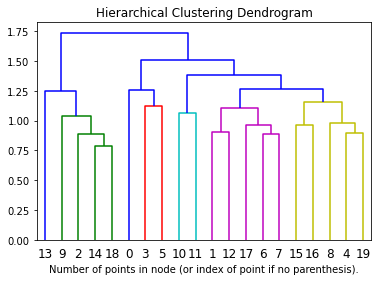

Sent is ['We present a healthy 29-year-old man who developed a leucocytoclastic vasculitis for COVID-19 with positive SARS-CoV-2 PCR in skin biopsy', "Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'", 'Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before randomization. Premenopausal women must have a negative urina

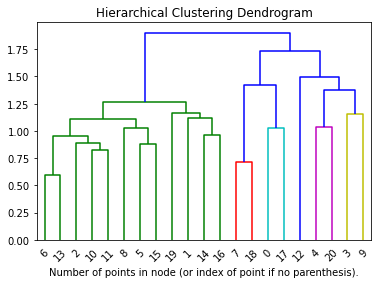

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 17
{}
WordCloud for chunks according to Tf-Idf score:


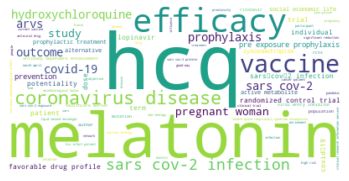


- More frequent chunks: hcq, melatonin, efficacy
WordCloud for chunks frequency in the cluster


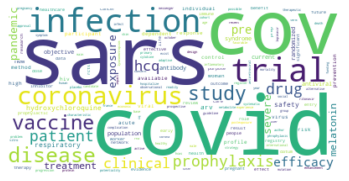


- More frequent words: sars, covid-19, cov-2

- Main topics in cluster:


/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:707: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  tensor = as_tensor(value)
/usr/local/lib/python3.7/dist-packages/transformers/pipelines/question_answering.py:300: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  for span_id in range(num_spans)


SARS‐CoV‐2 infection
Similarity between keywords and proposed clusters: 0.37

Text 0: Main skin manifestations of COVID-19 have been recently classified. However, little is known about cutaneous histopathological patterns and the presence of SARS-CoV-2 in these skin lesions
Text 4: Objectives: Primary objective: to evaluate the efficacy of melatonin as a prophylactic treatment on prevention of symptomatic SARS-CoV-2 infection among healthcare workers at high risk of SARS-CoV-2 exposure. Secondary objectives: To evaluate the efficacy of melatonin as a prophylactic treatment on prevention of asymptomatic SARS-CoV-2 infection. To evaluate the efficacy of melatonin to prevent the development of severe COVID-19 in the participants enrolled in this study who develop SARS-CoV-2 infection along the trial. To evaluate the duration of COVID-19 symptoms in participants receiving melatonin before the infection. To evaluate seroconversion timing post-symptom onset. Exploratory objectives: To compar

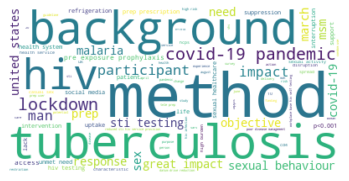


- More frequent chunks: method, tuberculosis, background
WordCloud for chunks frequency in the cluster


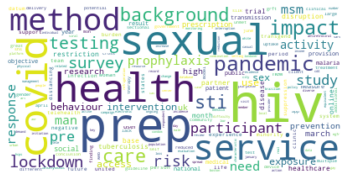


- More frequent words: hiv, prep, sexual

- Main topics in cluster:
management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 1: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initia

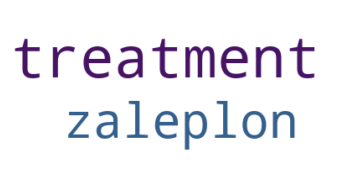


- More frequent chunks: treatment, zaleplon, azithromycin chlorpromazine cisapride clarithromycin domperidone droperidol erythromycin halofantrine haloperidol lumefantrine mefloquine methadone pentamidine procainamide quinidine quinine sotalol sparfloxacin thioridazine amiodarone
WordCloud for chunks frequency in the cluster


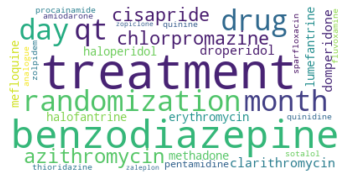


- More frequent words: treatment, benzodiazepine, drug

- Main topics in cluster:
azithromycin, chlorpromazine
Similarity between keywords and proposed clusters: 0.09

Text 0: Treatment with drugs that may prolong QT in the last month before randomization for more than 7 days including: azithromycin, chlorpromazine, cisapride, clarithromycin, domperidone, droperidol, erythromycin, halofantrine, haloperidol, lumefantrine, mefloquine, methadone, pentamidine, procainamide, quinidine, quinine, sotalol, sparfloxacin, thioridazine, amiodarone. Treatment with fluvoxamine. Treatment with benzodiazepines or benzodiazepine analogues such as zolpidem, zopiclone or zaleplon
***********************
*********************
Analysis of the label 'I'

- Number of elements per cluster n.1: 2
{}
WordCloud for chunks according to Tf-Idf score:


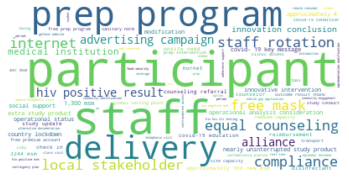


- More frequent chunks: participant, staff, prep program
WordCloud for chunks frequency in the cluster


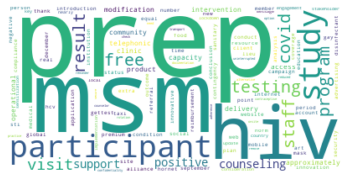


- More frequent words: prep, msm, hiv

- Main topics in cluster:
COVID- 19 key messages
Similarity between keywords and proposed clusters: 0.29

Text 1: com.ua, for passing of testing and/or to receive equal counseling on PrEP, at Alliance.Global's testing points. All confirmed HIV-positive MSM have been provided a social support to receive ART; for HIV-negative MSM, we proposed to become a member of the free PrEP program. Outcomes/Results Thanks to advertising on two web resources, during September-December 2020, 841 MSM registered for HIV/HCV/STI testing through the GetTest website and 80% of them were tested (the number of HIV-positive results was approximately 4%). 3244 MSM have learned about the PrEP program during this period, approximately 300 new MSM have been attracted to the PrEP program (the coverage of the PrEP intervention in 2020 amounted about 1,300 MSM). Innovations/Conclusions Thanks to the introduction of two advertising campaigns on the Internet, at the COVID-19 con

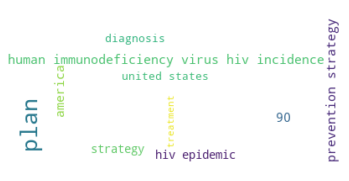


- More frequent chunks: plan, human immunodeficiency virus hiv incidence, america
WordCloud for chunks frequency in the cluster


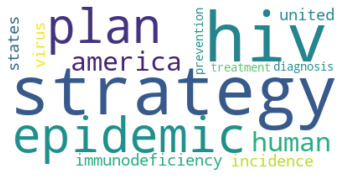


- More frequent words: strategy, hiv, epidemic

- Main topics in cluster:
diagnosis, treatment, and prevention strategies
Similarity between keywords and proposed clusters: 0.27

Text 2: A strategy titled “Ending the HIV Epidemic: A Plan for America” aims to reduce human immunodeficiency virus (HIV) incidence in the United States by at least 90% by 2030, using diagnosis, treatment, and prevention strategies
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 12
{}
WordCloud for chunks according to Tf-Idf score:


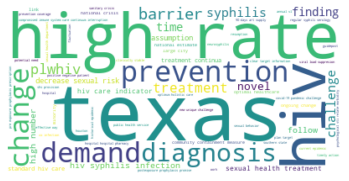


- More frequent chunks: texas, high rate, hiv
WordCloud for chunks frequency in the cluster


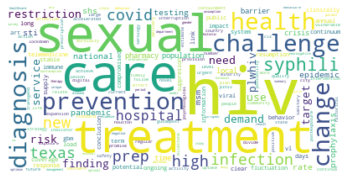


- More frequent words: hiv, sexual, care

- Main topics in cluster:
New models for testing and prevention
Similarity between keywords and proposed clusters: 0.38

Text 0: Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions
Text 7: The use of telemedicine, annual VL for those clinically stables, and 90-days ART supply held link to public health services and viral load suppresion. Conclusion: PLWHIV are vulnerable during COVID-19 pandemic due to compromised immune system or care continuum interruption by community containment measures. Monitoring of HIV care indicators associated to timely actions is an effective way to overcome COVID-19 pandemic challenges and guarantee prope

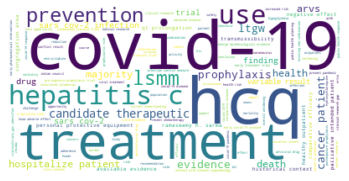


- More frequent chunks: covid-19, hcq, treatment
WordCloud for chunks frequency in the cluster


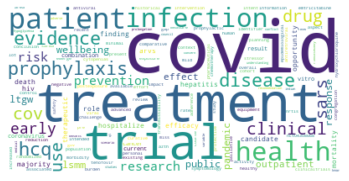


- More frequent words: covid-19, treatment, trial

- Main topics in cluster:
N-95, personal protective equipment, and adherence to infection control measures
Similarity between keywords and proposed clusters: 0.43

Text 1: Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing
Text 6: Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial
Text 8: The negative effects are more pronounced in hospitalized patients. Therefore, with the available evidence, HCQ should not be used in prophylaxis or treatment of patients with COVID-19
Text 10: Focus on

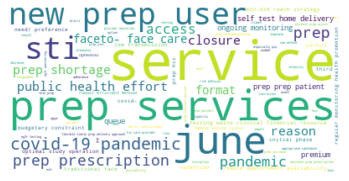


- More frequent chunks: service, prep services, june
WordCloud for chunks frequency in the cluster


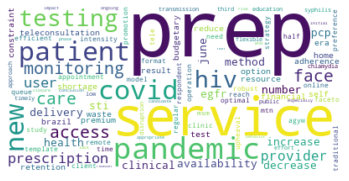


- More frequent words: prep, service, pandemic

- Main topics in cluster:
PrEP teleconsultation and PrEP/HIV self-testing
Similarity between keywords and proposed clusters: 0.32

Text 2: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
Text 3: Whilst it is vital that eGFR testing is not missed, over-testing wastes clinical and financial resources which are at a premium in an era of budgetary constraints and reduced appointment availability due to COVID- 19. As the number of clients taking PrEP increases, it is important for all services to ensure robust and efficient methods of eGFR monitoring.
Text 4: and mandatory pre-registration (to avoid queues), we were able to successfully saved services, and increase the intensity of testing and staging to PrEP for MSM compared to the first ha

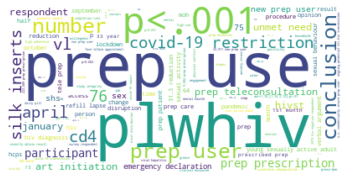


- More frequent chunks: prep use, plwhiv, p<.001
WordCloud for chunks frequency in the cluster


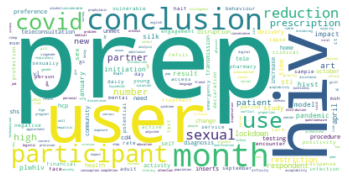


- More frequent words: prep, hiv, user

- Main topics in cluster:
young, sexually active adults
Similarity between keywords and proposed clusters: 0.41

Text 0: PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity
Text 1: Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consumption (23.1%), problems with sl

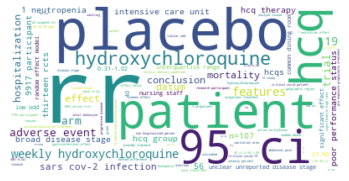


- More frequent chunks: rr, placebo, patient
WordCloud for chunks frequency in the cluster


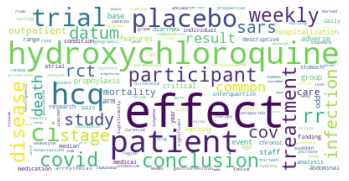


- More frequent words: effect, hydroxychloroquine, patient

- Main topics in cluster:
serious side effects were rare
Similarity between keywords and proposed clusters: 0.1

Text 4: We report descriptive analyses of our findings. Results: We enrolled 2795 participants. The median age of research participants (interquartile range) was 40 (34-49) years, and 59% (1633/2767) reported no chronic medical conditions. Overall 2544 (91%) participants reported side effect data, and 748 (29%) reported at least 1 medication side effect. Side effects were reported in 40% with once-daily, 36% with twice-weekly, 31% with once-weekly hydroxychloroquine, compared with 19% with placebo. The most common side effects were upset stomach or nausea (25% with once-daily, 19% with twice-weekly, and 18% with once-weekly hydroxychloroquine, vs 11% for placebo), followed by diarrhea, vomiting, or abdominal pain (23% for once-daily, 17% twice-weekly, and 13% once-weekly hydroxychloroquine, vs 7% for placebo). Two 

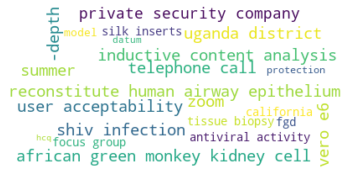


- More frequent chunks: reconstitute human airway epithelium, uganda district, inductive content analysis
WordCloud for chunks frequency in the cluster


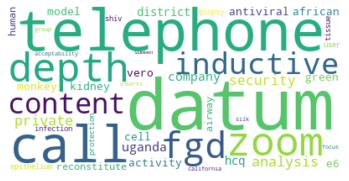


- More frequent words: datum, telephone, call

- Main topics in cluster:
Fourteen private security companies in two Uganda districts
Similarity between keywords and proposed clusters: 0.22

Text 0: Data were collected via telephone calls for in-depth interviews or Zoom for FGDs and manually analysed by inductive content analysis. Setting Fourteen private security companies in two Uganda districts
Text 6: HCQ showed antiviral activity in African green monkey kidney cells (Vero E6) but not in a model of reconstituted human airway epithelium
Text 7: Tissue biopsies were obtained and tested for protection against SHIV infection. To determine the user acceptability of silk inserts, we held four focus groups in California during summer 2020
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.1: 8
{}
WordCloud for chunks according to Tf-Idf score:


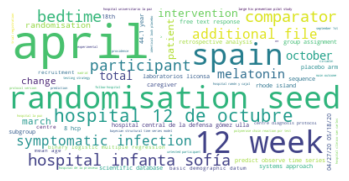


- More frequent chunks: april, randomisation seed, 12 week
WordCloud for chunks frequency in the cluster


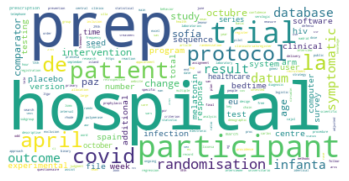


- More frequent words: hospital, prep, participant

- Main topics in cluster:
according to each centre diagnosis protocol
Similarity between keywords and proposed clusters: 0.33

Text 1: In April 2020, 847 HIVnegative and untested participants completed questionnaires assessing changes in PrEP use as a result of COVID-19 public health measures. Binary logistic multiple regression was used to estimate adjusted odds ratios (aOR) and 95% confidence intervals (95% CI) to compare changes in PrEP use behaviors. Results: Among 847 men, mean age was 44.1 years (SD: 12.7)
Text 2: Patients that should not be included in the study at the judgment of the research team. Participants will be recruited from the following eight hospitals in Madrid, Spain: Hospital Universitario La Paz, Hospital Ramón y Cajal, Hospital Infanta Sofía, Hospital 12 de Octubre, Hospital Clínico San Carlos, Hospital Central de la defensa Gómez Ulla,Hospital de La Princesa and Hospital Infanta Leonor. Intervention and compa

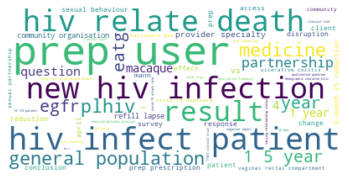


- More frequent chunks: prep user, hiv infect patient, new hiv infection
WordCloud for chunks frequency in the cluster


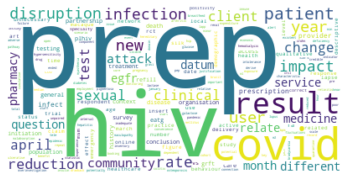


- More frequent words: prep, hiv, result

- Main topics in cluster:
quantitative and qualitative questions in English
Similarity between keywords and proposed clusters: 0.41

Text 0: Active hepatitis B infection. Renal failure (CrCl < 60 mL/min/1.73 m2) or need for hemodialysis. Osteoporosis. Myasthenia gravis. Pre-existent maculopathy. Retinitis pigmentosa. Bradycardia (less than 50 bpm). Hereditary intolerance to galactose, Lapp lactase deficiency or glucose or galactose malabsorption. Pregnancy. Breastfeeding. History of potentially immune derived diseases such as: lupus, Crohn's disease, ulcerative colitis, vasculitis or rheumatoid arthritis. Insulin-dependent diabetes mellitus. Known history of hypersensitivity to the study drug or any of its components
Text 1: We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and experiences with quarantin

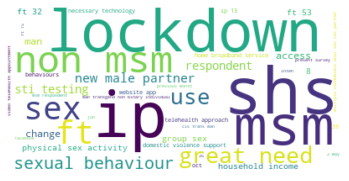


- More frequent chunks: shs, ip, lockdown
WordCloud for chunks frequency in the cluster


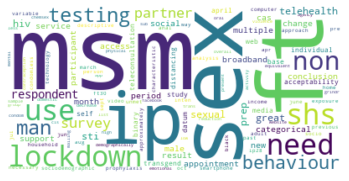


- More frequent words: msm, sex, ft

- Main topics in cluster:
PrEP teleconsultation and HIV self-testing
Similarity between keywords and proposed clusters: 0.16

Text 2: To understand the acceptability of PrEP teleconsultation and HIV self-testing, we conducted a web-based study during social distancing period (April–May, 2020) among men who have sex with men and transgender/non-binary individuals using social media
Text 9: Data on sociodemographic characteristics, sexual behaviour and related mental well-being experienced during lockdown (defined as 23 March-30 June 2020) were extracted. Categorical and non-categorical variables were compared according to HIV pre-exposure prophylaxis (PrEP) use
Text 13: Descriptive analysis shows that Blacks were 15% and those who identify as heterosexual were 24% more likely to have failed telehealth appointments (FT). FT decreased as in-person (IP) appointments increased. Apr (FT 48% v. IP 5%) May (FT 53% v. IP 4%); Jun (FT 32% v. IP 7%); Jul (FT3

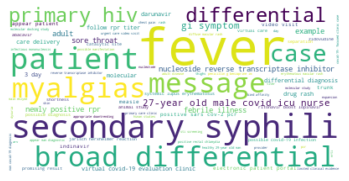


- More frequent chunks: fever, secondary syphili, patient
WordCloud for chunks frequency in the cluster


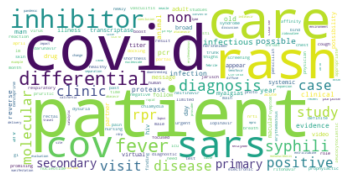


- More frequent words: patient, covid-19, care

- Main topics in cluster:
molecular docking studies
Similarity between keywords and proposed clusters: 0.4

Text 0: We present a healthy 29-year-old man who developed a leucocytoclastic vasculitis for COVID-19 with positive SARS-CoV-2 PCR in skin biopsy
Text 7: Apart from molecular docking studies, in vitro, animal, and human studies are very limited for evaluating the prophylactic role of ARVs against severe acute respiratory syndrome-corona virus 2 (SARS-CoV-2) infection. According to our findings, there is no definite evidence to support use of protease inhibitors for this purpose, despite the promising results of molecular studies and limited clinical evidence for ritonavir-boosted lopinavir, darunavir, and nelfinavir when used early in the course of the disease. Nucleotide/nucleoside reverse-transcriptase inhibitors (NRTI) also have shown binding affinity to main enzymes of SARS-CoV-2 in molecular, in vitro, and animal studies
Text 

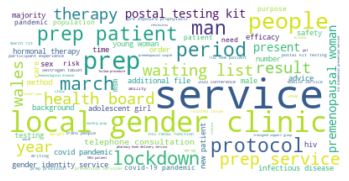


- More frequent chunks: service, local gender clinic, prep
WordCloud for chunks frequency in the cluster


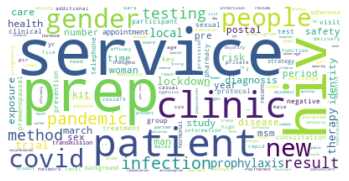


- More frequent words: service, prep, hiv

- Main topics in cluster:
challenges in accessing HIV treatment and care, and prevention services
Similarity between keywords and proposed clusters: 0.29

Text 1: Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'
Text 2: Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before 

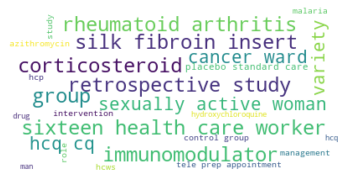


- More frequent chunks: sixteen health care worker, immunomodulator, rheumatoid arthritis
WordCloud for chunks frequency in the cluster


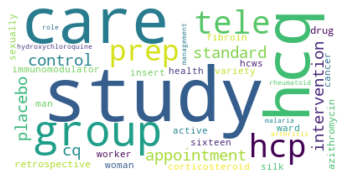


- More frequent words: study, hcq, care

- Main topics in cluster:
studies evaluating HCQ/CQ alone as intervention and placebo/standard care
Similarity between keywords and proposed clusters: 0.18

Text 3: All HCPs conducting tele-PrEP appointments were invited to participate
Text 4: We included studies evaluating HCQ/CQ alone as intervention and placebo/standard care as a control group. Retrospective studies and studies using other drugs (namely azithromycin, corticosteroids, immunomodulators, etc.. we excluded
Text 9: Sixteen health-care workers (HCWs) were working in the cancer ward (paramedical staff: 4, nurses: 6, residents: 4, and consultants: 2)
Text 12: These groups were composed of sexually active women and men, both straight and gay, who were shown a variety of silk fibroin inserts
Text 20: Hydroxychloroquine (HCQ), a 4-aminoquinoline, is used worldwide mainly for its role in management of malaria and rheumatoid arthritis
***********************
defaultdict(<class 'list'>, {

In [ ]:
clustering_manager = ClusteringManager()
clustering_manager.set_report_folder(out_report_folder)

pico_labels = ['A','P', 'I', 'O', 'M', 'R', 'C']

step1 = clustering_manager.execute(labels_index, PICO_label=pico_labels,operation_number=1, keyword = ['Covid-19'], original_file=xlsx_sample) 
print(step1)

Step2: Qualora si volessero esplorare i singoli elementi all'interno della gerarchia in maniera più approfondita, è possibile aggiungere elementi al primo report o crearne uno nuovo. Mentre nel primo caso non necessitano modifiche, nel secondo caso è necessario indicare un nuovo indicatore numerico alla voce 'operation_number' (ad esempio, operation_number = 2 -> generazione report 'Graph_report2.csv').  
In entrambe le casistiche bisogna scegliere quali etichette analizzare in maniera più approfondita alla voce 'PICO_label'. 

In questo specifico esempio, ho scelto di esplorare più nel dettaglio gli elementi del secondo cluster rilevato nel passaggio precedente (step1) per la label 'A' (Treeshold for clustering: 1.14 - 22 frasi in totale). La mia scelta implica l'aggiunta di 3 nuove righe al report iniziale ('Graph_report1.csv') che analizzano i cluster formati da 14, 3 e 5 elementi rispettivamente.

E' possibile scegliere quale cluster analizzare più nel dettaglio tra quelli generati nel primo step alla voce 'cluster_number' (cluster_number = 0 -> primo cluster 'A' di step1, cluster_number = 1 -> secondo cluster 'A' di step1 ). 


Sent is ["Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initiate pre-exposure prophylaxis. The key study team reflections focused on the management of the clinical trial, effects of the local regulations and government policies and the need to adhere to ethical principles of r

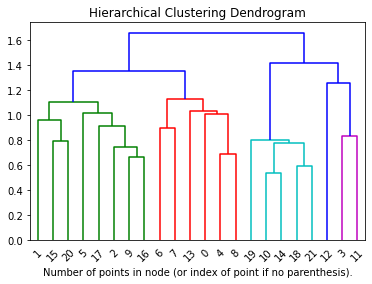

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 14
{}
WordCloud for chunks according to Tf-Idf score:


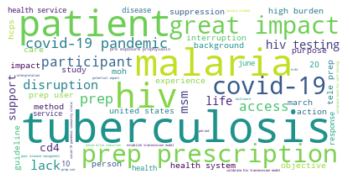


- More frequent chunks: tuberculosis, malaria, patient
WordCloud for chunks frequency in the cluster


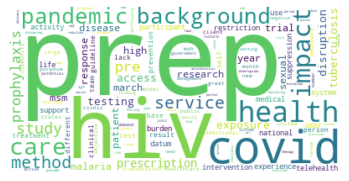


- More frequent words: prep, hiv, covid-19

- Main topics in cluster:


/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:707: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  tensor = as_tensor(value)
/usr/local/lib/python3.7/dist-packages/transformers/pipelines/question_answering.py:300: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  for span_id in range(num_spans)


management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 0: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initiate pre-exposure prophylaxis. The key study team reflections focused o

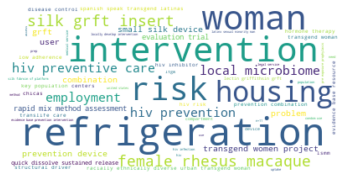


- More frequent chunks: refrigeration, woman, intervention
WordCloud for chunks frequency in the cluster


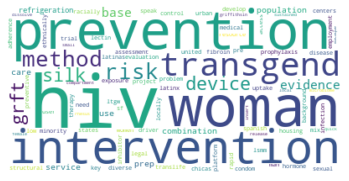


- More frequent words: hiv, woman, prevention

- Main topics in cluster:
TransLife Care
Similarity between keywords and proposed clusters: 0.2

Text 3: We conducted a rapid, mixed-methods assessment to understand how COVID-19 affected Latinx sexual minority men (LSMM) and transgender women (LTGW)
Text 11: In the United States, transgender women are disproportionately affected by HIV. However, few evidence-based prevention interventions exist for this key population. We describe two promising, locally developed interventions that are currently being implemented and evaluated through the Centers for Disease Control and Prevention Combination HIV Prevention for Transgender Women Project: (a) ChiCAS, designed to promote the uptake of pre-exposure prophylaxis (PrEP), condom use, and medically supervised hormone therapy among Spanish-speaking transgender Latinas, and (b) TransLife Care, designed to address the structural drivers of HIV risk through access to housing, employment, legal servi

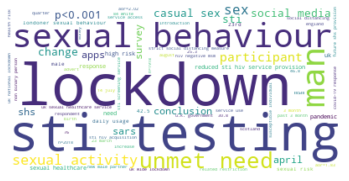


- More frequent chunks: lockdown, sti testing, sexual behaviour
WordCloud for chunks frequency in the cluster


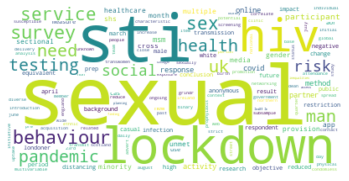


- More frequent words: sexual, sti, lockdown

- Main topics in cluster:
The COVID-19 pandemic and its related restrictions
Similarity between keywords and proposed clusters: 0.36

Text 10: Objectives: The COVID-19 pandemic and its related restrictions have affected attendance to and delivery of UK sexual healthcare services (SHS). We surveyed the impact on sexual behaviour of men having sex with men (MSM) to inform future SHS provision. Methods: We conducted a cross-sectional, anonymous, web-based survey among HIV-negative MSM at high risk of HIV infection who attended 56 Dean Street, a sexual health and HIV clinic. The survey was conducted over a 7-day period in August 2020
Text 14: Background The introduction of social distancing in response to the COVID-19 pandemic led to reduced STI/HIV service provision in the UK. We investigated sexual risk behaviours among MSM and unmet need for sexual healthcare during the pandemic. Methods A cross-sectional online survey (N=2,018) fielded via

In [ ]:
#a second phase is foreseen with at least 3 elements per cluster
step2 = clustering_manager.execute(step1,PICO_label=['A'],operation_number=1, cluster_number=1, keyword = ['Covid-19'],original_file='sample.xlsx')
print(step2) #22 [14+3+5]

Text dict size: 7
Sent is ['Main skin manifestations of COVID-19 have been recently classified. However, little is known about cutaneous histopathological patterns and the presence of SARS-CoV-2 in these skin lesions', "Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initiate pr

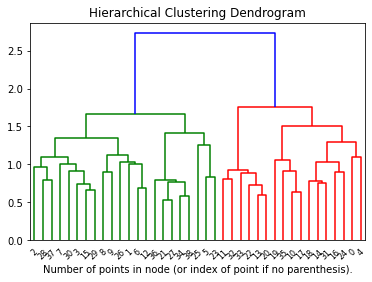

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 11
WordCloud for chunks according to Tf-Idf score:


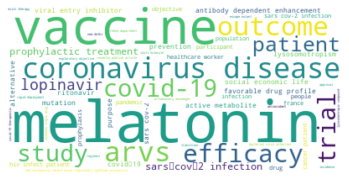


- More frequent chunks: melatonin, vaccine, coronavirus disease
WordCloud for chunks frequency in the cluster


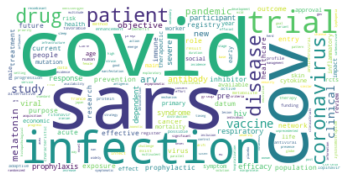


- More frequent words: covid-19, sars, cov-2

- Main topics in cluster:
lysosomotropism
Similarity between keywords and proposed clusters: 0.37

Text 0: Main skin manifestations of COVID-19 have been recently classified. However, little is known about cutaneous histopathological patterns and the presence of SARS-CoV-2 in these skin lesions
Text 4: Objectives: Primary objective: to evaluate the efficacy of melatonin as a prophylactic treatment on prevention of symptomatic SARS-CoV-2 infection among healthcare workers at high risk of SARS-CoV-2 exposure. Secondary objectives: To evaluate the efficacy of melatonin as a prophylactic treatment on prevention of asymptomatic SARS-CoV-2 infection. To evaluate the efficacy of melatonin to prevent the development of severe COVID-19 in the participants enrolled in this study who develop SARS-CoV-2 infection along the trial. To evaluate the duration of COVID-19 symptoms in participants receiving melatonin before the infection. To evaluate serocon

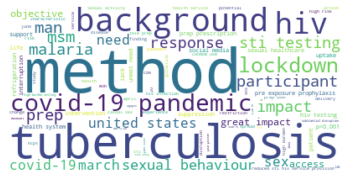


- More frequent chunks: method, tuberculosis, background
WordCloud for chunks frequency in the cluster


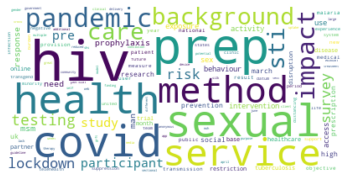


- More frequent words: hiv, prep, sexual

- Main topics in cluster:
management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 1: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initia

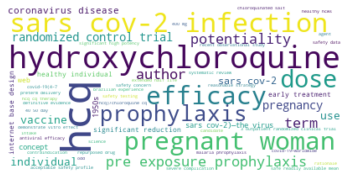


- More frequent chunks: hcq, hydroxychloroquine, sars cov-2 infection
WordCloud for chunks frequency in the cluster


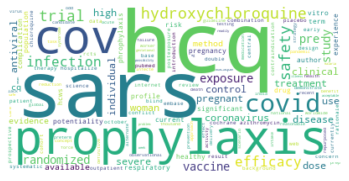


- More frequent words: hcq, sars, prophylaxis

- Main topics in cluster:
safety profile of HCQ in healthy individuals
Similarity between keywords and proposed clusters: 0.41

Text 11: Background: Use of hydroxychloroquine in hospitalized patients with coronavirus disease 2019 (COVID-19), especially in combination with azithromycin, has raised safety concerns. Here, we report safety data from 3 outpatient randomized clinical trials. Methods: We conducted 3 randomized, double-blind, placebo-controlled trials investigating hydroxychloroquine as pre-exposure prophylaxis, postexposure prophylaxis, and early treatment for COVID-19 using an internet-based design. We excluded individuals with contraindications to hydroxychloroquine
Text 13: Introduction: Hydroxychloroquine (HCQ)/Chloroquine (CQ) has been evaluated for treatment and prophylaxis against SARS-CoV-2 infection in various studies with conflicting results. We performed a systematic review to synthesize the currently available eviden

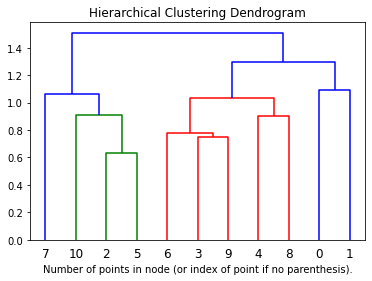

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


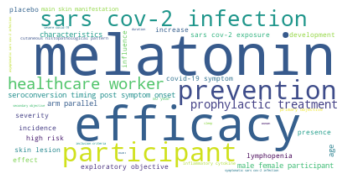


- More frequent chunks: melatonin, efficacy, participant
WordCloud for chunks frequency in the cluster


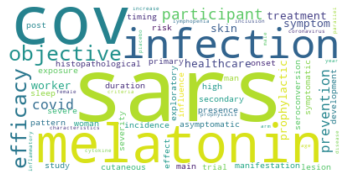


- More frequent words: sars, cov-2, melatonin

- Main topics in cluster:
little is known about cutaneous histopathological patterns
Similarity between keywords and proposed clusters: 0.37

Text 0: Main skin manifestations of COVID-19 have been recently classified. However, little is known about cutaneous histopathological patterns and the presence of SARS-CoV-2 in these skin lesions
Text 1: Objectives: Primary objective: to evaluate the efficacy of melatonin as a prophylactic treatment on prevention of symptomatic SARS-CoV-2 infection among healthcare workers at high risk of SARS-CoV-2 exposure. Secondary objectives: To evaluate the efficacy of melatonin as a prophylactic treatment on prevention of asymptomatic SARS-CoV-2 infection. To evaluate the efficacy of melatonin to prevent the development of severe COVID-19 in the participants enrolled in this study who develop SARS-CoV-2 infection along the trial. To evaluate the duration of COVID-19 symptoms in participants receiving melaton

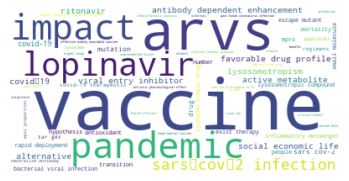


- More frequent chunks: vaccine, arvs, pandemic
WordCloud for chunks frequency in the cluster


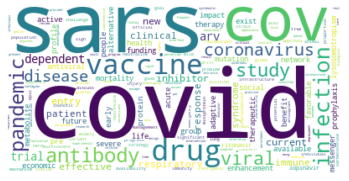


- More frequent words: drug, vaccine, covid-19

- Main topics in cluster:
Urgent studies to identify new antiviral drugs
Similarity between keywords and proposed clusters: 0.51

Text 2: The COVID-19 pandemic has put healthcare infrastructures and our social and economic lives under unprecedented strain. Effective solutions are needed to end the pandemic while significantly lessening its further impact on mortality and social and economic life. Effective and widely-available vaccines have appropriately long been seen as the best way to end the pandemic. Indeed, the current availability of several effective vaccines are already making a significant progress towards achieving that goal. Nevertheless, concerns have risen due to new SARS-CoV-2 variants that harbor mutations against which current vaccines are less effective. Furthermore, some individuals are unwilling or unable to take the vaccine. As health officials across the globe scramble to vaccinate their populations to reach herd im

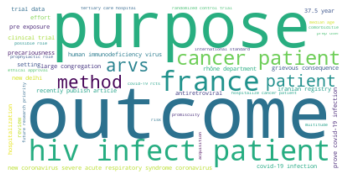


- More frequent chunks: outcome, purpose, hiv infect patient
WordCloud for chunks frequency in the cluster


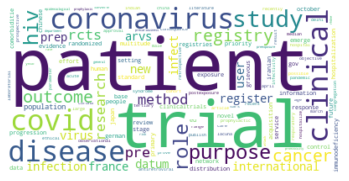


- More frequent words: patient, coronavirus, disease

- Main topics in cluster:
Infectivity and outcome among cancer patients staying in large congregations are not known
Similarity between keywords and proposed clusters: 0.47

Text 3: The role of HIV in coronavirus disease 2019 acquisition is not yet understood
Text 4: Purpose: A multitude of randomized controlled trials (RCTs) have emerged in response to the novel coronavirus disease (COVID-19) pandemic. Understanding the distribution of trials among various settings is important to guide future research priorities and efforts. The purpose of this review was to describe the emerging evidence base of COVID-19 RCTs by stages of disease progression, from pre-exposure to hospitalization. Methods: We collated trial data across international registries: ClinicalTrials.gov; International Standard Randomised Controlled Trial Number Registry; Chinese Clinical Trial Registry; Clinical Research Information Service; EU Clinical Trials Register;

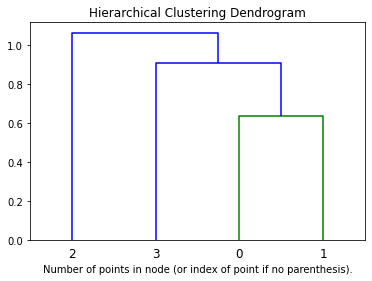

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


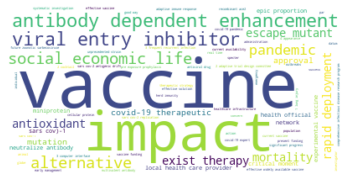


- More frequent chunks: vaccine, impact, antibody dependent enhancement
WordCloud for chunks frequency in the cluster


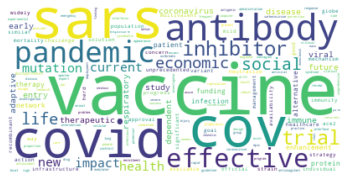


- More frequent words: vaccine, sars, covid-19

- Main topics in cluster:
anticoagulants, antioxidants, and immune modulators
Similarity between keywords and proposed clusters: 0.51

Text 0: The COVID-19 pandemic has put healthcare infrastructures and our social and economic lives under unprecedented strain. Effective solutions are needed to end the pandemic while significantly lessening its further impact on mortality and social and economic life. Effective and widely-available vaccines have appropriately long been seen as the best way to end the pandemic. Indeed, the current availability of several effective vaccines are already making a significant progress towards achieving that goal. Nevertheless, concerns have risen due to new SARS-CoV-2 variants that harbor mutations against which current vaccines are less effective. Furthermore, some individuals are unwilling or unable to take the vaccine. As health officials across the globe scramble to vaccinate their populations to reach he

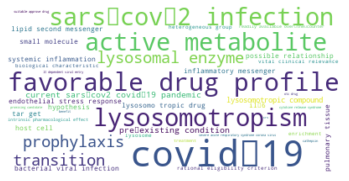


- More frequent chunks: covid‐19, favorable drug profile, active metabolite
WordCloud for chunks frequency in the cluster


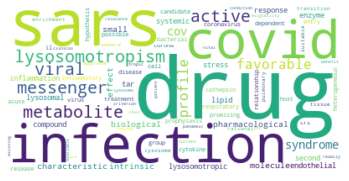


- More frequent words: drug, infection, covid‐19

- Main topics in cluster:
lysosomotropism
Similarity between keywords and proposed clusters: 0.25

Text 2: Lysosomotropism is a biological characteristic of small molecules, independently present of their intrinsic pharmacological effects. Lysosomotropic compounds, in general, affect various tar-gets, such as lipid second messengers originating from lysosomal enzymes promoting endothelial stress response in systemic inflammation; inflammatory messengers, such as IL‐6; and cathepsin L‐ dependent viral entry into host cells. This heterogeneous group of drugs and active metabolites comprise various promising candidates with more favorable drug profiles than initially considered (hydroxy) chloroquine in prophylaxis and treatment of severe acute respiratory syndrome corona-virus 2 (SARS‐CoV‐2) infections/Coronavirus disease 2019 (COVID‐19) and cytokine release syndrome (CRS) triggered by bacterial or viral infections. In this hypothesis, we

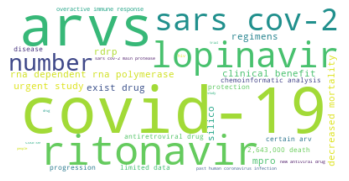


- More frequent chunks: covid-19, arvs, ritonavir
WordCloud for chunks frequency in the cluster


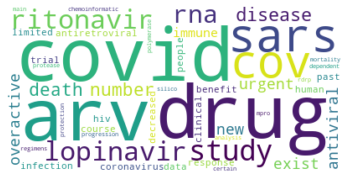


- More frequent words: covid-19, drug, sars

- Main topics in cluster:
Urgent studies to identify new antiviral drugs, repurpose existing drugs
Similarity between keywords and proposed clusters: 0.41

Text 3: COVID-19 is the disease caused by SARS-CoV-2 which has led to 2,643,000 deaths worldwide, a number which is rapidly increasing. Urgent studies to identify new antiviral drugs, repurpose existing drugs, or identify drugs that can target the overactive immune response are ongoing. Antiretroviral drugs (ARVs) have been tested in past human coronavirus infections, and also against SARS-CoV-2, but a trial of lopinavir and ritonavir failed to show any clinical benefit in COVID-19. However, there is limited data as to the course of COVID-19 in people living with HIV, with some studies showing a decreased mortality for those taking certain ARV regimens. We hypothesized that ARVs other than lopinavir and ritonavir might be responsible for some protection against the progression of COVID-1

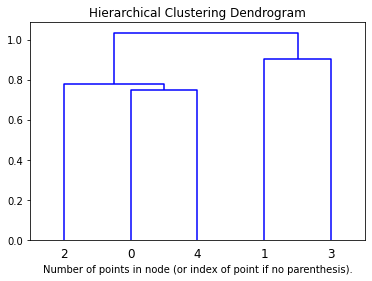

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


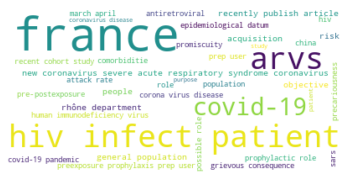


- More frequent chunks: france, hiv infect patient, arvs
WordCloud for chunks frequency in the cluster


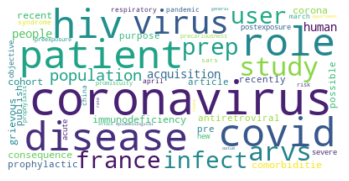


- More frequent words: coronavirus, role, hiv

- Main topics in cluster:
No epidemiological data are available in these two populations
Similarity between keywords and proposed clusters: 0.49

Text 0: The role of HIV in coronavirus disease 2019 acquisition is not yet understood
Text 2: Although people living with human immunodeficiency virus and other comorbidities are expected to experience more grievous consequences with corona virus disease 2019 (COVID-19), recent cohort studies did not indicate this. Antiretrovirals (ARVs) might have a prophylactic role in these patients. The purpose of this study was to review the most recently published articles on the possible role of ARVs for pre- or postexposure prophylaxis against COVID-19
Text 4: OBJECTIVE: A new coronavirus severe acute respiratory syndrome coronavirus 2 (SARS-Cov-2) emerged in China during late 2019 and resulted in the coronavirus disease 2019 (COVID-19) pandemic which peaked in France in March-April 2020. Immunodeficienc

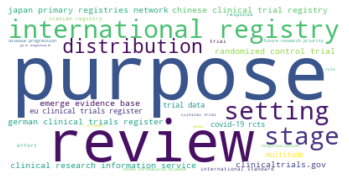


- More frequent chunks: purpose, review, international registry
WordCloud for chunks frequency in the cluster


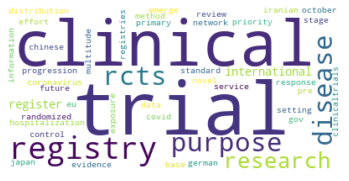


- More frequent words: trial, clinical, registry

- Main topics in cluster:
to describe the emerging evidence base of COVID-19 RCTs
Similarity between keywords and proposed clusters: 0.45

Text 1: Purpose: A multitude of randomized controlled trials (RCTs) have emerged in response to the novel coronavirus disease (COVID-19) pandemic. Understanding the distribution of trials among various settings is important to guide future research priorities and efforts. The purpose of this review was to describe the emerging evidence base of COVID-19 RCTs by stages of disease progression, from pre-exposure to hospitalization. Methods: We collated trial data across international registries: ClinicalTrials.gov; International Standard Randomised Controlled Trial Number Registry; Chinese Clinical Trial Registry; Clinical Research Information Service; EU Clinical Trials Register; Iranian Registry of Clinical Trials; Japan Primary Registries Network; German Clinical Trials Register (up to 7 October 2020

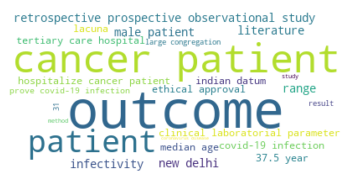


- More frequent chunks: outcome, cancer patient, patient
WordCloud for chunks frequency in the cluster


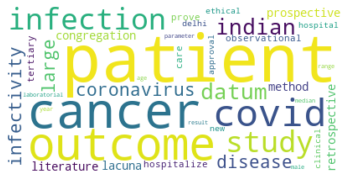


- More frequent words: patient, cancer, outcome

- Main topics in cluster:
Infectivity and outcome among cancer patients staying in large congregations are not known
Similarity between keywords and proposed clusters: 0.47

Text 3: Objective: Indian data on cancer patients with coronavirus disease 2019 (COVID-19) infection and its outcome are limited. Infectivity and outcome among cancer patients staying in large congregations are not known. We conducted this study to address this lacuna in literature. Methods: This was a retrospective-prospective, observational study of hospitalized cancer patients with proven COVID-19 infection, conducted at tertiary care hospital in New Delhi after ethical approval. We analyzed clinical, laboratorial parameters, and outcomes in these patients. Results: All 32 admitted male patients became COVID-19 positive and 10 (31%) patients were symptomatic. Median age was 37.5 years (range: 16-64)
***********************
Sent is ['The role of HIV in coronavirus

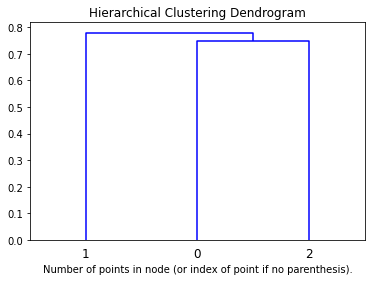

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


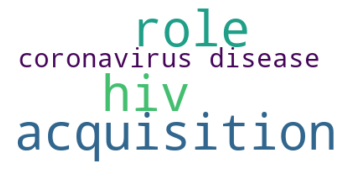


- More frequent chunks: hiv, acquisition, role
WordCloud for chunks frequency in the cluster


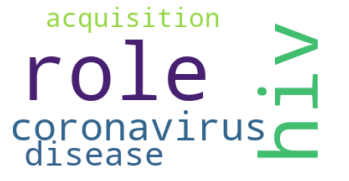


- More frequent words: role, hiv, coronavirus

- Main topics in cluster:
coronavirus disease 2019 acquisition is not yet understood
Similarity between keywords and proposed clusters: 0.46

Text 0: The role of HIV in coronavirus disease 2019 acquisition is not yet understood
***********************
*********************
Analysis of the label 'A'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


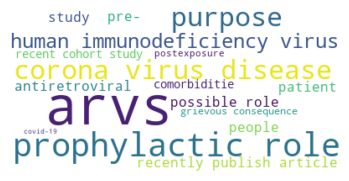


- More frequent chunks: arvs, prophylactic role, corona virus disease
WordCloud for chunks frequency in the cluster


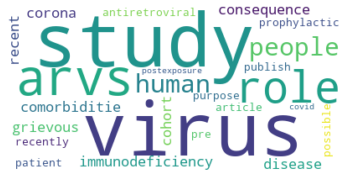


- More frequent words: virus, study, arvs

- Main topics in cluster:
ARVs for pre- or postexposure prophylaxis
Similarity between keywords and proposed clusters: 0.51

Text 1: Although people living with human immunodeficiency virus and other comorbidities are expected to experience more grievous consequences with corona virus disease 2019 (COVID-19), recent cohort studies did not indicate this. Antiretrovirals (ARVs) might have a prophylactic role in these patients. The purpose of this study was to review the most recently published articles on the possible role of ARVs for pre- or postexposure prophylaxis against COVID-19
***********************
*********************
Analysis of the label 'A'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


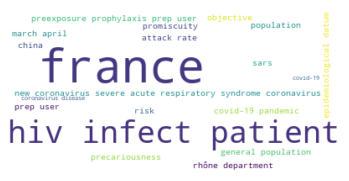


- More frequent chunks: france, hiv infect patient, new coronavirus severe acute respiratory syndrome coronavirus
WordCloud for chunks frequency in the cluster


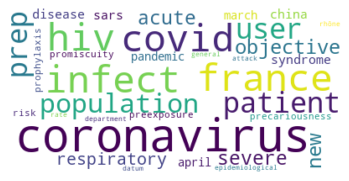


- More frequent words: coronavirus, covid-19, france

- Main topics in cluster:
Immunodeficiency, precariousness and promiscuity
Similarity between keywords and proposed clusters: 0.52

Text 2: OBJECTIVE: A new coronavirus severe acute respiratory syndrome coronavirus 2 (SARS-Cov-2) emerged in China during late 2019 and resulted in the coronavirus disease 2019 (COVID-19) pandemic which peaked in France in March-April 2020. Immunodeficiency, precariousness and promiscuity could increase the risk of COVID-19 in HIV-infected patients and in preexposure prophylaxis (PrEP) users. No epidemiological data are available in these two populations. We report COVID-19 attack rate in HIV-infected patients and in PrEP users in the Rhône department, France, and compared it with the general population
***********************
Sent is ['The role of HIV in coronavirus disease 2019 acquisition is not yet understood']
Hierarchical Clustering dendrogram for label A
Sent is ['Although people living with hum

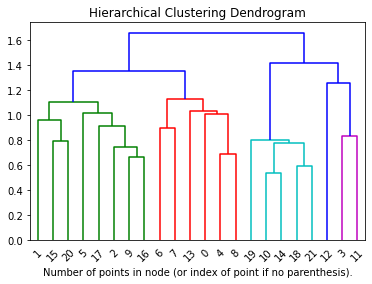

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 14
WordCloud for chunks according to Tf-Idf score:


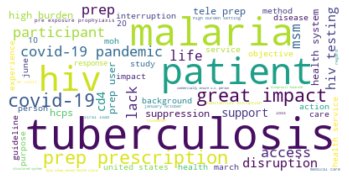


- More frequent chunks: tuberculosis, malaria, patient
WordCloud for chunks frequency in the cluster


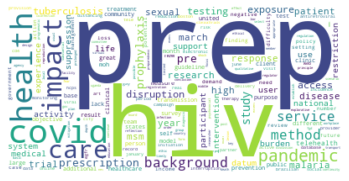


- More frequent words: prep, hiv, covid-19

- Main topics in cluster:
management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 0: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to init

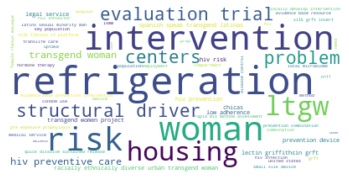


- More frequent chunks: refrigeration, woman, intervention
WordCloud for chunks frequency in the cluster


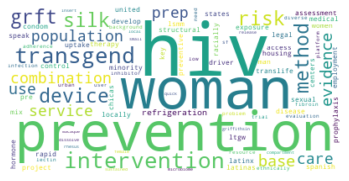


- More frequent words: hiv, woman, prevention

- Main topics in cluster:
TransLife Care
Similarity between keywords and proposed clusters: 0.2

Text 3: We conducted a rapid, mixed-methods assessment to understand how COVID-19 affected Latinx sexual minority men (LSMM) and transgender women (LTGW)
Text 11: In the United States, transgender women are disproportionately affected by HIV. However, few evidence-based prevention interventions exist for this key population. We describe two promising, locally developed interventions that are currently being implemented and evaluated through the Centers for Disease Control and Prevention Combination HIV Prevention for Transgender Women Project: (a) ChiCAS, designed to promote the uptake of pre-exposure prophylaxis (PrEP), condom use, and medically supervised hormone therapy among Spanish-speaking transgender Latinas, and (b) TransLife Care, designed to address the structural drivers of HIV risk through access to housing, employment, legal servi

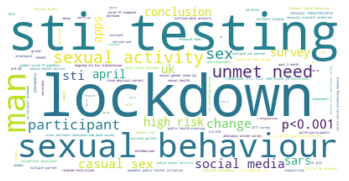


- More frequent chunks: lockdown, sti testing, sexual behaviour
WordCloud for chunks frequency in the cluster


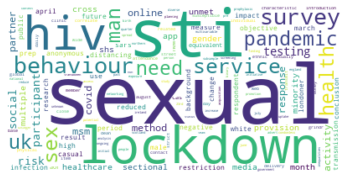


- More frequent words: sexual, sti, lockdown

- Main topics in cluster:
The COVID-19 pandemic and its related restrictions
Similarity between keywords and proposed clusters: 0.36

Text 10: Objectives: The COVID-19 pandemic and its related restrictions have affected attendance to and delivery of UK sexual healthcare services (SHS). We surveyed the impact on sexual behaviour of men having sex with men (MSM) to inform future SHS provision. Methods: We conducted a cross-sectional, anonymous, web-based survey among HIV-negative MSM at high risk of HIV infection who attended 56 Dean Street, a sexual health and HIV clinic. The survey was conducted over a 7-day period in August 2020
Text 14: Background The introduction of social distancing in response to the COVID-19 pandemic led to reduced STI/HIV service provision in the UK. We investigated sexual risk behaviours among MSM and unmet need for sexual healthcare during the pandemic. Methods A cross-sectional online survey (N=2,018) fielded via

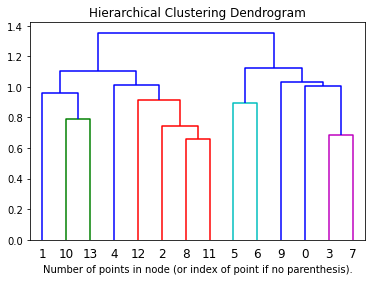

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 4
WordCloud for chunks according to Tf-Idf score:


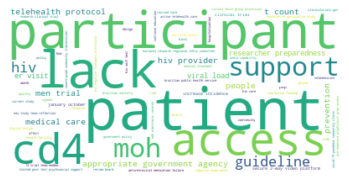


- More frequent chunks: patient, participant, lack
WordCloud for chunks frequency in the cluster


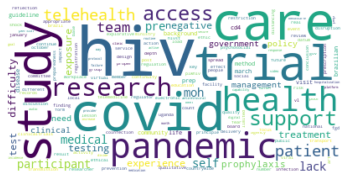


- More frequent words: hiv, covid-19, care

- Main topics in cluster:
management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 0: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to init

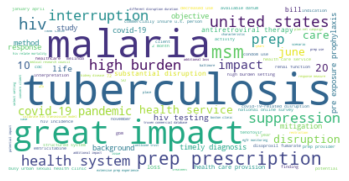


- More frequent chunks: tuberculosis, malaria, great impact
WordCloud for chunks frequency in the cluster


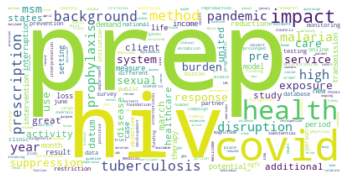


- More frequent words: prep, hiv, health

- Main topics in cluster:
HIV, tuberculosis, and malaria
Similarity between keywords and proposed clusters: 0.51

Text 1: Background: COVID-19 has the potential to cause substantial disruptions to health services, due to cases overburdening the health system or response measures limiting usual programmatic activities. We aimed to quantify the extent to which disruptions to services for HIV, tuberculosis, and malaria in low-income and middle-income countries with high burdens of these diseases could lead to additional loss of life over the next 5 years. Methods: Assuming a basic reproduction number of 3·0, we constructed four scenarios for possible responses to the COVID-19 pandemic: no action, mitigation for 6 months, suppression for 2 months, or suppression for 1 year. We used established transmission models of HIV, tuberculosis, and malaria to estimate the additional impact on health that could be caused in selected settings, either due to C

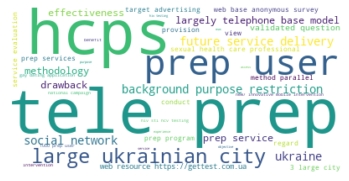


- More frequent chunks: tele prep, hcps, prep user
WordCloud for chunks frequency in the cluster


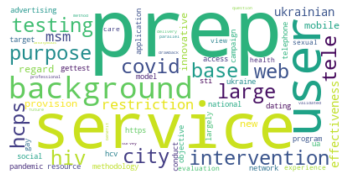


- More frequent words: prep, service, user

- Main topics in cluster:
HIV/STI/HCV testing
Similarity between keywords and proposed clusters: 0.29

Text 5: Background/Purpose Restrictions of COVID-19 pandemic have made it more difficult to provide HIV testing and PrEP services to MSM in large Ukrainian cities. The purpose of the intervention is to maintain the effectiveness of the provision of these services during COVID-19 and to implement new/ innovative and more mobile interventions in this regard. Approach The methodology consists of conducting two national campaigns aimed at MSM recruiting in 3 largest cities of Ukraine, for conducting of HIV/STI/HCV testing, as well as to attract to the PrEP program, through targeted advertising on gay dating applications and social networks for directing to web-resources https://gettest.com.ua and https://prep
Text 6: Background To maintain access to PrEP during the COVID-19 pandemic our PrEP service (1000 PrEP-users) shifted to a largely teleph

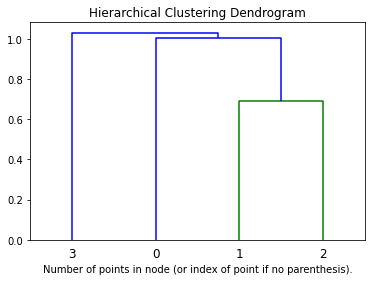

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


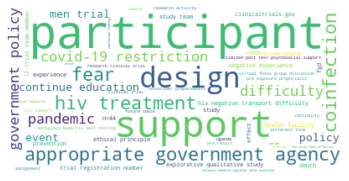


- More frequent chunks: participant, support, design
WordCloud for chunks frequency in the cluster


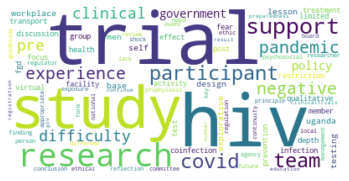


- More frequent words: hiv, trial, study

- Main topics in cluster:
management of the clinical trial, effects of the local regulations and government policies
Similarity between keywords and proposed clusters: 0.31

Text 0: Objective To explore the experiences and lessons learnt by the study team and participants of the Workplace-based HIV self-testing among Men trial during the COVID-19 pandemic in Uganda. Design An explorative qualitative study comprising two virtual focus group discussions (FGDs) with 12 trial team members and 32 in-depth participant interviews (N=44). The effects on HIV treatment and prevention resulted from; repercussions of the COVID-19 restrictions, participants fear of coinfection and negative experiences at health facilities. The difficulty in participating in research activities arose from: fear of infection with COVID-19 for the participants who tested HIV negative, transport difficulties, limited post-test psychosocial support and lack of support to initia

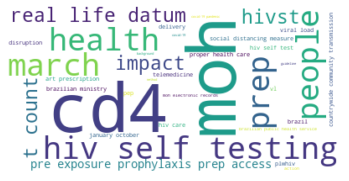


- More frequent chunks: cd4, moh, hiv self testing
WordCloud for chunks frequency in the cluster


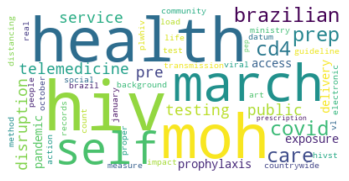


- More frequent words: hiv, health, moh

- Main topics in cluster:
guidelines on social distancing measures
Similarity between keywords and proposed clusters: 0.43

Text 1: In March 2020, telemedicine and HIV self-testing were adopted by Brazilian Public Health services to minimize disruptions in pre-exposure prophylaxis (PrEP) access and delivery during the COVID-19 pandemic
Text 2: Background: In March 2020, the Brazilian Ministry of Health (MoH) announced COVID-19 countrywide community transmission and issued guidelines on social distancing measures. Using real life data, we aimed to analyze the impact of COVID-19 on HIV care in Brazil, and summarize the actions taken by the MoH to guarantee proper health care for people living with HIV (PLWHIV). Methods: We obtained MoH electronic records, from January-October 2019/2020, on HIV self test (HIVST), viral load (VL), CD4+ T counts (CD4), genotyping, and antiretroviral (ART) prescription, including post- (PEP) and pre-exposure (PrEP) p

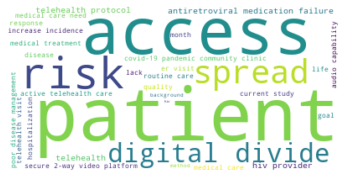


- More frequent chunks: patient, access, risk
WordCloud for chunks frequency in the cluster


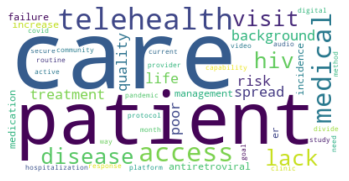


- More frequent words: care, patient, telehealth

- Main topics in cluster:
Access to medical treatment and care for those living with or at risk for HIV
Similarity between keywords and proposed clusters: 0.22

Text 3: Background: Access to medical treatment and care for those living with or at risk for HIV is vital to ensuring quality of life and limiting the spread of the disease. Lack of access to medical care is associated with poor disease management, antiretroviral medication failure, and increased incidence of ER visits and/or hospitalizations. To address the medical care needs of patients living with HIV providers have adapted to telehealth protocols that have allowed them to examine, assess and treat patients using secure 2-way video platforms with audio capabilities. While telehealth has been successfully implemented for patients in routine care, lack of access due to the digital divide has not been closely examined. The goal of the current study was to characterize the resp

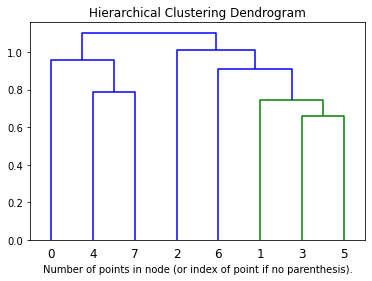

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


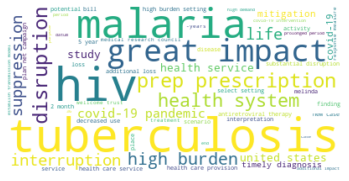


- More frequent chunks: tuberculosis, hiv, malaria
WordCloud for chunks frequency in the cluster


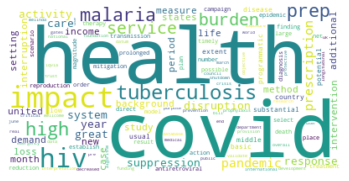


- More frequent words: health, covid-19, impact

- Main topics in cluster:
HIV, tuberculosis, and malaria
Similarity between keywords and proposed clusters: 0.51

Text 0: Background: COVID-19 has the potential to cause substantial disruptions to health services, due to cases overburdening the health system or response measures limiting usual programmatic activities. We aimed to quantify the extent to which disruptions to services for HIV, tuberculosis, and malaria in low-income and middle-income countries with high burdens of these diseases could lead to additional loss of life over the next 5 years. Methods: Assuming a basic reproduction number of 3·0, we constructed four scenarios for possible responses to the COVID-19 pandemic: no action, mitigation for 6 months, suppression for 2 months, or suppression for 1 year. We used established transmission models of HIV, tuberculosis, and malaria to estimate the additional impact on health that could be caused in selected settings, either d

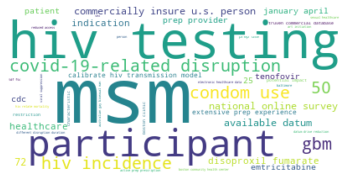


- More frequent chunks: msm, hiv testing, participant
WordCloud for chunks frequency in the cluster


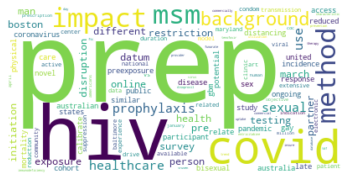


- More frequent words: prep, hiv, impact

- Main topics in cluster:
public health and physical distancing restrictions
Similarity between keywords and proposed clusters: 0.38

Text 1: Background: In response to the novel coronavirus disease (COVID-19) pandemic, Australia introduced public health and physical distancing restrictions in late March 2020. We investigated the impact of these restrictions on HIV preexposure prophylaxis (PrEP) use among Australian gay and bisexual men (GBM). Methods: Participants in an ongoing online cohort study previously reported PrEP use from 2014 to 2019
Text 3: Background: During the COVID-19 pandemic, gay, bisexual and other men who have sex with men (MSM) in the United States (US) have reported similar or fewer sexual partners and reduced access to HIV testing and care. Pre-exposure prophylaxis (PrEP) use has declined. We estimated the potential impact of COVID-19 on HIV incidence and HIV-related mortality among US MSM. Methods: We used a calibrated 

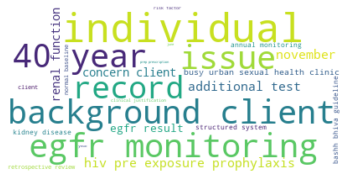


- More frequent chunks: individual, background client, issue
WordCloud for chunks frequency in the cluster


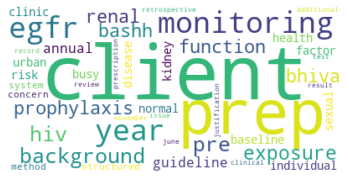


- More frequent words: client, prep, monitoring

- Main topics in cluster:
BASHH/BHIVA guidelines
Similarity between keywords and proposed clusters: 0.15

Text 2: Background Clients receiving PrEP (HIV Pre-Exposure Prophylaxis) require renal function (estimated Glomerular Filtration Rate (eGFR)) monitoring as detailed in BASHH/BHIVA guidelines. Annual monitoring is required for individuals < 40 with normal baseline eGFR and no risk factors for kidney disease. Our busy urban sexual health clinic lacked a structured system for eGFR monitoring, with concern clients were being tested unnecessarily or not at all. Method A retrospective review was conducted of all clients under 40 years who received PrEP between June and November 2020. eGFR results and additional tests performed without clinical justification were extracted from records in the year preceding the issue of each PrEP prescription
***********************
Sent is ['Background: COVID-19 has the potential to cause substantial disr

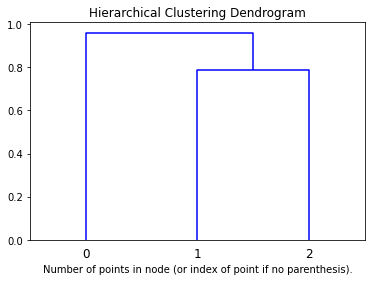

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


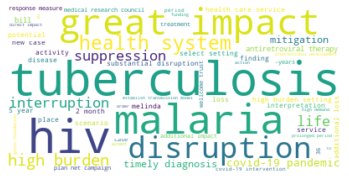


- More frequent chunks: tuberculosis, hiv, malaria
WordCloud for chunks frequency in the cluster


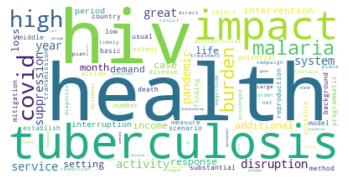


- More frequent words: health, hiv, tuberculosis

- Main topics in cluster:
HIV, tuberculosis, and malaria
Similarity between keywords and proposed clusters: 0.51

Text 0: Background: COVID-19 has the potential to cause substantial disruptions to health services, due to cases overburdening the health system or response measures limiting usual programmatic activities. We aimed to quantify the extent to which disruptions to services for HIV, tuberculosis, and malaria in low-income and middle-income countries with high burdens of these diseases could lead to additional loss of life over the next 5 years. Methods: Assuming a basic reproduction number of 3·0, we constructed four scenarios for possible responses to the COVID-19 pandemic: no action, mitigation for 6 months, suppression for 2 months, or suppression for 1 year. We used established transmission models of HIV, tuberculosis, and malaria to estimate the additional impact on health that could be caused in selected settings, either 

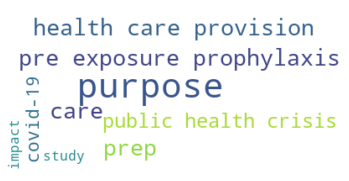


- More frequent chunks: purpose, pre exposure prophylaxis, health care provision
WordCloud for chunks frequency in the cluster


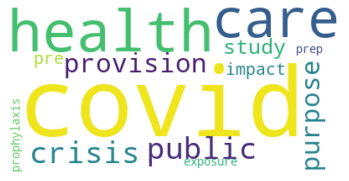


- More frequent words: covid-19, health, care

- Main topics in cluster:
pre-exposure prophylaxis (PrEP) care
Similarity between keywords and proposed clusters: 0.56

Text 1: COVID-19 is a public health crisis that has fundamentally altered health care provision. The purpose of this study was to examine the impact of COVID-19 on pre-exposure prophylaxis (PrEP) care
***********************
*********************
Analysis of the label 'A'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


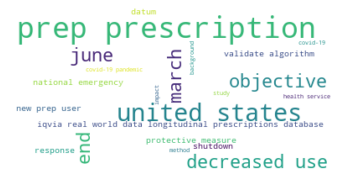


- More frequent chunks: prep prescription, united states, decreased use
WordCloud for chunks frequency in the cluster


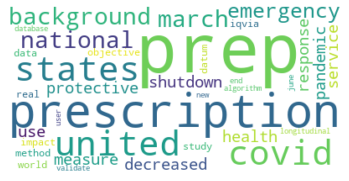


- More frequent words: prep, prescription, covid-19

- Main topics in cluster:
COVID-19 pandemic
Similarity between keywords and proposed clusters: 0.47

Text 2: Background: On March 13, 2020 a national emergency was declared and protective measures were implemented in response to the COVID-19 pandemic. PrEP prescriptions had increased in the United States since 2014, but shutdown because of COVID-19 resulted in decreased use of health services. The objective of this study was to evaluate the impact of the COVID-19 on PrEP prescriptions in the United States. Methods: We analyzed data from the IQVIA Real World Data-Longitudinal Prescriptions Database from 2017 to the end of June 2020. Using a validated algorithm, we identified PrEP prescriptions and new PrEP users
***********************
Sent is ['Background: COVID-19 has the potential to cause substantial disruptions to health services, due to cases overburdening the health system or response measures limiting usual programmatic activ

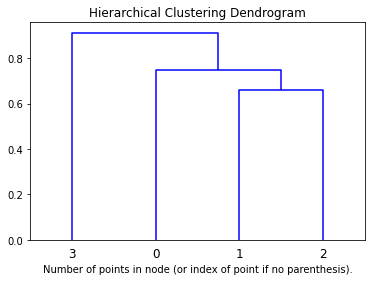

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


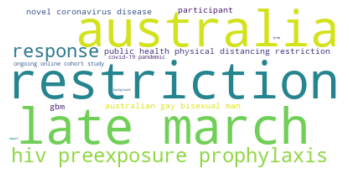


- More frequent chunks: restriction, late march, australia
WordCloud for chunks frequency in the cluster


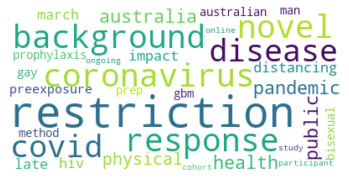


- More frequent words: restriction, background, response

- Main topics in cluster:
public health and physical distancing restrictions
Similarity between keywords and proposed clusters: 0.36

Text 0: Background: In response to the novel coronavirus disease (COVID-19) pandemic, Australia introduced public health and physical distancing restrictions in late March 2020. We investigated the impact of these restrictions on HIV preexposure prophylaxis (PrEP) use among Australian gay and bisexual men (GBM). Methods: Participants in an ongoing online cohort study previously reported PrEP use from 2014 to 2019
***********************
*********************
Analysis of the label 'A'

- Number of elements per cluster n.1: 2
WordCloud for chunks according to Tf-Idf score:


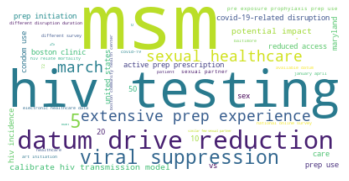


- More frequent chunks: msm, hiv testing, datum drive reduction
WordCloud for chunks frequency in the cluster


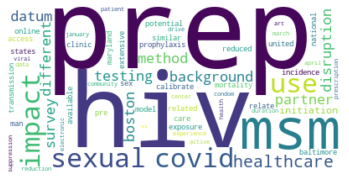


- More frequent words: prep, hiv, msm

- Main topics in cluster:
HIV incidence and HIV-related mortality
Similarity between keywords and proposed clusters: 0.43

Text 1: Background: During the COVID-19 pandemic, gay, bisexual and other men who have sex with men (MSM) in the United States (US) have reported similar or fewer sexual partners and reduced access to HIV testing and care. Pre-exposure prophylaxis (PrEP) use has declined. We estimated the potential impact of COVID-19 on HIV incidence and HIV-related mortality among US MSM. Methods: We used a calibrated HIV transmission model for MSM in Baltimore, Maryland, and available data on COVID-19-related disruptions (from national online surveys of US MSM and from a Boston clinic with extensive PrEP experience) to predict impacts of data-driven reductions in sexual partners (0% or 25% - based on different surveys), condom use (5%), HIV testing (20%), viral suppression (VS; 10%), PrEP initiations (72%), PrEP use (9%) and ART initiations

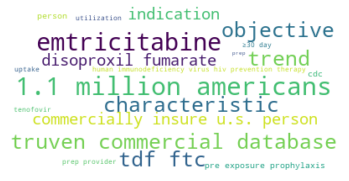


- More frequent chunks: 1.1 million americans, emtricitabine, truven commercial database
WordCloud for chunks frequency in the cluster


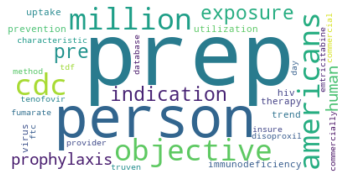


- More frequent words: prep, person, objective

- Main topics in cluster:
trends in the utilization of PrEP and the characteristics of PrEP providers
Similarity between keywords and proposed clusters: 0.26

Text 3: Objectives: The CDC estimated that 1.1 million Americans have an indication for pre-exposure prophylaxis (PrEP), human immunodeficiency virus (HIV) prevention therapy, but uptake is low. We examined trends in the utilization of PrEP and the characteristics of PrEP providers among commercially-insured U.S. persons. Methods: We identified persons treated with ≥30 days of tenofovir disoproxil fumarate and emtricitabine (TDF/FTC) in the Truven Commercial Database (2011-2018)
***********************
Sent is ['Background: In response to the novel coronavirus disease (COVID-19) pandemic, Australia introduced public health and physical distancing restrictions in late March 2020. We investigated the impact of these restrictions on HIV preexposure prophylaxis (PrEP) use among Austral

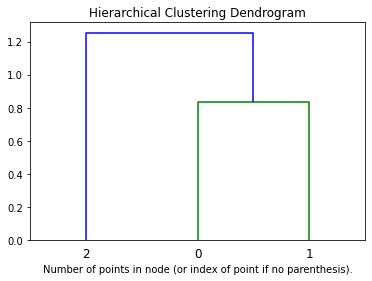

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


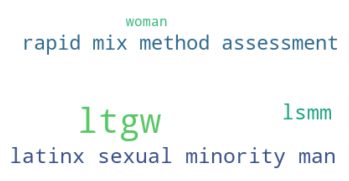


- More frequent chunks: ltgw, latinx sexual minority man, lsmm
WordCloud for chunks frequency in the cluster


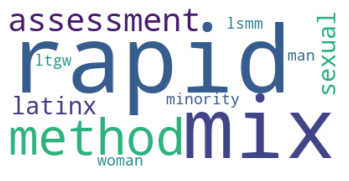


- More frequent words: rapid, mix, method

- Main topics in cluster:
Latinx sexual minority men (LSMM) and transgender women
Similarity between keywords and proposed clusters: 0.32

Text 0: We conducted a rapid, mixed-methods assessment to understand how COVID-19 affected Latinx sexual minority men (LSMM) and transgender women (LTGW)
***********************
*********************
Analysis of the label 'A'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


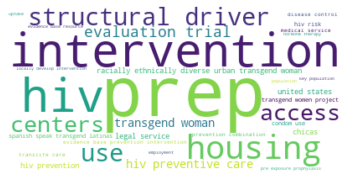


- More frequent chunks: prep, intervention, hiv
WordCloud for chunks frequency in the cluster


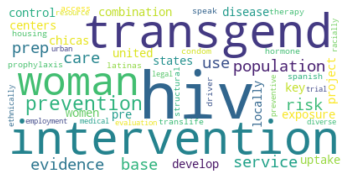


- More frequent words: hiv, intervention, transgend

- Main topics in cluster:
two promising, locally developed interventions
Similarity between keywords and proposed clusters: 0.17

Text 1: In the United States, transgender women are disproportionately affected by HIV. However, few evidence-based prevention interventions exist for this key population. We describe two promising, locally developed interventions that are currently being implemented and evaluated through the Centers for Disease Control and Prevention Combination HIV Prevention for Transgender Women Project: (a) ChiCAS, designed to promote the uptake of pre-exposure prophylaxis (PrEP), condom use, and medically supervised hormone therapy among Spanish-speaking transgender Latinas, and (b) TransLife Care, designed to address the structural drivers of HIV risk through access to housing, employment, legal services, and medical services, including HIV preventive care (e.g., PrEP use) among racially/ethnically diverse urban tr

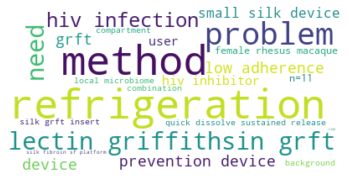


- More frequent chunks: refrigeration, method, problem
WordCloud for chunks frequency in the cluster


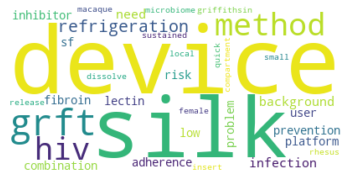


- More frequent words: device, silk, grft

- Main topics in cluster:
methods to prevent HIV infection
Similarity between keywords and proposed clusters: 0.17

Text 2: Background: While there are methods to prevent HIV infection, there is still a need for a prevention device that is effective, user-controlled, easily transported without refrigeration, inexpensive and discreet. Importantly, such a device should be attractive to the user to avoid the problem of low adherence, particularly among at-risk youth. We have developed the silk fibroin (SF) platform to encapsulate and release a single or combination of HIV inhibitors, including the lectin Griffithsin (Grft), that does not need refrigeration. These small silk devices can be inserted vaginally and rectally, and be formulated either for quick-dissolve or sustained release. Methods: We have used silk-Grft inserts in female rhesus macaques (n=11), placing them vaginally and rectally. These compartments were swabbed to test for amount 

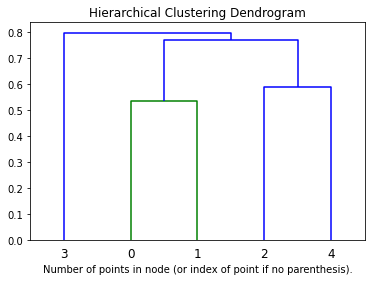

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


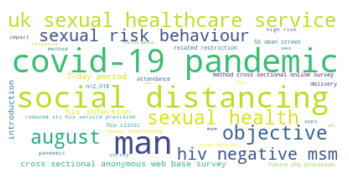


- More frequent chunks: covid-19 pandemic, man, social distancing
WordCloud for chunks frequency in the cluster


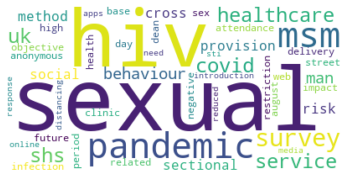


- More frequent words: sexual, hiv, pandemic

- Main topics in cluster:
sexual risk behaviours among MSM and unmet need for sexual healthcare
Similarity between keywords and proposed clusters: 0.35

Text 0: Objectives: The COVID-19 pandemic and its related restrictions have affected attendance to and delivery of UK sexual healthcare services (SHS). We surveyed the impact on sexual behaviour of men having sex with men (MSM) to inform future SHS provision. Methods: We conducted a cross-sectional, anonymous, web-based survey among HIV-negative MSM at high risk of HIV infection who attended 56 Dean Street, a sexual health and HIV clinic. The survey was conducted over a 7-day period in August 2020
Text 1: Background The introduction of social distancing in response to the COVID-19 pandemic led to reduced STI/HIV service provision in the UK. We investigated sexual risk behaviours among MSM and unmet need for sexual healthcare during the pandemic. Methods A cross-sectional online survey (N=2

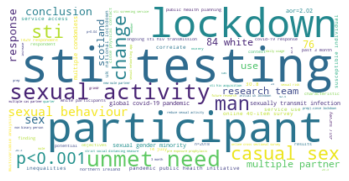


- More frequent chunks: sti testing, participant, lockdown
WordCloud for chunks frequency in the cluster


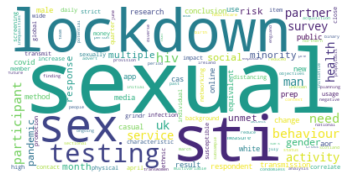


- More frequent words: sexual, sti, lockdown

- Main topics in cluster:
Sexual and gender minorities are at higher risk of sexually transmitted infections
Similarity between keywords and proposed clusters: 0.32

Text 2: Background: The global COVID-19 pandemic in 2020 resulted in strict social distancing measures restricting close physical contact. Sexual and gender minorities are at higher risk of sexually transmitted infections (STIs) and may have experienced changes in sexual behaviour during the lockdown. We aimed to examine the impact of the first UK-wide lockdown on sexual behaviours to identify the characteristics of the most susceptible individuals. Method: In April-May 2020, we conducted an online 40-item survey, which was promoted on social media and Grindr. We performed regression analyses to identify correlates of casual sex and changes in sexual behaviour during the lockdown. Results: 1429 respondents (mean age = 36, 84% White) completed the survey. During the lockdown, 7

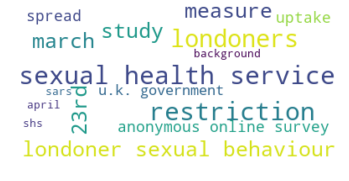


- More frequent chunks: sexual health service, restriction, londoners
WordCloud for chunks frequency in the cluster


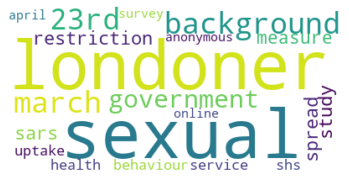


- More frequent words: sexual, background, 23rd

- Main topics in cluster:
Londoners' sexual behaviours or their uptake of sexual health services
Similarity between keywords and proposed clusters: 0.27

Text 3: Background: On 23rd March 2020 the U.K. government implemented restrictions to reduce the spread of SARS-CoV- 2. These were slowly lifted from 13th May 2020. This study was conducted to explore if these measures changed Londoners' sexual behaviours or their uptake of sexual health services (SHS). Method: An anonymous online survey was conducted during April 2020, targeting all Londoners aged 16 and over
***********************
Sent is ['Objectives: The COVID-19 pandemic and its related restrictions have affected attendance to and delivery of UK sexual healthcare services (SHS). We surveyed the impact on sexual behaviour of men having sex with men (MSM) to inform future SHS provision. Methods: We conducted a cross-sectional, anonymous, web-based survey among HIV-negative MSM at 

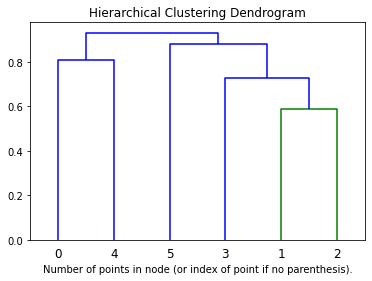

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


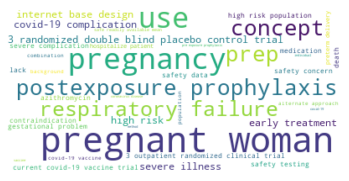


- More frequent chunks: pregnant woman, pregnancy, use
WordCloud for chunks frequency in the cluster


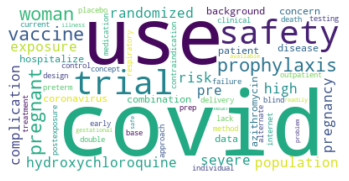


- More frequent words: covid-19, use, safety

- Main topics in cluster:
safety data from 3 outpatient randomized clinical trials
Similarity between keywords and proposed clusters: 0.37

Text 0: Background: Use of hydroxychloroquine in hospitalized patients with coronavirus disease 2019 (COVID-19), especially in combination with azithromycin, has raised safety concerns. Here, we report safety data from 3 outpatient randomized clinical trials. Methods: We conducted 3 randomized, double-blind, placebo-controlled trials investigating hydroxychloroquine as pre-exposure prophylaxis, postexposure prophylaxis, and early treatment for COVID-19 using an internet-based design. We excluded individuals with contraindications to hydroxychloroquine
Text 4: Pregnant women are at higher risk for developing severe complications of COVID-19 including preterm delivery, respiratory failure, and death. Although vaccines to prevent COVID-19 are being developed, pregnant women are not included in the current

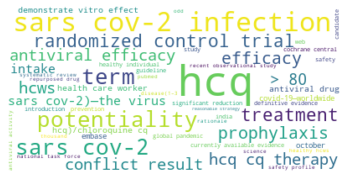


- More frequent chunks: hcq, sars cov-2 infection, sars cov-2
WordCloud for chunks frequency in the cluster


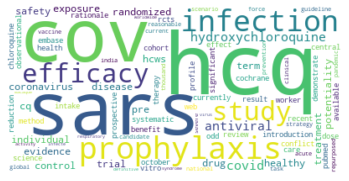


- More frequent words: hcq, sars, cov-2

- Main topics in cluster:
various studies with conflicting results
Similarity between keywords and proposed clusters: 0.28

Text 1: Introduction: Hydroxychloroquine (HCQ)/Chloroquine (CQ) has been evaluated for treatment and prophylaxis against SARS-CoV-2 infection in various studies with conflicting results. We performed a systematic review to synthesize the currently available evidence over the efficacy and safety of HCQ/CQ therapy alone against SARS-CoV-2 infection. Methods: We searched Embase, PubMed, Web of Science, and Cochrane central for randomized controlled trials (RCTs) and prospective cohort studies published until October 15, 2020 and assessing the efficacy of HCQ alone against SARS-CoV-2 infection
Text 2: The potentiality of Hydroxychloroquine (HCQ) for pre-exposure prophylaxis against SARS-CoV-2 has not been explored in randomized controlled trials. However, there is rationale behind this potentiality in terms of demonstrated in-

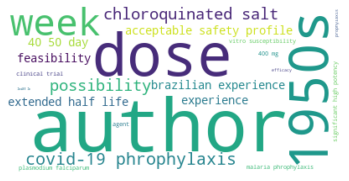


- More frequent chunks: author, dose, 1950s
WordCloud for chunks frequency in the cluster


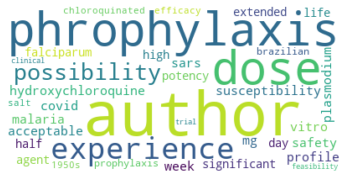


- More frequent words: author, phrophylaxis, dose

- Main topics in cluster:
We also cite Brazilian experience with Chloroquinated Salt
Similarity between keywords and proposed clusters: 0.36

Text 5: The authors speculate about the possibility of Hydroxychloroquine as Covid-19 Phrophylaxis in the dose of 400 mg per week. The authors compared the experience of Malaria phrophylaxis in this dose, with acceptable safety profile. Also, we compared in vitro susceptibility of SARS-Cov-2 with that of Plasmodium falciparum. This agent show significant higher potency for the first. Also, the extended Half-life (40-50 days) make it an acceptable choice for prophylaxis. We also cite Brazilian experience with Chloroquinated Salt in the 1950s, its efficacy and feasibility. Lastly, we suggest that clinical trials should be conducted test this hypothesis
***********************
Sent is ['Background: Use of hydroxychloroquine in hospitalized patients with coronavirus disease 2019 (COVID-19), especial

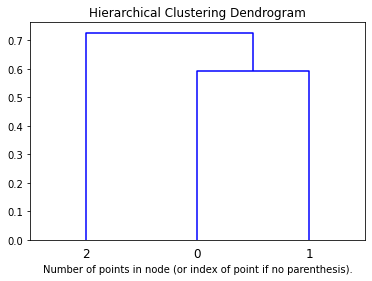

*********************
Analysis of the label 'A'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:
Sent is ['The authors speculate about the possibility of Hydroxychloroquine as Covid-19 Phrophylaxis in the dose of 400 mg per week. The authors compared the experience of Malaria phrophylaxis in this dose, with acceptable safety profile. Also, we compared in vitro susceptibility of SARS-Cov-2 with that of Plasmodium falciparum. This agent show significant higher potency for the first. Also, the extended Half-life (40-50 days) make it an acceptable choice for prophylaxis. We also cite Brazilian experience with Chloroquinated Salt in the 1950s, its efficacy and feasibility. Lastly, we suggest that clinical trials should be conducted test this hypothesis']
Hierarchical Clustering dendrogram for label A
Sent is ['We present a healthy 29-year-old man who developed a leucocytoclastic vasculitis for COVID-19 with positive SARS-CoV-2 PCR in skin biopsy', "Pa

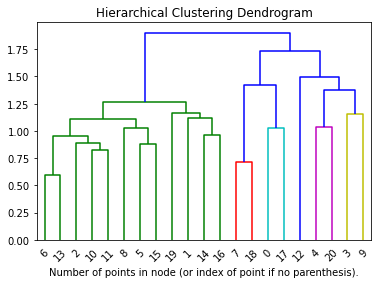

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 4
WordCloud for chunks according to Tf-Idf score:


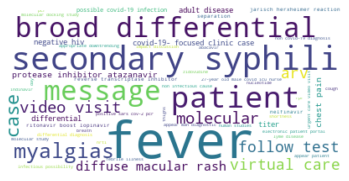


- More frequent chunks: fever, secondary syphili, patient
WordCloud for chunks frequency in the cluster


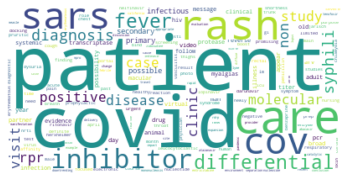


- More frequent words: patient, covid-19, care

- Main topics in cluster:
molecular docking studies
Similarity between keywords and proposed clusters: 0.4

Text 0: We present a healthy 29-year-old man who developed a leucocytoclastic vasculitis for COVID-19 with positive SARS-CoV-2 PCR in skin biopsy
Text 7: Apart from molecular docking studies, in vitro, animal, and human studies are very limited for evaluating the prophylactic role of ARVs against severe acute respiratory syndrome-corona virus 2 (SARS-CoV-2) infection. According to our findings, there is no definite evidence to support use of protease inhibitors for this purpose, despite the promising results of molecular studies and limited clinical evidence for ritonavir-boosted lopinavir, darunavir, and nelfinavir when used early in the course of the disease. Nucleotide/nucleoside reverse-transcriptase inhibitors (NRTI) also have shown binding affinity to main enzymes of SARS-CoV-2 in molecular, in vitro, and animal studies
Text 

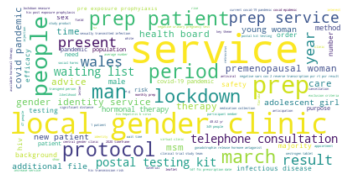


- More frequent chunks: service, local gender clinic, prep
WordCloud for chunks frequency in the cluster


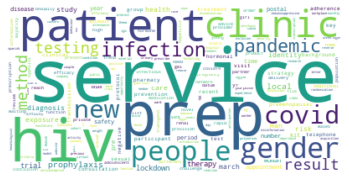


- More frequent words: service, prep, hiv

- Main topics in cluster:
challenges in accessing HIV treatment and care, and prevention services
Similarity between keywords and proposed clusters: 0.29

Text 1: Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'
Text 2: Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before 

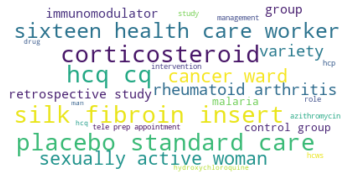


- More frequent chunks: placebo standard care, corticosteroid, silk fibroin insert
WordCloud for chunks frequency in the cluster


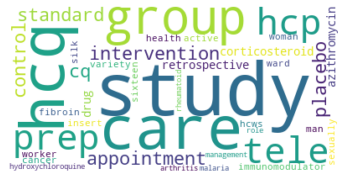


- More frequent words: study, hcq, care

- Main topics in cluster:
studies evaluating HCQ/CQ alone as intervention and placebo/standard care
Similarity between keywords and proposed clusters: 0.18

Text 3: All HCPs conducting tele-PrEP appointments were invited to participate
Text 4: We included studies evaluating HCQ/CQ alone as intervention and placebo/standard care as a control group. Retrospective studies and studies using other drugs (namely azithromycin, corticosteroids, immunomodulators, etc.. we excluded
Text 9: Sixteen health-care workers (HCWs) were working in the cancer ward (paramedical staff: 4, nurses: 6, residents: 4, and consultants: 2)
Text 12: These groups were composed of sexually active women and men, both straight and gay, who were shown a variety of silk fibroin inserts
Text 20: Hydroxychloroquine (HCQ), a 4-aminoquinoline, is used worldwide mainly for its role in management of malaria and rheumatoid arthritis
***********************
Sent is ['We present a health

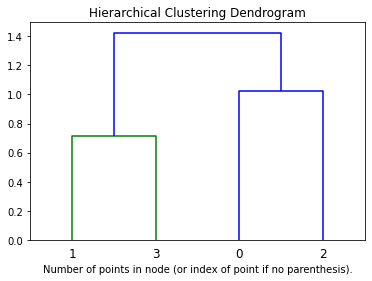

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


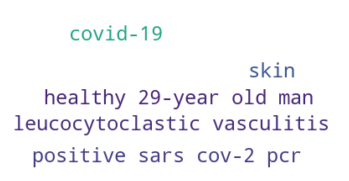


- More frequent chunks: leucocytoclastic vasculitis, skin, covid-19
WordCloud for chunks frequency in the cluster


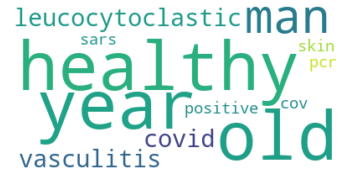


- More frequent words: healthy, 29-year, old

- Main topics in cluster:
COVID-19
Similarity between keywords and proposed clusters: 0.44

Text 0: We present a healthy 29-year-old man who developed a leucocytoclastic vasculitis for COVID-19 with positive SARS-CoV-2 PCR in skin biopsy
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster n.1: 2
WordCloud for chunks according to Tf-Idf score:


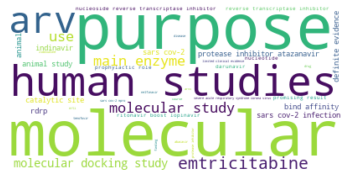


- More frequent chunks: molecular, purpose, human studies
WordCloud for chunks frequency in the cluster


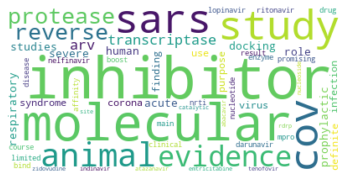


- More frequent words: inhibitor, molecular, study

- Main topics in cluster:
in vitro, animal, and human studies
Similarity between keywords and proposed clusters: 0.27

Text 1: Apart from molecular docking studies, in vitro, animal, and human studies are very limited for evaluating the prophylactic role of ARVs against severe acute respiratory syndrome-corona virus 2 (SARS-CoV-2) infection. According to our findings, there is no definite evidence to support use of protease inhibitors for this purpose, despite the promising results of molecular studies and limited clinical evidence for ritonavir-boosted lopinavir, darunavir, and nelfinavir when used early in the course of the disease. Nucleotide/nucleoside reverse-transcriptase inhibitors (NRTI) also have shown binding affinity to main enzymes of SARS-CoV-2 in molecular, in vitro, and animal studies
Text 3: The drugs predicted to bind the SARS-CoV-2 Mpro included the protease inhibitors atazanavir and indinavir. The ARVs predicted to

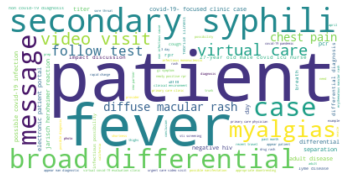


- More frequent chunks: patient, fever, secondary syphili
WordCloud for chunks frequency in the cluster


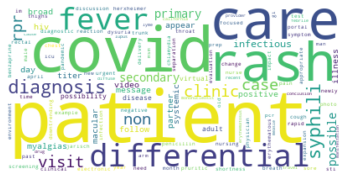


- More frequent words: patient, care, rash

- Main topics in cluster:
infectious mononucleosis, secondary syphilis, and Lyme disease
Similarity between keywords and proposed clusters: 0.4

Text 2: LEARNING OBJECTIVE #1: Build a differential for fever and a rash LEARNING OBJECTIVE #2: Maintain a broad differential in COVID-19- focused clinics CASE: A 27-year-old male COVID ICU nurse presents on an urgent care video visit in April, 2020 with 3 days of fever and myalgias. Additional history: This patient is on PrEP; he is MSM. He reports no new partners in the past two months. He denies dysuria, sore throat, GI symptoms, shortness of breath, chest pain, and cough. Last STI screening was 5 months prior and was notable for negative HIV and RPR and positive rectal chlamydia which was treated at that time. Physical exam: video visit shows a well-appearing man Diagnostics: COVID-19 PCR was ordered and returned negative the next day Two weeks later the patient sends a message in the electronic

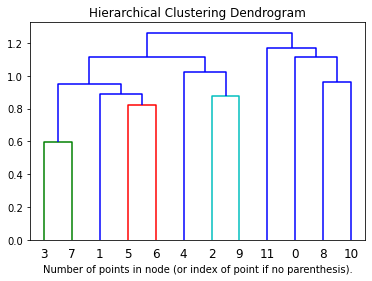

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


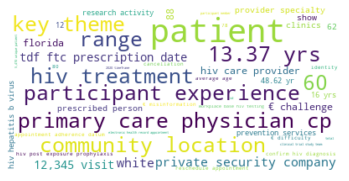


- More frequent chunks: patient, primary care physician cp, hiv treatment
WordCloud for chunks frequency in the cluster


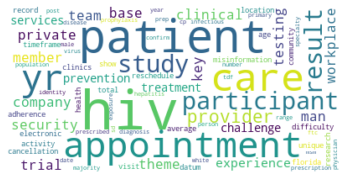


- More frequent words: hiv, patient, €

- Main topics in cluster:
challenges in accessing HIV treatment and care, and prevention services',
Similarity between keywords and proposed clusters: 0.2

Text 0: Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'
Text 8: Appointment adherence data for this study was taken from the electronic health record appointment using April 1, 2020-Ocotober 31, 2020 timeframe. No shows, cancellations and rescheduled appointments were excluded. Results: We identified 5,470 unique patients who completed a total of 12,345 visits at CAN community locations, 80% of clinics were located in Florida. The average age of the population 48.62 yrs with SD of 13.37 yrs with

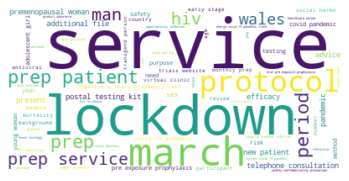


- More frequent chunks: service, lockdown, march
WordCloud for chunks frequency in the cluster


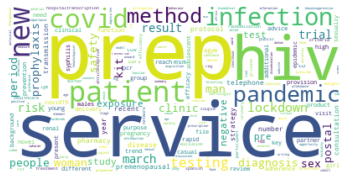


- More frequent words: prep, service, hiv

- Main topics in cluster:
recent trends in the epidemiology of HIV and syphilis
Similarity between keywords and proposed clusters: 0.35

Text 1: Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before randomization. Premenopausal women must have a negative urinary pregnancy test in the 7 days before starting the trial treatment. Premenopausal women and males with premenopausal couples must commit to using a high efficiency anticonceptive method. Exclusion Criteria: HIV infection. Weight less than 40 Kg. Participant with any immunosuppressive condition or hematological dis

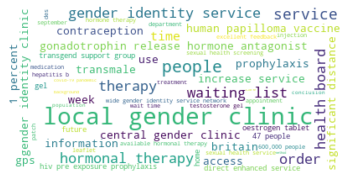


- More frequent chunks: local gender clinic, people, service
WordCloud for chunks frequency in the cluster


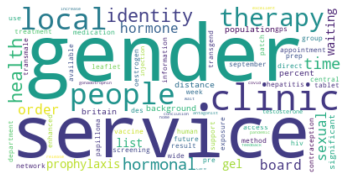


- More frequent words: gender, service, clinic

- Main topics in cluster:
Sexual health screening and treatment, contraception and prophylaxis
Similarity between keywords and proposed clusters: 0.08

Text 11: Background: It is estimated that around 1 percent of the population in Britain might identify as transgender, that is around 600,000 people. In order to access gender identity clinics some people may have to travel significant distances and waiting times for appointments can be very long, even years. In order to improve access to gender identity services and care our sexual health service set up a local gender clinic in our department as part of a wider gender identity service network with a central gender clinic and local gender clinics in each health board. Once people have been endorsed for hormone therapy they will be referred to the local gender clinic in their health board. Method: The local gender clinic in our service was set up in September 2019 and runs once per week. O

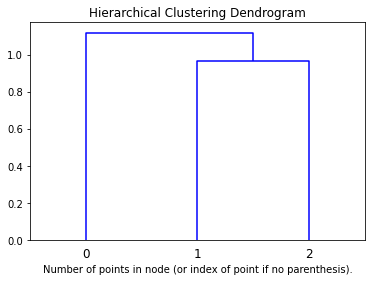

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


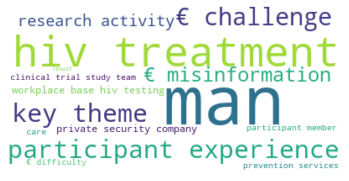


- More frequent chunks: man, hiv treatment, participant experience
WordCloud for chunks frequency in the cluster


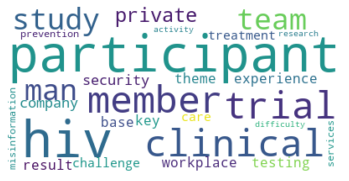


- More frequent words: €, participant, hiv

- Main topics in cluster:
challenges in accessing HIV treatment and care, and prevention services',
Similarity between keywords and proposed clusters: 0.16

Text 0: Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


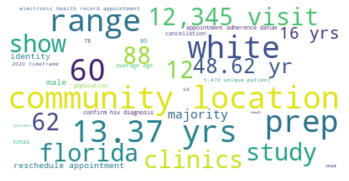


- More frequent chunks: community location, prep, range
WordCloud for chunks frequency in the cluster


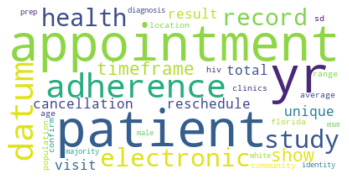


- More frequent words: appointment, patient, yrs

- Main topics in cluster:
No shows, cancellations and rescheduled appointments
Similarity between keywords and proposed clusters: 0.21

Text 1: Appointment adherence data for this study was taken from the electronic health record appointment using April 1, 2020-Ocotober 31, 2020 timeframe. No shows, cancellations and rescheduled appointments were excluded. Results: We identified 5,470 unique patients who completed a total of 12,345 visits at CAN community locations, 80% of clinics were located in Florida. The average age of the population 48.62 yrs with SD of 13.37 yrs with range of 16 yrs - 88 yrs. 88% of patients had a confirmed HIV diagnosis and 12% of patients were on PrEP, majority (78%) identity as male, 62% identify as MSM, and 60% identified as White
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


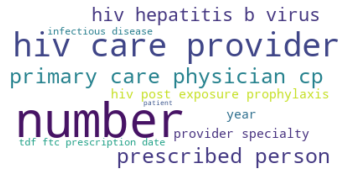


- More frequent chunks: number, hiv care provider, primary care physician cp
WordCloud for chunks frequency in the cluster


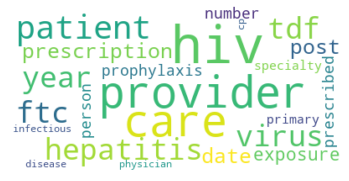


- More frequent words: hiv, provider, care

- Main topics in cluster:
infectious diseases
Similarity between keywords and proposed clusters: 0.26

Text 2: We excluded patients with HIV or hepatitis B virus during the year before the first TDF/FTC prescription date, or HIV post-exposure prophylaxis. We compared the number of prescribed persons by provider specialty (primary care physicians CPs], infectious diseases, and others) and whether they were HIV care providers [O
***********************
Sent is ["Participants Members of the clinical trial study team, and men working in private security companies who undertook workplace-based HIV testing. Results The key themes for participants experiences were: € challenges in accessing HIV treatment and care, and prevention services', € misinformation' and € difficulty participating in research activities'"]
Hierarchical Clustering dendrogram for label P
Sent is ['Appointment adherence data for this study was taken from the electronic health r

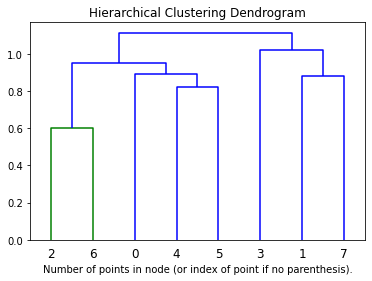

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 5
WordCloud for chunks according to Tf-Idf score:


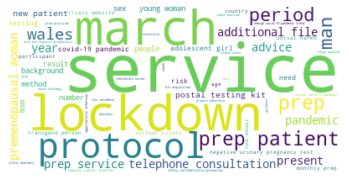


- More frequent chunks: service, lockdown, march
WordCloud for chunks frequency in the cluster


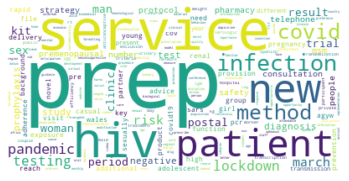


- More frequent words: prep, service, hiv

- Main topics in cluster:
Retroviruses and Opportunistic Infections
Similarity between keywords and proposed clusters: 0.34

Text 0: Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before randomization. Premenopausal women must have a negative urinary pregnancy test in the 7 days before starting the trial treatment. Premenopausal women and males with premenopausal couples must commit to using a high efficiency anticonceptive method. Exclusion Criteria: HIV infection. Weight less than 40 Kg. Participant with any immunosuppressive condition or hematological disease. Full p

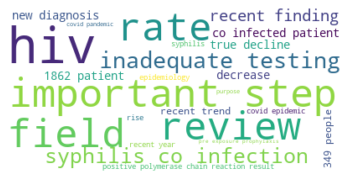


- More frequent chunks: hiv, important step, rate
WordCloud for chunks frequency in the cluster


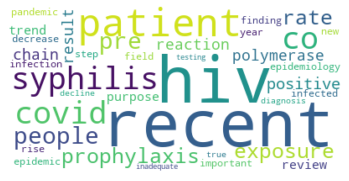


- More frequent words: hiv, recent, patient

- Main topics in cluster:
recent trends in the epidemiology of HIV and syphilis
Similarity between keywords and proposed clusters: 0.38

Text 1: Among 1862 patients, including 349 people with HIV - with most of these being virally suppressed and 308 having recently used pre-exposure prophylaxis - we compared rates of positive polymerase chain reaction results
Text 7: Purpose of Review: To highlight recent trends in the epidemiology of HIV and syphilis, the impact of the COVID epidemic, our approach to care of co-infected patients, and our views on important next steps in advancing the field. Recent Findings: HIV and syphilis co-infection has been on the rise in recent years although since the COVID pandemic there is a decrease in new diagnoses—it remains unclear if this represents a true decline or inadequate testing or under-reporting
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster 

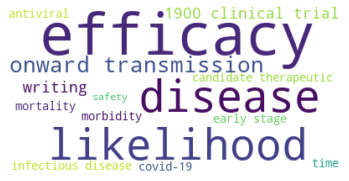


- More frequent chunks: efficacy, disease, likelihood
WordCloud for chunks frequency in the cluster


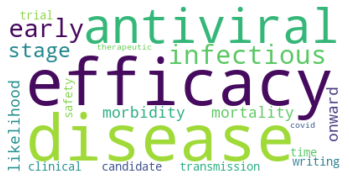


- More frequent words: efficacy, disease, antiviral

- Main topics in cluster:
reducing morbidity, mortality, and the likelihood of onward transmission
Similarity between keywords and proposed clusters: 0.56

Text 3: Antivirals have demonstrated efficacy in treating other infectious diseases in early stages of disease, reducing morbidity, mortality, and the likelihood of onward transmission. At the time of writing, more than 1900 clinical trials are registered globally to assess the efficacy and safety of candidate therapeutics for COVID-19
***********************
Sent is ['Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG

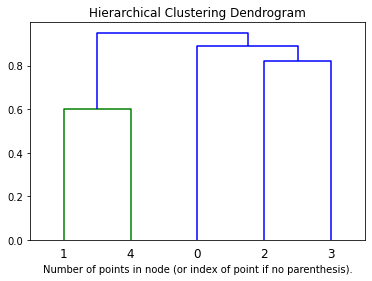

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


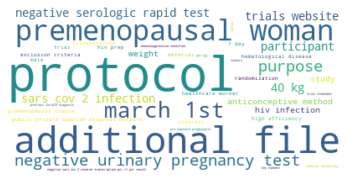


- More frequent chunks: protocol, additional file, premenopausal woman
WordCloud for chunks frequency in the cluster


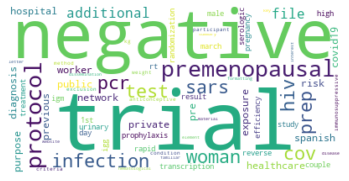


- More frequent words: negative, premenopausal, protocol

- Main topics in cluster:
summary of the key elements of the full protocol
Similarity between keywords and proposed clusters: 0.34

Text 0: Healthcare workers from the public and private Spanish hospital network at risk of SARS-CoV 2 infection. Not having a previous COVID19 diagnosis. Understanding the purpose of the trial and not having taken any pre-exposure prophylaxis (PrEP) including HIV PrEP from March 1st 2020 until study enrolment. Having a negative SARS-CoV 2 reverse-transcription PCR (RT-PCR) result or a negative serologic rapid test (IgM/IgG) result before randomization. Premenopausal women must have a negative urinary pregnancy test in the 7 days before starting the trial treatment. Premenopausal women and males with premenopausal couples must commit to using a high efficiency anticonceptive method. Exclusion Criteria: HIV infection. Weight less than 40 Kg. Participant with any immunosuppressive condition or hematol

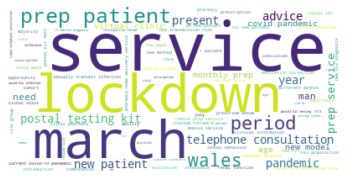


- More frequent chunks: service, lockdown, march
WordCloud for chunks frequency in the cluster


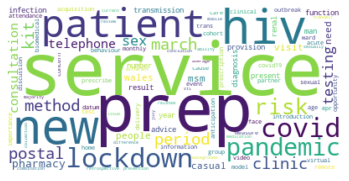


- More frequent words: service, prep, hiv

- Main topics in cluster:
Many people changed sexual behaviours early in the COVID pandemic
Similarity between keywords and proposed clusters: 0.33

Text 1: Introduction: In Wales, PrEP has been freely available for at risk groups such as MSM and trans people since 2016. Despite lockdown measures, casual sex continued for some causing concern about HIV acquisition. Due to a need to reduce face to face visits and provide a service following clinical staff redeployment to COVID wards, the service developed a new model for PrEP provision. Postal kit testing for HIV became available in Wales regardless of age or risk and this provided an opportunity to integrate these services and provide remote PrEP services. Methods: We examined clinical information, attendance and prescribing data collected from EPR during the COVID19 outbreak and compared with 2019. Results: Between 01/02/2020-01/04/2020, 186 attended the PrEP service in anticipation of lockd

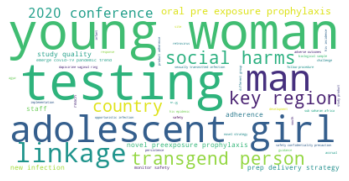


- More frequent chunks: young woman, testing, adolescent girl
WordCloud for chunks frequency in the cluster


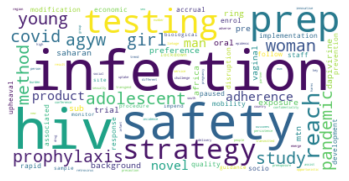


- More frequent words: hiv, infection, safety

- Main topics in cluster:
oral pre-exposure prophylaxis
Similarity between keywords and proposed clusters: 0.34

Text 2: Background: The MTN-034/REACH trial, evaluating safety and preferences of oral pre-exposure prophylaxis (PrEP) and the dapivirine vaginal ring among adolescent girls and young women (AGYW) in sub-Saharan Africa, was in full implementation when the COVID-19 pandemic erupted. Associated socio-economic upheaval and mobility disruptions impacted the 247 enrolled AGYW, and staff, potentially jeopardizing study quality and development of HIV prevention methods. In response, accrual was paused and rapid modifications to follow-up procedures were implemented to distribute study product, monitor safety, handle biological samples and testing, and support product adherence. Methods: As sites prepared for impending lockdowns, guidance was issued regarding safety and confidentiality precautions, mitigating social harms (e.g
Text 3: 

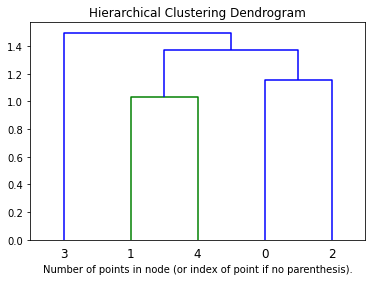

*********************
Analysis of the label 'P'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


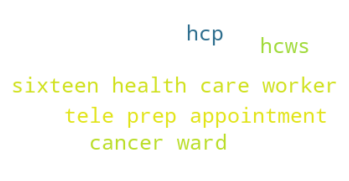


- More frequent chunks: sixteen health care worker, hcp, tele prep appointment
WordCloud for chunks frequency in the cluster


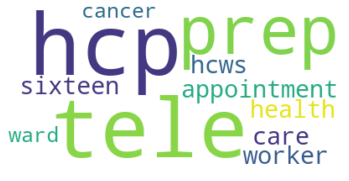


- More frequent words: hcp, tele, prep

- Main topics in cluster:
2
Similarity between keywords and proposed clusters: 0.15

Text 0: All HCPs conducting tele-PrEP appointments were invited to participate
Text 2: Sixteen health-care workers (HCWs) were working in the cancer ward (paramedical staff: 4, nurses: 6, residents: 4, and consultants: 2)
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster n.1: 2
WordCloud for chunks according to Tf-Idf score:


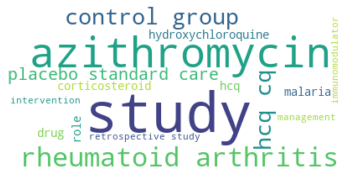


- More frequent chunks: study, azithromycin, rheumatoid arthritis
WordCloud for chunks frequency in the cluster


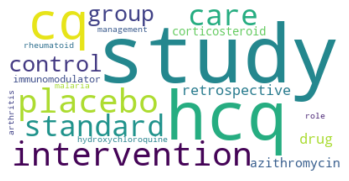


- More frequent words: study, hcq, cq

- Main topics in cluster:
Retrospective studies and studies using other drugs
Similarity between keywords and proposed clusters: 0.23

Text 1: We included studies evaluating HCQ/CQ alone as intervention and placebo/standard care as a control group. Retrospective studies and studies using other drugs (namely azithromycin, corticosteroids, immunomodulators, etc.. we excluded
Text 4: Hydroxychloroquine (HCQ), a 4-aminoquinoline, is used worldwide mainly for its role in management of malaria and rheumatoid arthritis
***********************
*********************
Analysis of the label 'P'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


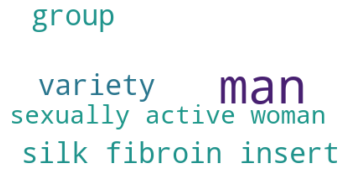


- More frequent chunks: man, silk fibroin insert, variety
WordCloud for chunks frequency in the cluster


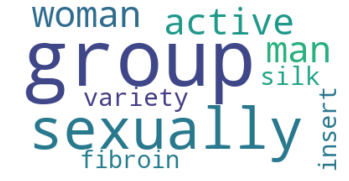


- More frequent words: group, sexually, active

- Main topics in cluster:
sexually active women and men, both straight and gay
Similarity between keywords and proposed clusters: -0.09

Text 3: These groups were composed of sexually active women and men, both straight and gay, who were shown a variety of silk fibroin inserts
***********************
Sent is ['All HCPs conducting tele-PrEP appointments were invited to participate', 'Sixteen health-care workers (HCWs) were working in the cancer ward (paramedical staff: 4, nurses: 6, residents: 4, and consultants: 2)']
Hierarchical Clustering dendrogram for label P
Sent is ['We included studies evaluating HCQ/CQ alone as intervention and placebo/standard care as a control group. Retrospective studies and studies using other drugs (namely azithromycin, corticosteroids, immunomodulators, etc.. we excluded', 'Hydroxychloroquine (HCQ), a 4-aminoquinoline, is used worldwide mainly for its role in management of malaria and rheumatoid arthritis']

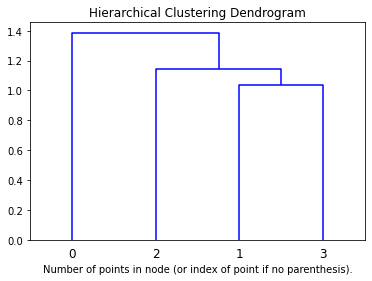

*********************
Analysis of the label 'I'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


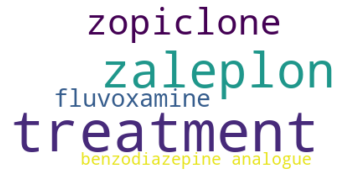


- More frequent chunks: treatment, zaleplon, zopiclone
WordCloud for chunks frequency in the cluster


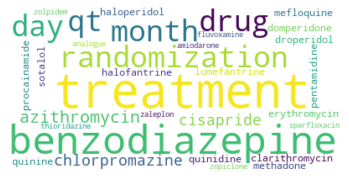


- More frequent words: treatment, benzodiazepine, drug

- Main topics in cluster:
azithromycin, chlorpromazine
Similarity between keywords and proposed clusters: 0.09

Text 0: Treatment with drugs that may prolong QT in the last month before randomization for more than 7 days including: azithromycin, chlorpromazine, cisapride, clarithromycin, domperidone, droperidol, erythromycin, halofantrine, haloperidol, lumefantrine, mefloquine, methadone, pentamidine, procainamide, quinidine, quinine, sotalol, sparfloxacin, thioridazine, amiodarone. Treatment with fluvoxamine. Treatment with benzodiazepines or benzodiazepine analogues such as zolpidem, zopiclone or zaleplon
***********************
*********************
Analysis of the label 'I'

- Number of elements per cluster n.1: 2
WordCloud for chunks according to Tf-Idf score:


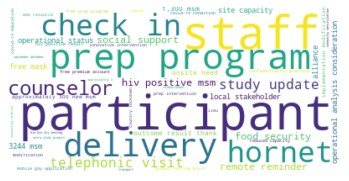


- More frequent chunks: participant, staff, prep program
WordCloud for chunks frequency in the cluster


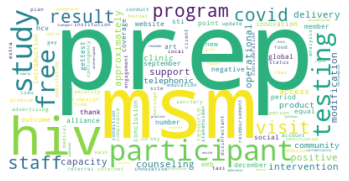


- More frequent words: prep, msm, hiv

- Main topics in cluster:
COVID- 19 key messages
Similarity between keywords and proposed clusters: 0.29

Text 1: com.ua, for passing of testing and/or to receive equal counseling on PrEP, at Alliance.Global's testing points. All confirmed HIV-positive MSM have been provided a social support to receive ART; for HIV-negative MSM, we proposed to become a member of the free PrEP program. Outcomes/Results Thanks to advertising on two web resources, during September-December 2020, 841 MSM registered for HIV/HCV/STI testing through the GetTest website and 80% of them were tested (the number of HIV-positive results was approximately 4%). 3244 MSM have learned about the PrEP program during this period, approximately 300 new MSM have been attracted to the PrEP program (the coverage of the PrEP intervention in 2020 amounted about 1,300 MSM). Innovations/Conclusions Thanks to the introduction of two advertising campaigns on the Internet, at the COVID-19 con

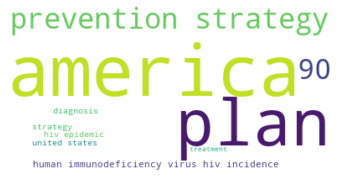


- More frequent chunks: america, plan, prevention strategy
WordCloud for chunks frequency in the cluster


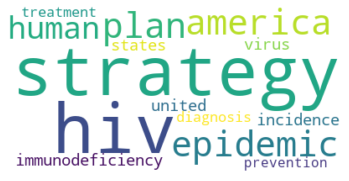


- More frequent words: strategy, hiv, epidemic

- Main topics in cluster:
diagnosis, treatment, and prevention strategies
Similarity between keywords and proposed clusters: 0.27

Text 2: A strategy titled “Ending the HIV Epidemic: A Plan for America” aims to reduce human immunodeficiency virus (HIV) incidence in the United States by at least 90% by 2030, using diagnosis, treatment, and prevention strategies
***********************
Sent is ['Treatment with drugs that may prolong QT in the last month before randomization for more than 7 days including: azithromycin, chlorpromazine, cisapride, clarithromycin, domperidone, droperidol, erythromycin, halofantrine, haloperidol, lumefantrine, mefloquine, methadone, pentamidine, procainamide, quinidine, quinine, sotalol, sparfloxacin, thioridazine, amiodarone. Treatment with fluvoxamine. Treatment with benzodiazepines or benzodiazepine analogues such as zolpidem, zopiclone or zaleplon']
Hierarchical Clustering dendrogram for label I
Sent is ["

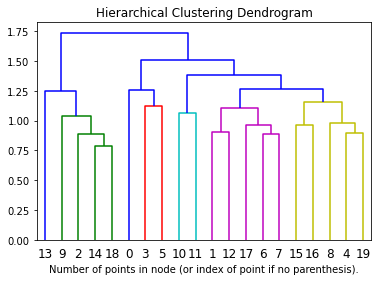

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


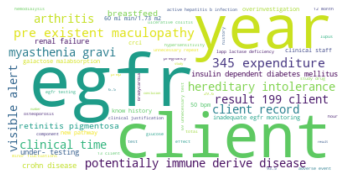


- More frequent chunks: egfr, client, year
WordCloud for chunks frequency in the cluster


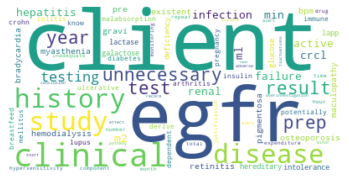


- More frequent words: client, egfr, clinical

- Main topics in cluster:
Pregnancy. Breastfeeding
Similarity between keywords and proposed clusters: 0.2

Text 0: Active hepatitis B infection. Renal failure (CrCl < 60 mL/min/1.73 m2) or need for hemodialysis. Osteoporosis. Myasthenia gravis. Pre-existent maculopathy. Retinitis pigmentosa. Bradycardia (less than 50 bpm). Hereditary intolerance to galactose, Lapp lactase deficiency or glucose or galactose malabsorption. Pregnancy. Breastfeeding. History of potentially immune derived diseases such as: lupus, Crohn's disease, ulcerative colitis, vasculitis or rheumatoid arthritis. Insulin-dependent diabetes mellitus. Known history of hypersensitivity to the study drug or any of its components
Text 3: The number of unnecessary repeat eGFRs within 12 months was recorded. Results 199 clients were identified of whom 186 (93.5%) had eGFR checked in the year prior to issuing PrEP. 13 clients (6.5%) therefore had inadequate eGFR monitoring whilst

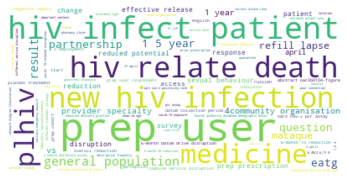


- More frequent chunks: prep user, hiv infect patient, hiv relate death
WordCloud for chunks frequency in the cluster


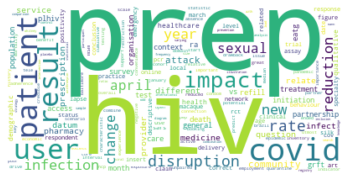


- More frequent words: prep, hiv, patient

- Main topics in cluster:
trends in PrEP initiations and refill lapses
Similarity between keywords and proposed clusters: 0.44

Text 1: We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and experiences with quarantine; 2) Health and healthcare access; 3) Employment and economic impact of COVID-19
Text 4: Demographic characteristics of PrEP-user respondents were broadly representative of our whole PrEP-cohort. PrEP-users identified convenience as a key benefit along with access to PrEP with reduced potential for COVID-19 exposure. Drawbacks were largely technological, including poor connection or issues with online booking. All HCPs felt that tele-PrEP allowed them to assess patients safely and confidently
Text 6: We used descriptive statistics to quantify COVID-19 impact on HIV care in Brazil and compar

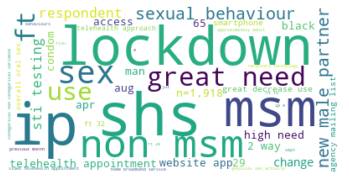


- More frequent chunks: shs, ip, lockdown
WordCloud for chunks frequency in the cluster


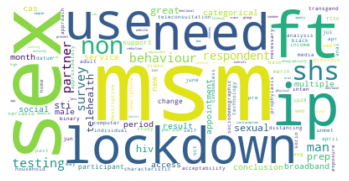


- More frequent words: msm, sex, ft

- Main topics in cluster:
PrEP teleconsultation and HIV self-testing
Similarity between keywords and proposed clusters: 0.16

Text 2: To understand the acceptability of PrEP teleconsultation and HIV self-testing, we conducted a web-based study during social distancing period (April–May, 2020) among men who have sex with men and transgender/non-binary individuals using social media
Text 9: Data on sociodemographic characteristics, sexual behaviour and related mental well-being experienced during lockdown (defined as 23 March-30 June 2020) were extracted. Categorical and non-categorical variables were compared according to HIV pre-exposure prophylaxis (PrEP) use
Text 13: Descriptive analysis shows that Blacks were 15% and those who identify as heterosexual were 24% more likely to have failed telehealth appointments (FT). FT decreased as in-person (IP) appointments increased. Apr (FT 48% v. IP 5%) May (FT 53% v. IP 4%); Jun (FT 32% v. IP 7%); Jul (FT3

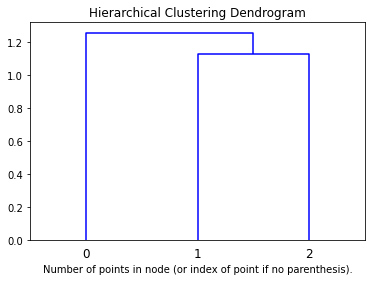

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


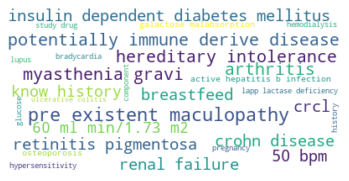


- More frequent chunks: pre existent maculopathy, potentially immune derive disease, hereditary intolerance
WordCloud for chunks frequency in the cluster


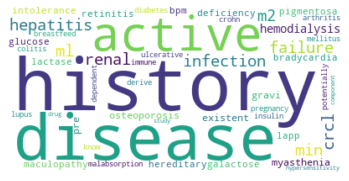


- More frequent words: history, disease, active

- Main topics in cluster:
Pregnancy. Breastfeeding
Similarity between keywords and proposed clusters: 0.26

Text 0: Active hepatitis B infection. Renal failure (CrCl < 60 mL/min/1.73 m2) or need for hemodialysis. Osteoporosis. Myasthenia gravis. Pre-existent maculopathy. Retinitis pigmentosa. Bradycardia (less than 50 bpm). Hereditary intolerance to galactose, Lapp lactase deficiency or glucose or galactose malabsorption. Pregnancy. Breastfeeding. History of potentially immune derived diseases such as: lupus, Crohn's disease, ulcerative colitis, vasculitis or rheumatoid arthritis. Insulin-dependent diabetes mellitus. Known history of hypersensitivity to the study drug or any of its components
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


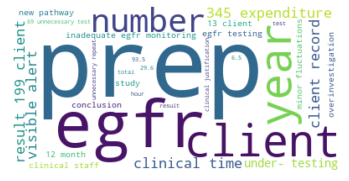


- More frequent chunks: prep, egfr, client
WordCloud for chunks frequency in the cluster


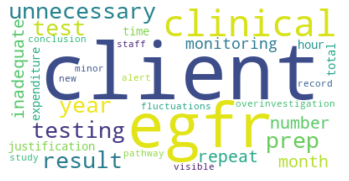


- More frequent words: client, egfr, clinical

- Main topics in cluster:
overinvestigation of clients with minor fluctuations in eGFR
Similarity between keywords and proposed clusters: 0.09

Text 1: The number of unnecessary repeat eGFRs within 12 months was recorded. Results 199 clients were identified of whom 186 (93.5%) had eGFR checked in the year prior to issuing PrEP. 13 clients (6.5%) therefore had inadequate eGFR monitoring whilst continuing to take PrEP. Of those tested, 55 (29.6%) had eGFR re-checked within a year without clinical justification with a total of 69 unnecessary tests performed. This equates to £345 expenditure on tests, six hours of clinical time administering results and overinvestigation of clients with minor fluctuations in eGFR. We implemented a new pathway for eGFR testing, including a visible alert on each client's record allowing clinical staff to immediately see when the eGFR was last checked, and when the next is due. Conclusion This study identified b

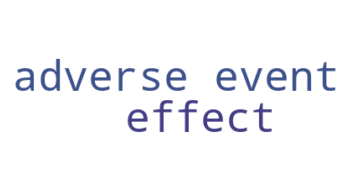


- More frequent chunks: adverse event, effect
WordCloud for chunks frequency in the cluster


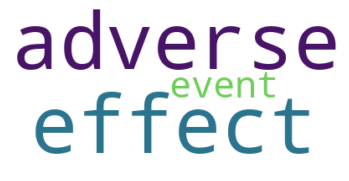


- More frequent words: effect, adverse, event

- Main topics in cluster:
side effects and serious adverse events
Similarity between keywords and proposed clusters: 0.2

Text 2: We collected side effects and serious adverse events
***********************
Sent is ["Active hepatitis B infection. Renal failure (CrCl < 60 mL/min/1.73 m2) or need for hemodialysis. Osteoporosis. Myasthenia gravis. Pre-existent maculopathy. Retinitis pigmentosa. Bradycardia (less than 50 bpm). Hereditary intolerance to galactose, Lapp lactase deficiency or glucose or galactose malabsorption. Pregnancy. Breastfeeding. History of potentially immune derived diseases such as: lupus, Crohn's disease, ulcerative colitis, vasculitis or rheumatoid arthritis. Insulin-dependent diabetes mellitus. Known history of hypersensitivity to the study drug or any of its components"]
Hierarchical Clustering dendrogram for label O
Sent is ["The number of unnecessary repeat eGFRs within 12 months was recorded. Results 199 clients 

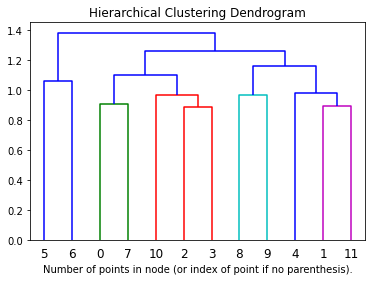

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 5
WordCloud for chunks according to Tf-Idf score:


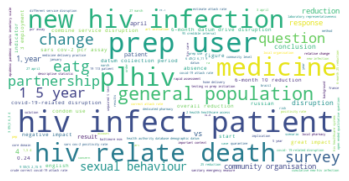


- More frequent chunks: hiv infect patient, prep user, hiv relate death
WordCloud for chunks frequency in the cluster


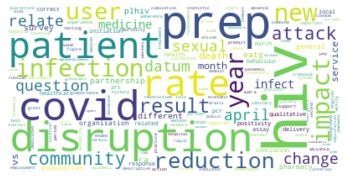


- More frequent words: hiv, prep, disruption

- Main topics in cluster:
1) COVID-19 infection history and experiences with quarantine
Similarity between keywords and proposed clusters: 0.45

Text 0: We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and experiences with quarantine; 2) Health and healthcare access; 3) Employment and economic impact of COVID-19
Text 2: We used descriptive statistics to quantify COVID-19 impact on HIV care in Brazil and compared indicators of both years by unpaired T-tests. Results: In April 2020, PEP and PrEP dispenses fell 57% and 53%, respectively, when compared to January, and new PrEP users dropped 70%
Text 3: We estimated the median (95% credible interval) relative change in cumulative new HIV infections and HIV-related deaths among MSM over 1 and 5 years from the start of COVID- 19-related disruptions, compar

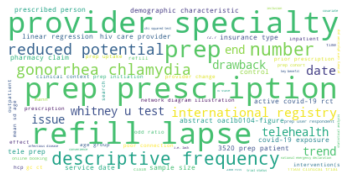


- More frequent chunks: provider specialty, prep prescription, refill lapse
WordCloud for chunks frequency in the cluster


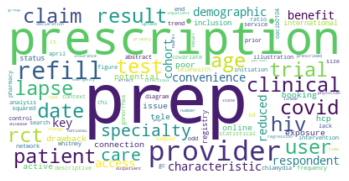


- More frequent words: prep, prescription, provider

- Main topics in cluster:
trends in PrEP initiations and refill lapses
Similarity between keywords and proposed clusters: 0.42

Text 1: Demographic characteristics of PrEP-user respondents were broadly representative of our whole PrEP-cohort. PrEP-users identified convenience as a key benefit along with access to PrEP with reduced potential for COVID-19 exposure. Drawbacks were largely technological, including poor connection or issues with online booking. All HCPs felt that tele-PrEP allowed them to assess patients safely and confidently
Text 4: Active COVID-19 RCTs in international registries were eligible for inclusion. We extracted trial status, intervention(s), control, sample size, and clinical context to generate descriptive frequencies, network diagram illustrations, and statistical analyses including odds ratios and the Mann–Whitney U-test. Results: Our search identified 11503 clinical trials registered for COVID-19 and ide

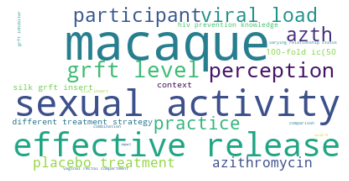


- More frequent chunks: macaque, sexual activity, effective release
WordCloud for chunks frequency in the cluster


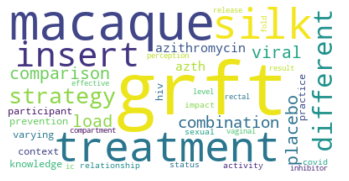


- More frequent words: grft, macaque, treatment

- Main topics in cluster:
HIV prevention knowledge and practices
Similarity between keywords and proposed clusters: 0.32

Text 5: In macaques, we tested different treatment strategies in comparison to a placebo treatment, before and after peak viral load, alone or in combination with azithromycin (AZTH)
Text 6: Participants discussed HIV prevention knowledge and practices in the context of varying relationship statuses, impacts of COVID-19 on their sexual activity, and their perceptions of the silk inserts. Results: The Silk-Grft inserts readily dissolved in the vaginal and rectal compartments in macaques, where Grft levels were substantially above 100-fold IC(50), indicating effective release of Grft inhibitor
***********************
Sent is ['We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and

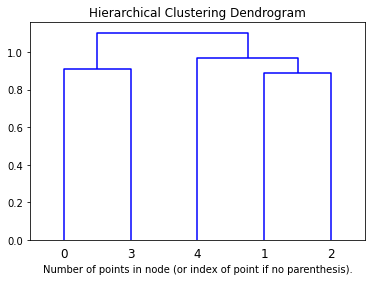

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


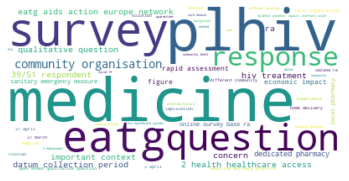


- More frequent chunks: medicine, plhiv, survey
WordCloud for chunks frequency in the cluster


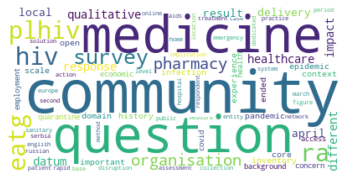


- More frequent words: community, question, medicine

- Main topics in cluster:
1) COVID-19 infection history and experiences with quarantine
Similarity between keywords and proposed clusters: 0.36

Text 0: We quantified core domains using the Epidemic-Pandemic Impacts Inventory scale and provided important context through open-ended qualitative questions assessing: 1) COVID-19 infection history and experiences with quarantine; 2) Health and healthcare access; 3) Employment and economic impact of COVID-19
Text 3: Background: In response to COVID-19 being declared a pandemic, concerns were raised about the various implications for PLHIV, different communities affected by HIV and healthcare systems. EATG collected several data using two rapid assessments (RAs) reporting the disruptions and solutions found at community level. Given sanitary emergency measures, a question was included on how medicines were accessed by PLHIV safely and easily, to document medicines delivery practices in di

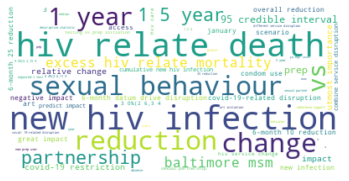


- More frequent chunks: new hiv infection, hiv relate death, change
WordCloud for chunks frequency in the cluster


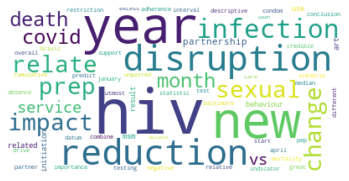


- More frequent words: hiv, year, new

- Main topics in cluster:
new HIV infections and HIV-related deaths
Similarity between keywords and proposed clusters: 0.37

Text 1: We used descriptive statistics to quantify COVID-19 impact on HIV care in Brazil and compared indicators of both years by unpaired T-tests. Results: In April 2020, PEP and PrEP dispenses fell 57% and 53%, respectively, when compared to January, and new PrEP users dropped 70%
Text 2: We estimated the median (95% credible interval) relative change in cumulative new HIV infections and HIV-related deaths among MSM over 1 and 5 years from the start of COVID- 19-related disruptions, compared with a scenario without COVID-19-related disruptions. Results: A 6-month 25% reduction in sexual partners among Baltimore MSM, without HIV service changes, could reduce new HIV infections by 12 2%(11 7,12 8%) and 3 0%(2 6,3 4%) over 1 and 5 years, respectively. In the absence of changes in sexual behaviour, the 6-month data-driven dis

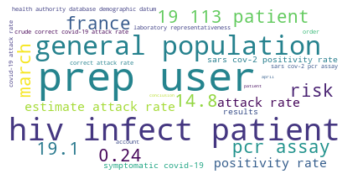


- More frequent chunks: prep user, hiv infect patient, general population
WordCloud for chunks frequency in the cluster


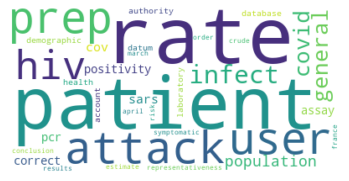


- More frequent words: rate, patient, attack

- Main topics in cluster:
CONCLUSION
Similarity between keywords and proposed clusters: 0.45

Text 4: SARS-CoV-2 positivity rate on PCR assays and COVID-19 attack rate were determined in HIV-infected patients and in PrEP users. COVID-19 attack rate in the general population was estimated from health authorities' database and demographic data. A corrected attack rate taking into account the laboratory representativeness was calculated. RESULTS: From March to April 2020, 24 860 samples from 19 113 patients (HIV-infected 77, PrEP users 27, others 19 009) were assessed for SARS-CoV-2 PCR assay. The positivity rate appeared similar in HIV-infected patients (15.6%), in PrEP users (14.8%) and in other patients (19.1%). The crude/corrected COVID-19 attack rate appeared similar in HIV-infected patients (0.31/0.38%) and in PrEP users (0.38/0.42%), and of the same order as the estimated attack rate in the general population (0.24%). CONCLUSION: The r

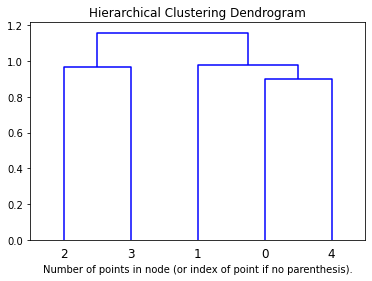

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


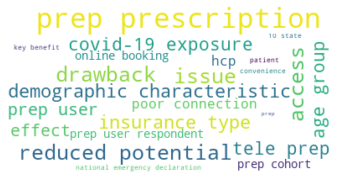


- More frequent chunks: prep prescription, reduced potential, access
WordCloud for chunks frequency in the cluster


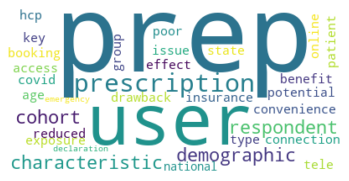


- More frequent words: prep, user, prescription

- Main topics in cluster:
COVID-19 exposure. Drawbacks were largely technological
Similarity between keywords and proposed clusters: 0.42

Text 0: Demographic characteristics of PrEP-user respondents were broadly representative of our whole PrEP-cohort. PrEP-users identified convenience as a key benefit along with access to PrEP with reduced potential for COVID-19 exposure. Drawbacks were largely technological, including poor connection or issues with online booking. All HCPs felt that tele-PrEP allowed them to assess patients safely and confidently
Text 4: We stratified the effect of COVID-19 on PrEP prescriptions by age group, insurance type, and among 10 states with most PrEP prescriptions prior to the national emergency declaration
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


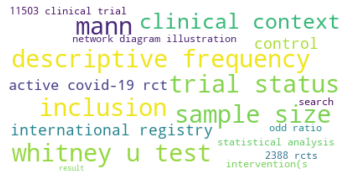


- More frequent chunks: descriptive frequency, sample size, inclusion
WordCloud for chunks frequency in the cluster


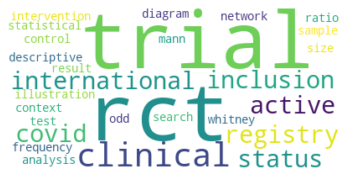


- More frequent words: trial, clinical, active

- Main topics in cluster:
trial status, intervention(s), control, sample size, and clinical context
Similarity between keywords and proposed clusters: 0.52

Text 1: Active COVID-19 RCTs in international registries were eligible for inclusion. We extracted trial status, intervention(s), control, sample size, and clinical context to generate descriptive frequencies, network diagram illustrations, and statistical analyses including odds ratios and the Mann–Whitney U-test. Results: Our search identified 11503 clinical trials registered for COVID-19 and identified 2388 RCTs
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.2: 2
WordCloud for chunks according to Tf-Idf score:


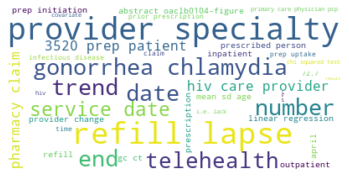


- More frequent chunks: provider specialty, refill lapse, number
WordCloud for chunks frequency in the cluster


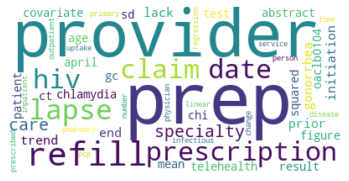


- More frequent words: prep, provider, refill

- Main topics in cluster:
trends in PrEP initiations and refill lapses
Similarity between keywords and proposed clusters: 0.25

Text 2: We described trends in PrEP initiations and refill lapses (i.e., lack of refill before end of prior prescription), testing for gonorrhea/chlamydia (GC/CT) and HIV, and telehealth. We assessed covariates associated with refill lapses in April 2020 using chi-squared tests. Results: Of 3520 PrEP patients, the mean (SD) age was 36.9 (11.2), 72.7% were white, 13.6% Latinx, 92.1% cisgender men and 12.9% Abstract OACLB0104-Figure 1. publically insured
Text 3: We matched pharmacy claims using PrEP fill date with service date of outpatient or inpatient claims for each prescription to identify provider specialty. We compared the number of prescribed persons by provider specialty (primary care physicians [PCPs], infectious diseases, and others) and whether they were HIV care providers. PrEP uptake and provider chang

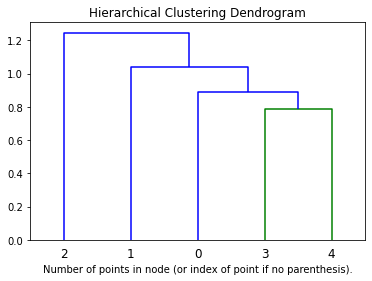

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


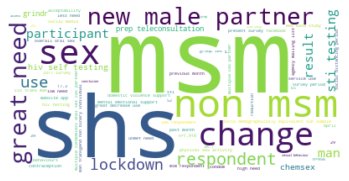


- More frequent chunks: msm, shs, non msm
WordCloud for chunks frequency in the cluster


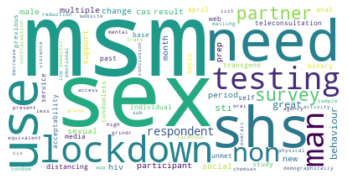


- More frequent words: msm, sex, need

- Main topics in cluster:
PrEP teleconsultation and HIV self-testing
Similarity between keywords and proposed clusters: 0.16

Text 0: To understand the acceptability of PrEP teleconsultation and HIV self-testing, we conducted a web-based study during social distancing period (April–May, 2020) among men who have sex with men and transgender/non-binary individuals using social media
Text 3: We examined sexual behaviour and service use since lockdown (23/03/ 2020) and in the three previous months, and 'unmet need for STI testing' since lockdown (any new male partners and/or multiple condomless anal sex (CAS) partners without testing for STIs). We compared behaviours over the past three months between socio-demographically equivalent sub-samples recruited via Grindr into the present survey (N=956) and a 2017 survey (N=1,918). Results In 2020, 36.7% of participants reported new male partners and 17.3% reported multiple CAS partners since lockdown
Text

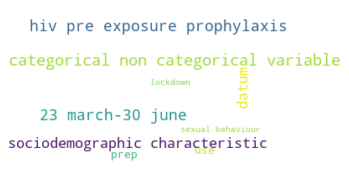


- More frequent chunks: categorical non categorical variable, 23 march-30 june, hiv pre exposure prophylaxis
WordCloud for chunks frequency in the cluster


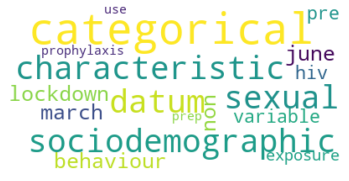


- More frequent words: categorical, datum, sociodemographic

- Main topics in cluster:
sociodemographic characteristics, sexual behaviour and related mental well-being
Similarity between keywords and proposed clusters: 0.19

Text 1: Data on sociodemographic characteristics, sexual behaviour and related mental well-being experienced during lockdown (defined as 23 March-30 June 2020) were extracted. Categorical and non-categorical variables were compared according to HIV pre-exposure prophylaxis (PrEP) use
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


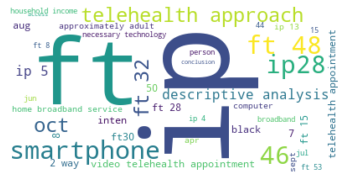


- More frequent chunks: ip, ft, smartphone
WordCloud for chunks frequency in the cluster


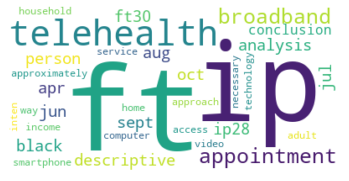


- More frequent words: ft, ip, telehealth

- Main topics in cluster:
Conclusion
Similarity between keywords and proposed clusters: 0.07

Text 2: Descriptive analysis shows that Blacks were 15% and those who identify as heterosexual were 24% more likely to have failed telehealth appointments (FT). FT decreased as in-person (IP) appointments increased. Apr (FT 48% v. IP 5%) May (FT 53% v. IP 4%); Jun (FT 32% v. IP 7%); Jul (FT30% v. IP 8%); Aug ( FT 28% v. IP 13%); Sept (FT 15% v IP28%); Oct (FT 8% v. IP 50%). Conclusion: Currently, approximately three-in-ten adults with household incomes below $30,000 a year don't own a smartphone and more than four-inten don't have home broadband services (44%) or a computer (46%). Those who often have the most to gain from telehealth approaches are also the least likely to have access to broadband and/or cannot afford the necessary technology to engage in 2 way video telehealth appointments
***********************
Sent is ['To understand the acceptab

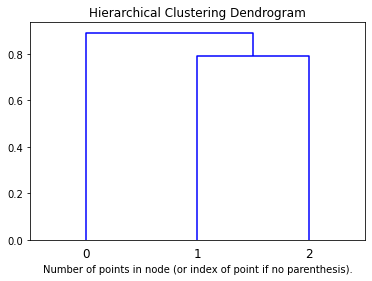

*********************
Analysis of the label 'O'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


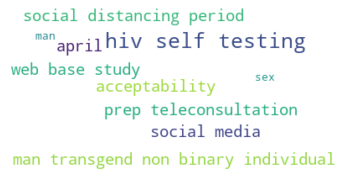


- More frequent chunks: hiv self testing, man transgend non binary individual, prep teleconsultation
WordCloud for chunks frequency in the cluster


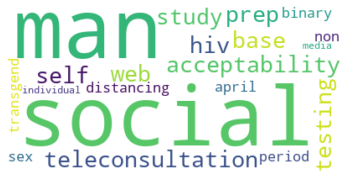


- More frequent words: social, man, acceptability

- Main topics in cluster:
PrEP teleconsultation and HIV self-testing
Similarity between keywords and proposed clusters: 0.18

Text 0: To understand the acceptability of PrEP teleconsultation and HIV self-testing, we conducted a web-based study during social distancing period (April–May, 2020) among men who have sex with men and transgender/non-binary individuals using social media
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


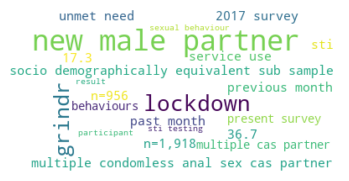


- More frequent chunks: new male partner, lockdown, grindr
WordCloud for chunks frequency in the cluster


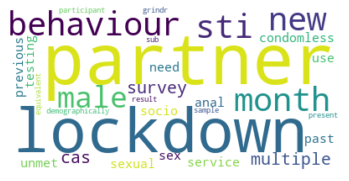


- More frequent words: partner, lockdown, month

- Main topics in cluster:
sexual behaviour and service use
Similarity between keywords and proposed clusters: 0.13

Text 1: We examined sexual behaviour and service use since lockdown (23/03/ 2020) and in the three previous months, and 'unmet need for STI testing' since lockdown (any new male partners and/or multiple condomless anal sex (CAS) partners without testing for STIs). We compared behaviours over the past three months between socio-demographically equivalent sub-samples recruited via Grindr into the present survey (N=956) and a 2017 survey (N=1,918). Results In 2020, 36.7% of participants reported new male partners and 17.3% reported multiple CAS partners since lockdown
***********************
*********************
Analysis of the label 'O'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


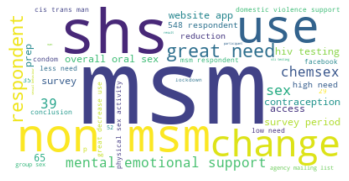


- More frequent chunks: msm, shs, use
WordCloud for chunks frequency in the cluster


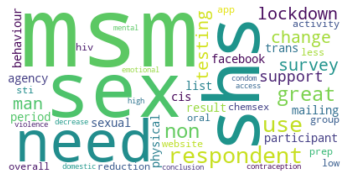


- More frequent words: msm, sex, shs

- Main topics in cluster:
HIV
Similarity between keywords and proposed clusters: 0.13

Text 2: Participants were recruited through Facebook, agency mailing lists and snowballing. Results: 548 respondents completed the survey, with 65% MSM (cis and trans men who have sex with men) and 35% non-MSM. Change in sexual behaviours: 39% of respondents reported not having sex during the survey period. MSM reported more likely to stop having sex (+17%, P < 0.01) and less likely to maintain physical sex activities (-14%, P < 0.01) than non-MSM. Overall oral sex reduced the greatest, with 52% reported having stopped completely. Reduction in use of a website/app to chat and hookup, engage with group sex, use PrEP, engage with chemsex and, have sex with casual partner(s) in public, were more evidenced among MSM respondents. Change in use of SHS: Generally, use of SHS decreased during lockdown. More MSM reported reduced or completely stopped HIV testing (+20%, P

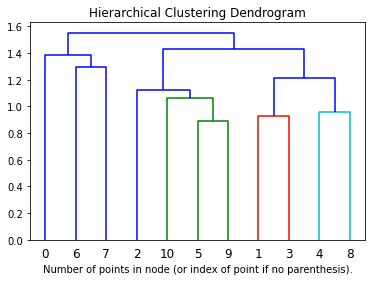

*********************
Analysis of the label 'M'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


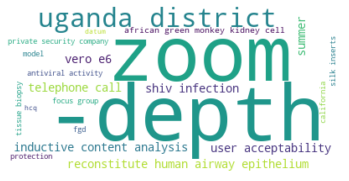


- More frequent chunks: zoom, -depth, uganda district
WordCloud for chunks frequency in the cluster


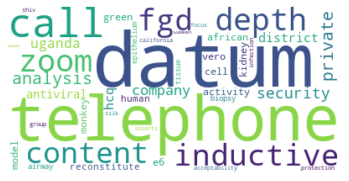


- More frequent words: datum, telephone, call

- Main topics in cluster:
Fourteen private security companies in two Uganda districts
Similarity between keywords and proposed clusters: 0.22

Text 0: Data were collected via telephone calls for in-depth interviews or Zoom for FGDs and manually analysed by inductive content analysis. Setting Fourteen private security companies in two Uganda districts
Text 6: HCQ showed antiviral activity in African green monkey kidney cells (Vero E6) but not in a model of reconstituted human airway epithelium
Text 7: Tissue biopsies were obtained and tested for protection against SHIV infection. To determine the user acceptability of silk inserts, we held four focus groups in California during summer 2020
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.1: 4
WordCloud for chunks according to Tf-Idf score:


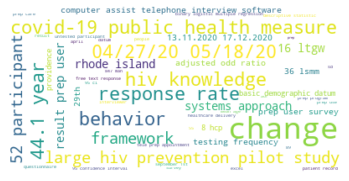


- More frequent chunks: change, covid-19 public health measure, 04/27/20 05/18/20
WordCloud for chunks frequency in the cluster


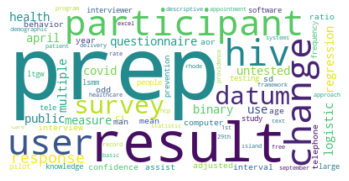


- More frequent words: prep, result, participant

- Main topics in cluster:
Free text responses
Similarity between keywords and proposed clusters: 0.29

Text 1: In April 2020, 847 HIVnegative and untested participants completed questionnaires assessing changes in PrEP use as a result of COVID-19 public health measures. Binary logistic multiple regression was used to estimate adjusted odds ratios (aOR) and 95% confidence intervals (95% CI) to compare changes in PrEP use behaviors. Results: Among 847 men, mean age was 44.1 years (SD: 12.7)
Text 3: Using a computer-assisted telephone interviewing software, one interviewer called 52 participants (randomly sampled from a larger HIV prevention pilot study aiming to increase HIV knowledge and testing frequency; n = 36 LSMM and n = 16 LTGW) between 04/27/20-05/18/20
Text 4: The PrEP-user survey was offered to people who had a tele-PrEP appointment between 13.11.2020-17.12.2020 and consented to participate. Basic demographic data was captured.

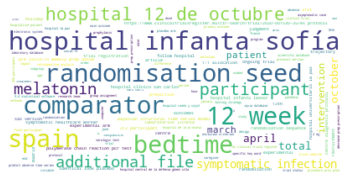


- More frequent chunks: hospital infanta sofía, randomisation seed, bedtime
WordCloud for chunks frequency in the cluster


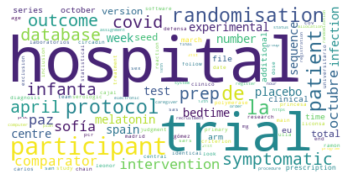


- More frequent words: hospital, participant, trial

- Main topics in cluster:
ongoing trials or articles published before October 2020
Similarity between keywords and proposed clusters: 0.34

Text 2: Patients that should not be included in the study at the judgment of the research team. Participants will be recruited from the following eight hospitals in Madrid, Spain: Hospital Universitario La Paz, Hospital Ramón y Cajal, Hospital Infanta Sofía, Hospital 12 de Octubre, Hospital Clínico San Carlos, Hospital Central de la defensa Gómez Ulla,Hospital de La Princesa and Hospital Infanta Leonor. Intervention and comparator: Experimental: Melatonin (Circadin®, Exeltis Healthcare, Spain): 2 mg of melatonin orally before bedtime for 12 weeks. Comparator: Identical looking placebo (Laboratorios Liconsa, Spain) orally before bedtime for 12 weeks. Main outcomes: Number of SARS-CoV-2 (COVID-19) symptomatic infections confirmed by polymerase chain reaction (PCR) test or serologic test or accordi

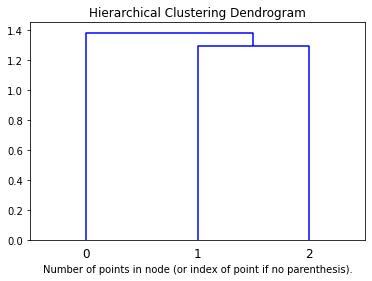

*********************
Analysis of the label 'M'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


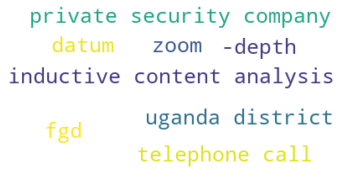


- More frequent chunks: inductive content analysis, -depth, fgd
WordCloud for chunks frequency in the cluster


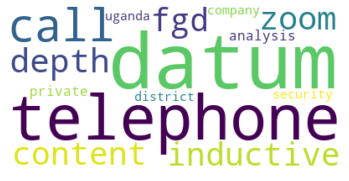


- More frequent words: datum, telephone, call

- Main topics in cluster:
Fourteen private security companies in two Uganda districts
Similarity between keywords and proposed clusters: 0.06

Text 0: Data were collected via telephone calls for in-depth interviews or Zoom for FGDs and manually analysed by inductive content analysis. Setting Fourteen private security companies in two Uganda districts
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


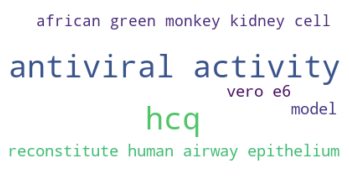


- More frequent chunks: antiviral activity, hcq, reconstitute human airway epithelium
WordCloud for chunks frequency in the cluster


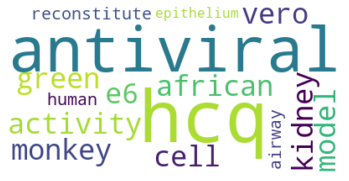


- More frequent words: hcq, antiviral, activity

- Main topics in cluster:
reconstituted human airway epithelium
Similarity between keywords and proposed clusters: 0.22

Text 1: HCQ showed antiviral activity in African green monkey kidney cells (Vero E6) but not in a model of reconstituted human airway epithelium
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


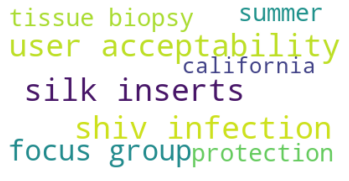


- More frequent chunks: user acceptability, silk inserts, shiv infection
WordCloud for chunks frequency in the cluster


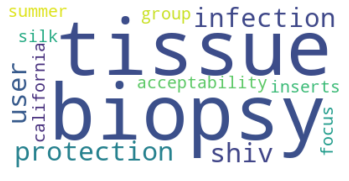


- More frequent words: tissue, biopsy, protection

- Main topics in cluster:
To determine the user acceptability of silk inserts, we held four focus groups
Similarity between keywords and proposed clusters: 0.12

Text 2: Tissue biopsies were obtained and tested for protection against SHIV infection. To determine the user acceptability of silk inserts, we held four focus groups in California during summer 2020
***********************
Sent is ['Data were collected via telephone calls for in-depth interviews or Zoom for FGDs and manually analysed by inductive content analysis. Setting Fourteen private security companies in two Uganda districts']
Hierarchical Clustering dendrogram for label M
Sent is ['HCQ showed antiviral activity in African green monkey kidney cells (Vero E6) but not in a model of reconstituted human airway epithelium']
Hierarchical Clustering dendrogram for label M
Sent is ['Tissue biopsies were obtained and tested for protection against SHIV infection. To determine th

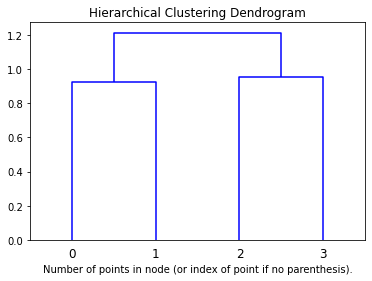

*********************
Analysis of the label 'M'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


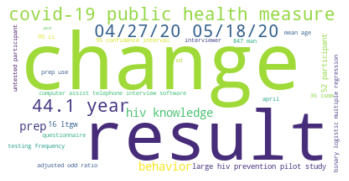


- More frequent chunks: change, result, covid-19 public health measure
WordCloud for chunks frequency in the cluster


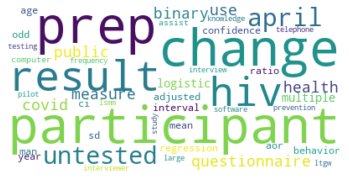


- More frequent words: participant, change, prep

- Main topics in cluster:
HIVnegative and untested participants completed questionnaires assessing changes in PrEP use
Similarity between keywords and proposed clusters: 0.3

Text 0: In April 2020, 847 HIVnegative and untested participants completed questionnaires assessing changes in PrEP use as a result of COVID-19 public health measures. Binary logistic multiple regression was used to estimate adjusted odds ratios (aOR) and 95% confidence intervals (95% CI) to compare changes in PrEP use behaviors. Results: Among 847 men, mean age was 44.1 years (SD: 12.7)
Text 1: Using a computer-assisted telephone interviewing software, one interviewer called 52 participants (randomly sampled from a larger HIV prevention pilot study aiming to increase HIV knowledge and testing frequency; n = 36 LSMM and n = 16 LTGW) between 04/27/20-05/18/20
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n

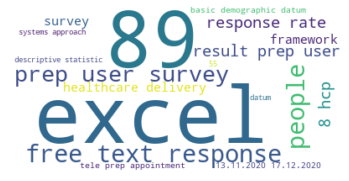


- More frequent chunks: excel, 89, free text response
WordCloud for chunks frequency in the cluster


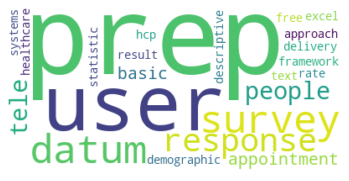


- More frequent words: prep, user, survey

- Main topics in cluster:
demographic
Similarity between keywords and proposed clusters: 0.16

Text 2: The PrEP-user survey was offered to people who had a tele-PrEP appointment between 13.11.2020-17.12.2020 and consented to participate. Basic demographic data was captured. Data were analysed in Excel using descriptive statistics. Free text responses were thematically categorised using the Framework for a Systems Approach to Healthcare Delivery. Results Sixty-two PrEP-users and 8 HCPs completed the surveys (response rate 55% and 89% respectively)
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


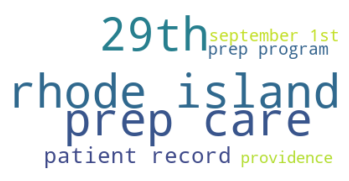


- More frequent chunks: rhode island, prep care, 29th
WordCloud for chunks frequency in the cluster


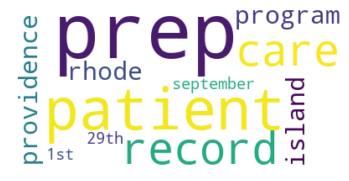


- More frequent words: prep, patient, record

- Main topics in cluster:
PrEP care
Similarity between keywords and proposed clusters: 0.19

Text 3: We reviewed all patient records for those who presented for PrEP care at a PrEP program in Providence, Rhode Island from September 1st, 2019 to May 29th, 2020
***********************
Sent is ['In April 2020, 847 HIVnegative and untested participants completed questionnaires assessing changes in PrEP use as a result of COVID-19 public health measures. Binary logistic multiple regression was used to estimate adjusted odds ratios (aOR) and 95% confidence intervals (95% CI) to compare changes in PrEP use behaviors. Results: Among 847 men, mean age was 44.1 years (SD: 12.7)', 'Using a computer-assisted telephone interviewing software, one interviewer called 52 participants (randomly sampled from a larger HIV prevention pilot study aiming to increase HIV knowledge and testing frequency; n = 36 LSMM and n = 16 LTGW) between 04/27/20-05/18/20']
Hie

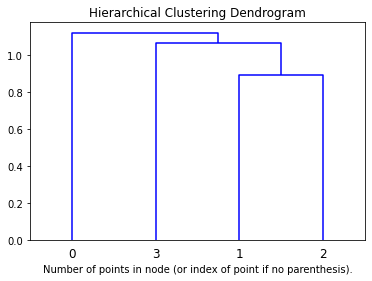

*********************
Analysis of the label 'M'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


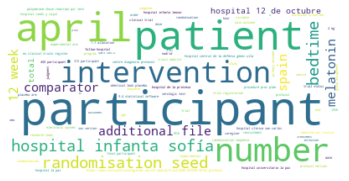


- More frequent chunks: participant, patient, april
WordCloud for chunks frequency in the cluster


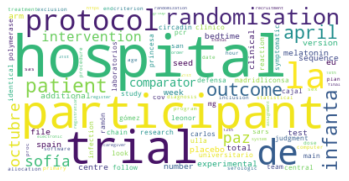


- More frequent words: hospital, participant, la

- Main topics in cluster:
symptomatic infections
Similarity between keywords and proposed clusters: 0.34

Text 0: Patients that should not be included in the study at the judgment of the research team. Participants will be recruited from the following eight hospitals in Madrid, Spain: Hospital Universitario La Paz, Hospital Ramón y Cajal, Hospital Infanta Sofía, Hospital 12 de Octubre, Hospital Clínico San Carlos, Hospital Central de la defensa Gómez Ulla,Hospital de La Princesa and Hospital Infanta Leonor. Intervention and comparator: Experimental: Melatonin (Circadin®, Exeltis Healthcare, Spain): 2 mg of melatonin orally before bedtime for 12 weeks. Comparator: Identical looking placebo (Laboratorios Liconsa, Spain) orally before bedtime for 12 weeks. Main outcomes: Number of SARS-CoV-2 (COVID-19) symptomatic infections confirmed by polymerase chain reaction (PCR) test or serologic test or according to each centre diagnosis protocol.

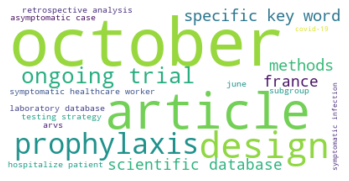


- More frequent chunks: october, article, design
WordCloud for chunks frequency in the cluster


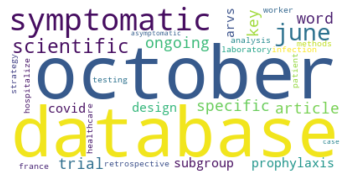


- More frequent words: october, database, symptomatic

- Main topics in cluster:
ongoing trials or articles
Similarity between keywords and proposed clusters: 0.59

Text 1: From June to October 2020, we searched scientific databases using specific key words to identify ongoing trials or articles published before October 2020 investigating any subgroups of ARVs for prophylaxis against COVID-19
Text 2: DESIGN: Retrospective analysis of a laboratory database. METHODS: COVID-19 testing strategy in France was centered on symptomatic infections, hospitalized patients and symptomatic healthcare workers while most asymptomatic cases were not confirmed
***********************
*********************
Analysis of the label 'M'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


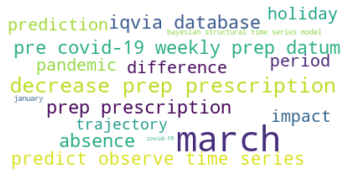


- More frequent chunks: march, decrease prep prescription, pre covid-19 weekly prep datum
WordCloud for chunks frequency in the cluster


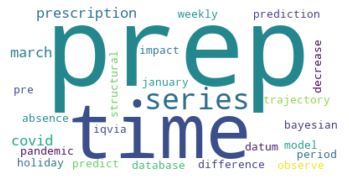


- More frequent words: prep, time, series

- Main topics in cluster:
the pandemic
Similarity between keywords and proposed clusters: 0.5

Text 3: We used a Bayesian structural time series model to predict the trajectory in PrEP prescriptions for the period of March 15-June 27, 2020 in the absence of the pandemic. The prediction was computed based on the pre-COVID-19 weekly PrEP data from January 1, 2017 to March 14, 2020 in the IQVIA database and adjusted for decreased PrEP prescriptions during holidays. The impact of COVID-19 was inferred by the differences between predicted and observed time series
***********************
Sent is ["Patients that should not be included in the study at the judgment of the research team. Participants will be recruited from the following eight hospitals in Madrid, Spain: Hospital Universitario La Paz, Hospital Ramón y Cajal, Hospital Infanta Sofía, Hospital 12 de Octubre, Hospital Clínico San Carlos, Hospital Central de la defensa Gómez Ulla,Hospital de

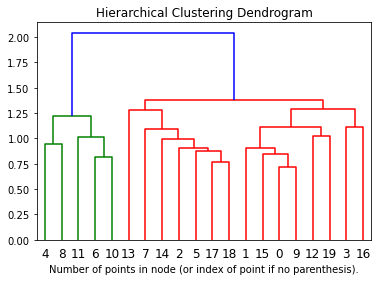

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 8
WordCloud for chunks according to Tf-Idf score:


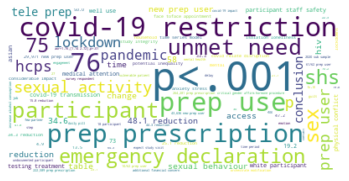


- More frequent chunks: p<.001, covid-19 restriction, 76
WordCloud for chunks frequency in the cluster


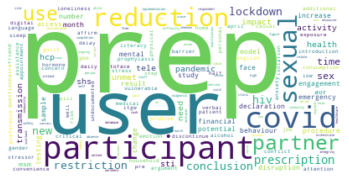


- More frequent words: prep, user, participant

- Main topics in cluster:
Isolation/loneliness (48%) and anxiety/stress
Similarity between keywords and proposed clusters: 0.41

Text 0: PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity
Text 1: Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consumption (

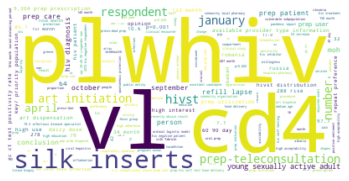


- More frequent chunks: plwhiv, cd4, vl
WordCloud for chunks frequency in the cluster


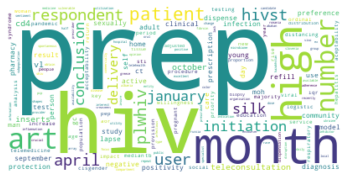


- More frequent words: prep, hiv, month

- Main topics in cluster:
young, sexually active adults
Similarity between keywords and proposed clusters: 0.16

Text 2: Out of the 2375 HIV negative respondents, 680 reported PrEP use and were included in this analysis. Median age was 33 years (IQR: 28–40), 98% cisgender men, 56% white, 74% high education, and 68% middle/high income. Willingness to use HIVST was 79% and 32% received an HIV self-testing during social distancing period. The majority reported preference for PrEP/HIV self-testing home delivery instead of collecting at the service. PrEP teleconsultation was experienced by 21% and most reported feeling satisfied with the procedures. High acceptability of PrEP teleconsultation was reported by 70%. In ordinal logistic model, having higher education was associated with high aceptability of PrEP teleconsultation (aOR:1.62; 95%CI: 1.07–2.45)
Text 5: Four months supplies provision and telemedicine resulted on 64% and 53% increase on PEP a

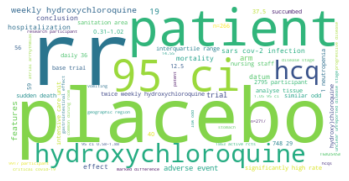


- More frequent chunks: rr, placebo, patient
WordCloud for chunks frequency in the cluster


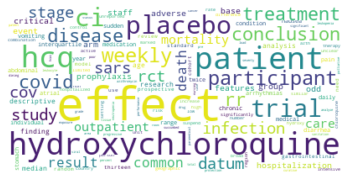


- More frequent words: effect, hydroxychloroquine, patient

- Main topics in cluster:
serious side effects were rare
Similarity between keywords and proposed clusters: 0.1

Text 4: We report descriptive analyses of our findings. Results: We enrolled 2795 participants. The median age of research participants (interquartile range) was 40 (34-49) years, and 59% (1633/2767) reported no chronic medical conditions. Overall 2544 (91%) participants reported side effect data, and 748 (29%) reported at least 1 medication side effect. Side effects were reported in 40% with once-daily, 36% with twice-weekly, 31% with once-weekly hydroxychloroquine, compared with 19% with placebo. The most common side effects were upset stomach or nausea (25% with once-daily, 19% with twice-weekly, and 18% with once-weekly hydroxychloroquine, vs 11% for placebo), followed by diarrhea, vomiting, or abdominal pain (23% for once-daily, 17% twice-weekly, and 13% once-weekly hydroxychloroquine, vs 7% for placebo). Two 

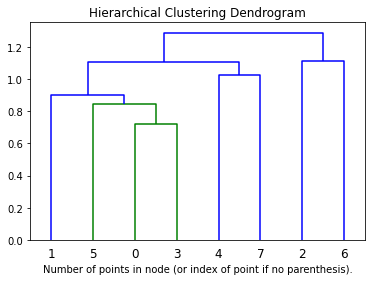

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 6
WordCloud for chunks according to Tf-Idf score:


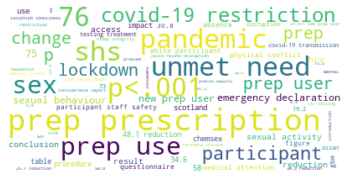


- More frequent chunks: prep prescription, 76, pandemic
WordCloud for chunks frequency in the cluster


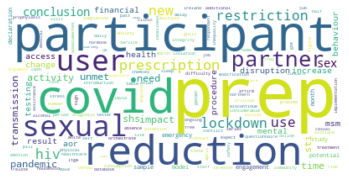


- More frequent words: prep, participant, reduction

- Main topics in cluster:
less likely to report sex with casual partners
Similarity between keywords and proposed clusters: 0.41

Text 0: PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity
Text 1: Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consump

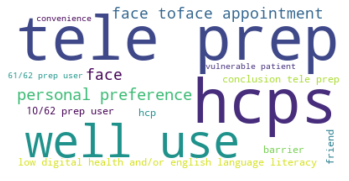


- More frequent chunks: tele prep, hcps, well use
WordCloud for chunks frequency in the cluster


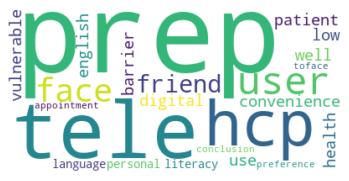


- More frequent words: prep, tele, user

- Main topics in cluster:
health and/or English-language literacy
Similarity between keywords and proposed clusters: 0.13

Text 2: Tele-PrEP was rated 'excellent' or 'good' by 61/62 PrEP-users, and 59/62 would recommend it to friends. HCPs also rated its convenience highly and felt it enabled better use of limited face-to-face clinic capacity. However, HCPs thought that tele-PrEP might create barriers for vulnerable patients, particularly those with low digital, health and/or English-language literacy. One HCP and 10/62 PrEP-users expressed a personal preference for face-toface appointments. Conclusion Tele-PrEP is feasible and acceptable
***********************
*********************
Analysis of the label 'R'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


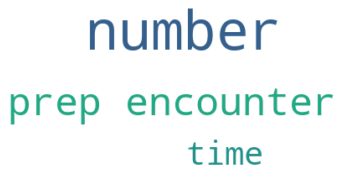


- More frequent chunks: number, prep encounter, time
WordCloud for chunks frequency in the cluster


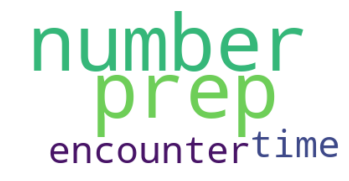


- More frequent words: number, prep, encounter

- Main topics in cluster:
PrEP
Similarity between keywords and proposed clusters: 0.15

Text 6: The number of PrEP encounters decreased but was not significantly different over time (ps > .05)
***********************
Sent is ['PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity', 'Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated wit

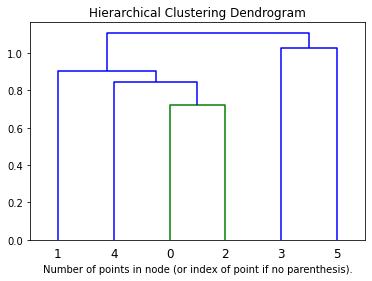

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 4
WordCloud for chunks according to Tf-Idf score:


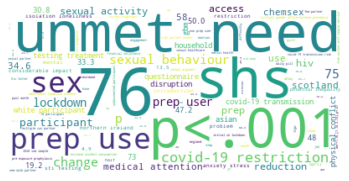


- More frequent chunks: 76, unmet need, shs
WordCloud for chunks frequency in the cluster


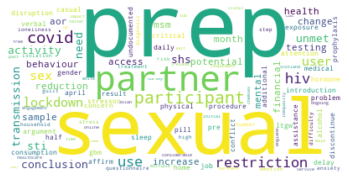


- More frequent words: prep, sexual, partner

- Main topics in cluster:
less likely to report sex with casual partners
Similarity between keywords and proposed clusters: 0.41

Text 0: PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity
Text 1: Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consumption (2

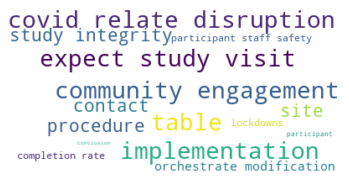


- More frequent chunks: covid relate disruption, implementation, expect study visit
WordCloud for chunks frequency in the cluster


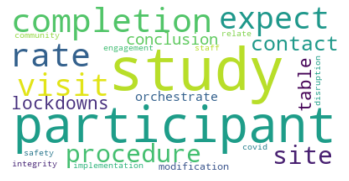


- More frequent words: study, participant, completion

- Main topics in cluster:
Conclusions
Similarity between keywords and proposed clusters: 0.34

Text 3: Completion rates for expected study visits and procedures were high. Sites maintained contact with most participants despite lockdowns (Table 1). Conclusions: Well-orchestrated modifications to study implementation ensured participant and staff safety, and maintained study integrity and community engagement during COVID-related disruptions
***********************
*********************
Analysis of the label 'R'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


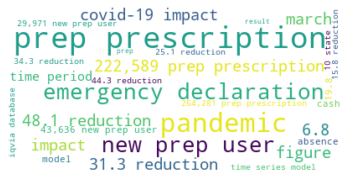


- More frequent chunks: prep prescription, pandemic, emergency declaration
WordCloud for chunks frequency in the cluster


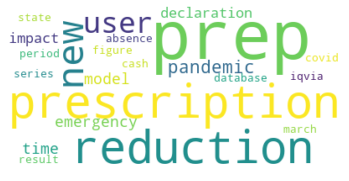


- More frequent words: prep, prescription, reduction

- Main topics in cluster:
emergency declaration
Similarity between keywords and proposed clusters: 0.42

Text 5: Results: In the absence of the pandemic, our time series model predicted that there would have been 264,281 PrEP prescriptions during March 15-June 27, 2020 and we observed 222,589 PrEP prescriptions in the IQVIA database, a 15.8% reduction after the emergency declaration (Figure). The model predicted 43,636 new PrEP users during the same time period and we observed 29,971 new PrEP users, a 31.3% reduction after the emergency declaration. The impact of the pandemic on PrEP prescriptions was greater for those who paid for PrEP with cash (34.3% reduction in PrEP prescriptions; 44.3% reduction in new PrEP users). The COVID-19 impact varied among the 10 states with the most PrEP prescriptions prior to the pandemic, ranging from 6.8% to 25.1% reductions in PrEP prescriptions and 19.8% to 48.1% reductions in new PrEP users
***

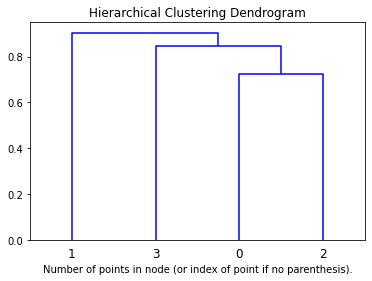

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


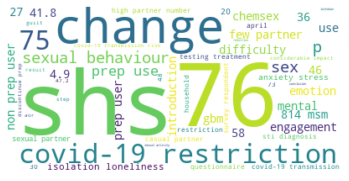


- More frequent chunks: 76, shs, change
WordCloud for chunks frequency in the cluster


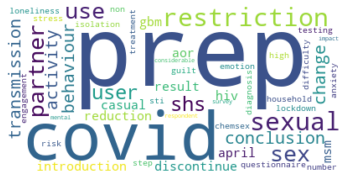


- More frequent words: prep, covid-19, restriction

- Main topics in cluster:
Isolation/loneliness (48%) and anxiety/stress
Similarity between keywords and proposed clusters: 0.43

Text 0: PrEP use rose from 4.9% in 2015 to 47.2% in 2020. Among those, 41.8% (n = 167) discontinued PrEP use during COVID-19 restrictions. Discontinuing PrEP during COVID-19 restrictions was independently associated with being less likely to have recently tested for HIV (aOR: 0.17; 95% CI: 0.09 to 0.34; P , 0.001) and less likely to report sex with casual partners (aOR: 0.28; 95% CI: 0.14 to 0.54; P , 0.001). Conclusions: By April 2020, following the introduction of COVID-19 restrictions, GBM dramatically reduced PrEP use, coinciding with a reduction in sexual activity
Text 2: Results: 814 MSM completed the questionnaire: 75% were PrEP users; 76% reported they have been sexually active, of which 76% reported sex outside their household. 75% reported fewer partners than prior to lockdown. Isolation/lonelines

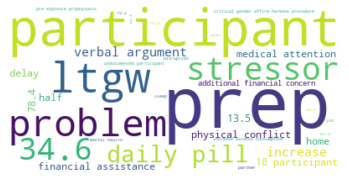


- More frequent chunks: prep, participant, ltgw
WordCloud for chunks frequency in the cluster


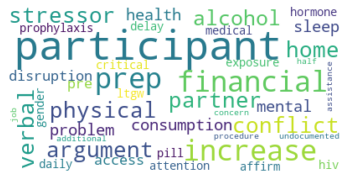


- More frequent words: participant, increase, prep

- Main topics in cluster:
increases in physical conflict or verbal arguments
Similarity between keywords and proposed clusters: 0.22

Text 1: Participants reported increases in physical conflict or verbal arguments with a partner (13.5%) or other adult(s) (19.2%) due to stressors associated with the safer-at-home order. Participants also reported increased alcohol consumption (23.1%), problems with sleep (67.3%) and mental health (78.4%). Further, disruptions in access to Pre-Exposure Prophylaxis or PrEP–a daily pill to prevent HIV–occurred (33.3% of 18 participants who reported being on PrEP). Many said they received less medical attention than usual (34.6%), and LTGW reported delays in critical gender-affirming hormones/procedures. Half of the participants lost their jobs (50.0%); many undocumented participants relayed additional financial concerns because they did not qualify for financial assistance
***********************
******

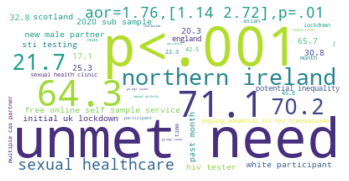


- More frequent chunks: unmet need, p<.001, 71.1
WordCloud for chunks frequency in the cluster


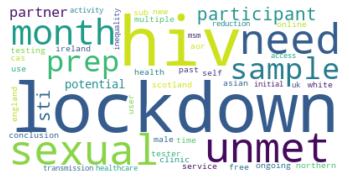


- More frequent words: lockdown, hiv, sexual

- Main topics in cluster:
living with HIV
Similarity between keywords and proposed clusters: 0.24

Text 3: Comparing time since lockdown vs previous three months, HIV testers were less likely to test at sexual health clinics (22.3% vs 70.2%) and more likely to use free online self-sampling services (64.3% vs 17.1%), and PrEP users were less likely to report PrEP use (21.7% vs 65.7%). Since lockdown, 25.3% of participants had unmet need for STI testing. Unmet need was more likely among Asian vs White participants (aOR=1.76,[1.14-2.72],p=.01); living in Scotland (aOR=2.02,[1.40-2.91],p<.001) or Northern Ireland (aOR=1.93,[1.02-3.63],p=.04) vs England; and living with HIV (aOR=1.83,[1.32-2.53],p<.001). Compared to 2017, the 2020 sub-sample were less likely to report new male partners (46.8% vs 71.1%, p<.001), multiple CAS partners (20.3% vs 30.8%, p<.001) and unmet need (32.8% vs 42.5%, p<.001) in the past three months. Conclusion We found on

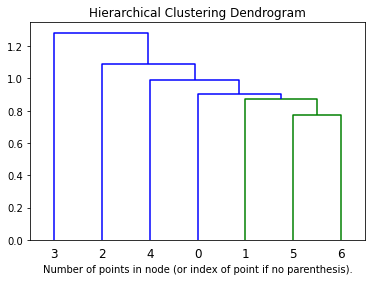

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 5
WordCloud for chunks according to Tf-Idf score:


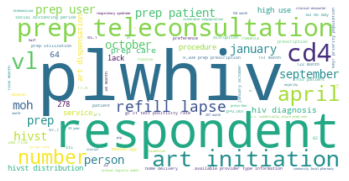


- More frequent chunks: plwhiv, respondent, prep teleconsultation
WordCloud for chunks frequency in the cluster


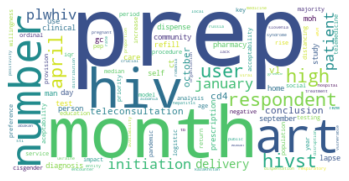


- More frequent words: prep, month, hiv

- Main topics in cluster:
immunossupressed, or hospitalized due to respiratory syndrome
Similarity between keywords and proposed clusters: 0.16

Text 0: Out of the 2375 HIV negative respondents, 680 reported PrEP use and were included in this analysis. Median age was 33 years (IQR: 28–40), 98% cisgender men, 56% white, 74% high education, and 68% middle/high income. Willingness to use HIVST was 79% and 32% received an HIV self-testing during social distancing period. The majority reported preference for PrEP/HIV self-testing home delivery instead of collecting at the service. PrEP teleconsultation was experienced by 21% and most reported feeling satisfied with the procedures. High acceptability of PrEP teleconsultation was reported by 70%. In ordinal logistic model, having higher education was associated with high aceptability of PrEP teleconsultation (aOR:1.62; 95%CI: 1.07–2.45)
Text 1: Four months supplies provision and telemedicine resulted 

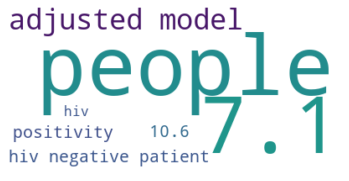


- More frequent chunks: people, 7.1, adjusted model
WordCloud for chunks frequency in the cluster


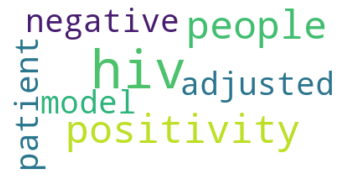


- More frequent words: hiv, positivity, people

- Main topics in cluster:
HIV
Similarity between keywords and proposed clusters: 0.26

Text 2: Positivity was higher among people with HIV (10.6%) compared with HIV-negative patients (7.1%) but was not significant in adjusted models
***********************
*********************
Analysis of the label 'R'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


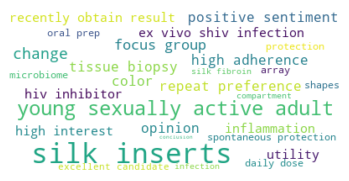


- More frequent chunks: silk inserts, young sexually active adult, change
WordCloud for chunks frequency in the cluster


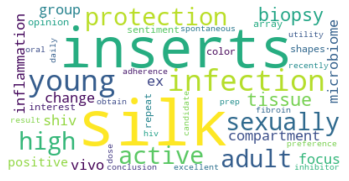


- More frequent words: silk, inserts, infection

- Main topics in cluster:
In focus groups
Similarity between keywords and proposed clusters: 0.14

Text 3: Tissue biopsies from both compartments were fully protected against ex vivo SHIV infection, with neither inflammation nor change in microbiome. In focus groups, young, sexually active adults uniformly expressed positive sentiments and high interest when presented with silk inserts in an array of shapes and colors. These opinions included repeated preference for silk inserts over oral PrEP, due to the utility of silk inserts as spontaneous protection that did not require daily dosing. Conclusions: Together, these recently obtained results show that silk fibroin is an excellent candidate for formulating HIV inhibitors, being both highly effective in preventing infection and also attractive to young, sexually active adults, which may lead to higher adherence and protection
***********************
Sent is ['Out of the 2375 HIV negative

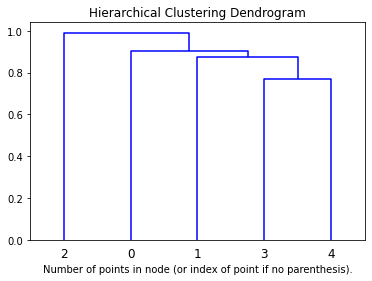

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


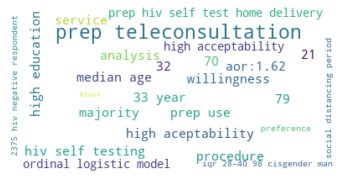


- More frequent chunks: prep teleconsultation, hiv self testing, willingness
WordCloud for chunks frequency in the cluster


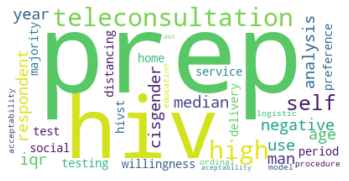


- More frequent words: prep, hiv, teleconsultation

- Main topics in cluster:
HIV
Similarity between keywords and proposed clusters: 0.18

Text 0: Out of the 2375 HIV negative respondents, 680 reported PrEP use and were included in this analysis. Median age was 33 years (IQR: 28–40), 98% cisgender men, 56% white, 74% high education, and 68% middle/high income. Willingness to use HIVST was 79% and 32% received an HIV self-testing during social distancing period. The majority reported preference for PrEP/HIV self-testing home delivery instead of collecting at the service. PrEP teleconsultation was experienced by 21% and most reported feeling satisfied with the procedures. High acceptability of PrEP teleconsultation was reported by 70%. In ordinal logistic model, having higher education was associated with high aceptability of PrEP teleconsultation (aOR:1.62; 95%CI: 1.07–2.45)
***********************
*********************
Analysis of the label 'R'

- Number of elements per cluster n.1: 3

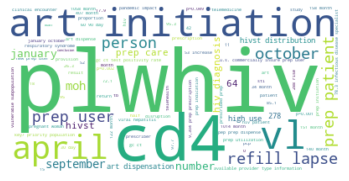


- More frequent chunks: plwhiv, cd4, art initiation
WordCloud for chunks frequency in the cluster


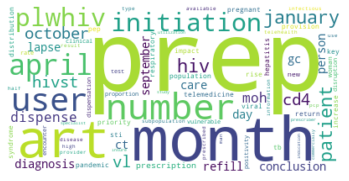


- More frequent words: prep, month, art

- Main topics in cluster:
infectious-disease
Similarity between keywords and proposed clusters: 0.21

Text 1: Four months supplies provision and telemedicine resulted on 64% and 53% increase on PEP and PrEP dispenses and 288% rise on new PrEP users in October, when compared to April. The number of HIVST distributed by MoH and PLWHIV who had the first CD4 and VL before ART initiation dropped 35% and 48%, respectively, when comparing April to January 2020, reflecting the pandemic impact on HIV diagnosis. In return, MoH recommended HIVST for key/ priority populations, pregnant women, patients with TB, STI, viral hepatitis, immunossupressed, or hospitalized due to respiratory syndrome. When comparing to April, HIVST distribution raised 95% in October and the number of PLWHIV who had the first CD4 and VL before ART initiation was 56% higher, in September. When comparing 2020 to 2019, the number of PLWHIV who started ART and those that had the first 

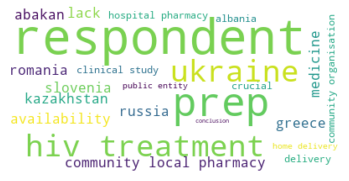


- More frequent chunks: respondent, prep, hiv treatment
WordCloud for chunks frequency in the cluster


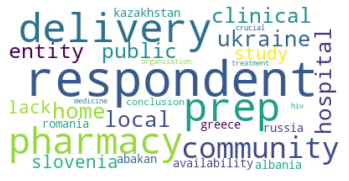


- More frequent words: respondent, delivery, prep

- Main topics in cluster:
Respondents noted that PrEP
Similarity between keywords and proposed clusters: 0.25

Text 2: In Ukraine, most respondents report home delivery is possible. Respondents noted that PrEP, where available, is delivered at hospital pharmacies (7/22), at community/local pharmacies (8/22), public entity (1/22) and 1/22 as part of a clinical study (Slovenia). Several respondents reported a lack of availability of PrEP (Romania, Greece, Albania, Kazakhstan and Abakan (Russia)). Conclusions: Community organisations can be seen to be playing a crucial part in HIV treatment through assisting with delivery of medicines
***********************
Sent is ['Out of the 2375 HIV negative respondents, 680 reported PrEP use and were included in this analysis. Median age was 33 years (IQR: 28–40), 98% cisgender men, 56% white, 74% high education, and 68% middle/high income. Willingness to use HIVST was 79% and 32% received an HIV s

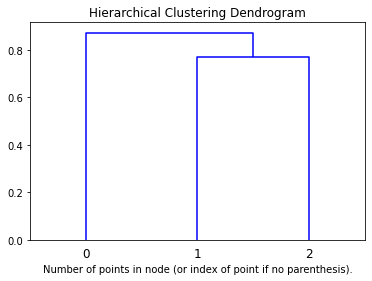

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


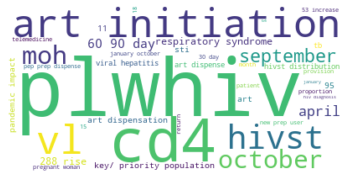


- More frequent chunks: plwhiv, cd4, art initiation
WordCloud for chunks frequency in the cluster


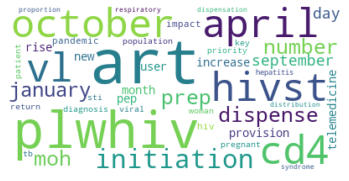


- More frequent words: art, plwhiv, october

- Main topics in cluster:
key/ priority populations
Similarity between keywords and proposed clusters: 0.21

Text 0: Four months supplies provision and telemedicine resulted on 64% and 53% increase on PEP and PrEP dispenses and 288% rise on new PrEP users in October, when compared to April. The number of HIVST distributed by MoH and PLWHIV who had the first CD4 and VL before ART initiation dropped 35% and 48%, respectively, when comparing April to January 2020, reflecting the pandemic impact on HIV diagnosis. In return, MoH recommended HIVST for key/ priority populations, pregnant women, patients with TB, STI, viral hepatitis, immunossupressed, or hospitalized due to respiratory syndrome. When comparing to April, HIVST distribution raised 95% in October and the number of PLWHIV who had the first CD4 and VL before ART initiation was 56% higher, in September. When comparing 2020 to 2019, the number of PLWHIV who started ART and those that had

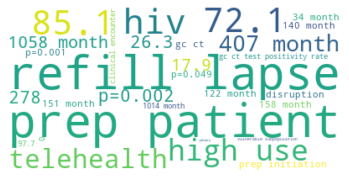


- More frequent chunks: refill lapse, prep patient, 72.1
WordCloud for chunks frequency in the cluster


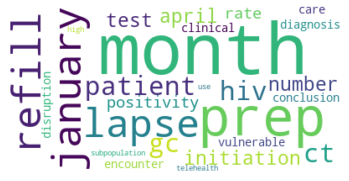


- More frequent words: month, prep, january

- Main topics in cluster:
GC/CT and HIV
Similarity between keywords and proposed clusters: 0.44

Text 1: From January to April, PrEP initiations decreased by 72.1% (122/month to 34/month), refill lapses increased by 278% (140/month to 407/month), and the number of PrEP patients decreased by 17.9% (Figure 1). GC/CT and HIV tests each decreased by 85.1% (1058/month to 158/month for GC/CT and 1014/month to 151/month for HIV), while GC/CT test positivity rates increased slightly (12.3% to 15.8%; Figure 2); the only HIV diagnosis among PrEP patients was in January. Clinical encounters decreased by 26.3% (1419 to 1046) and transitioned from 0% to 97.7% telehealth. Refill lapses were associated with being ≤26y (p=0.001), non-white (p=0.001), Latinx (p=0.049), and publically insured (p=0.002). Conclusions: COVID-19 was associated with disruptions in PrEP care, especially among vulnerable subpopulations, despite high use of telehealth
**************

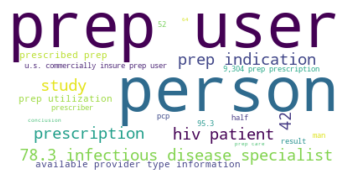


- More frequent chunks: prep user, person, 78.3 infectious disease specialist
WordCloud for chunks frequency in the cluster


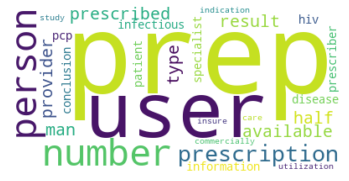


- More frequent words: prep, user, number

- Main topics in cluster:
infectious-disease
Similarity between keywords and proposed clusters: 0.24

Text 2: Results: The number of persons prescribed PrEP increased 37-fold from 865 in 2012 to 32,102 in 2018 (P<0.01). Most PrEP users were men (95.3%) and half were aged 18-34 years (52%). In 2018, among 9,304 PrEP prescriptions with available provider type information, PCPs prescribed 78.3% and infectious-disease specialists prescribed 6%. Most of the PrEP users (64%) received prescriptions from the 42% of prescribers who had also seen an HIV patient. Conclusions: Although the number of U.S. commercially-insured PrEP users increased substantially, the PrEP utilization derived from our study indicates that many persons with a PrEP indication still do not receive PrEP care
***********************
Sent is ['Four months supplies provision and telemedicine resulted on 64% and 53% increase on PEP and PrEP dispenses and 288% rise on new PrEP users 

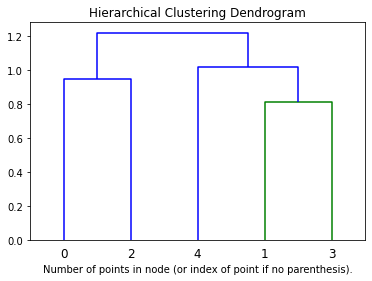

*********************
Analysis of the label 'R'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


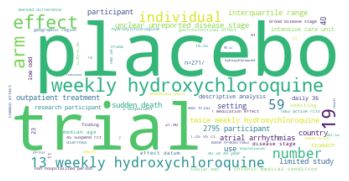


- More frequent chunks: placebo, trial, weekly hydroxychloroquine
WordCloud for chunks frequency in the cluster


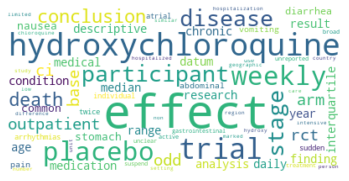


- More frequent words: effect, hydroxychloroquine, trial

- Main topics in cluster:
serious side effects were rare
Similarity between keywords and proposed clusters: 0.1

Text 0: We report descriptive analyses of our findings. Results: We enrolled 2795 participants. The median age of research participants (interquartile range) was 40 (34-49) years, and 59% (1633/2767) reported no chronic medical conditions. Overall 2544 (91%) participants reported side effect data, and 748 (29%) reported at least 1 medication side effect. Side effects were reported in 40% with once-daily, 36% with twice-weekly, 31% with once-weekly hydroxychloroquine, compared with 19% with placebo. The most common side effects were upset stomach or nausea (25% with once-daily, 19% with twice-weekly, and 18% with once-weekly hydroxychloroquine, vs 11% for placebo), followed by diarrhea, vomiting, or abdominal pain (23% for once-daily, 17% twice-weekly, and 13% once-weekly hydroxychloroquine, vs 7% for placebo). Two in

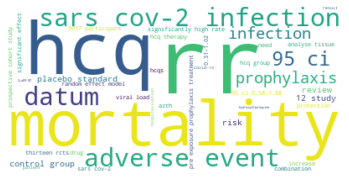


- More frequent chunks: rr, hcq, mortality
WordCloud for chunks frequency in the cluster


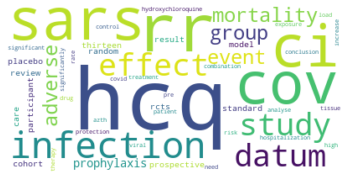


- More frequent words: hcq, rr, 95

- Main topics in cluster:
Results
Similarity between keywords and proposed clusters: 0.37

Text 1: Thirteen RCTs and three prospective cohort studies were included in this review. We pooled data using a random-effect model. Results: Pooled data from 12 studies (9917 participants) showed that HCQs increase mortality as compared to placebo/standard of care (RR 1.10; 95% CI:1.00–1.20). Hydroxychloroquine did not reduce the need for hospitalization in out-patients (RR 0.57; 95% CI 0.31–1.02). HCQ group has a significantly higher rate of any adverse event (RR 2.68; 95% CI 1.55–4.64), as compared to the control group. Also, using HCQ for prophylaxis against SARS-CoV-2 infection did not reduce the risk of acquiring SARS-CoV-2 infection (RR 1.04; 95% CI 0.58–1.88). Conclusions: HCQ therapy for COVID-19 is associated with an increase in mortality and other adverse events
Text 3: Neither HCQ nor the combination of HCQ and AZTH showed a significant effect on v

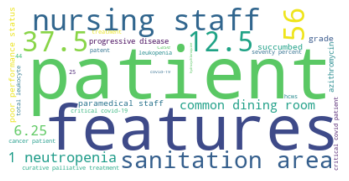


- More frequent chunks: patient, features, nursing staff
WordCloud for chunks frequency in the cluster


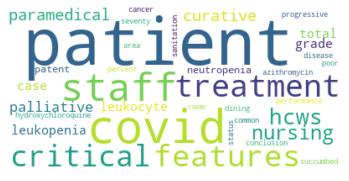


- More frequent words: patient, staff, treatment

- Main topics in cluster:
Grades 4, 3, 2, and 1 neutropenia
Similarity between keywords and proposed clusters: 0.41

Text 4: Among HCWs, two nursing staff and three paramedical staff contracted asymptomatic COVID-19. Eighteen (56%) and 14 (44%) patients were on curative and palliative treatment, respectively. Leukopenia (total leukocyte count <4,000/μL) was seen in 37.5% of cases. Grades 4, 3, 2, and 1 neutropenia were present in 12.5% of patents. Two (6.25%) patients had features of critical COVID-19. Eight (25%) patients received treatment with hydroxychloroquine + azithromycin. Five patients died. Three patients had features of progressive disease with poor performance status. One critical COVID patient survived and one succumbed to COVID-19. Patients shared a common dining room, sanitation area. Conclusion: Seventy percent of cancer patients were asymptomatic
***********************
Sent is ['We report descriptive analyses of our f

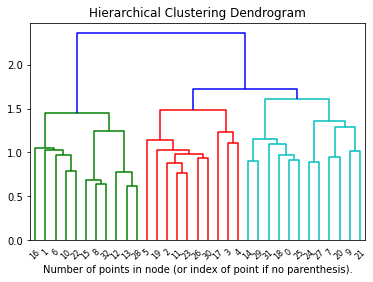

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 12
WordCloud for chunks according to Tf-Idf score:


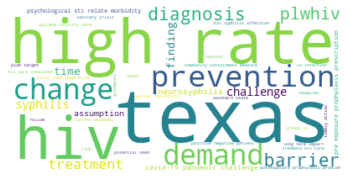


- More frequent chunks: texas, high rate, hiv
WordCloud for chunks frequency in the cluster


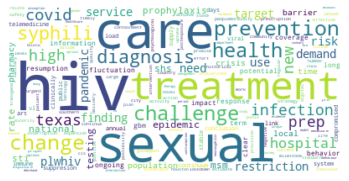


- More frequent words: hiv, sexual, care

- Main topics in cluster:
New models for testing and prevention
Similarity between keywords and proposed clusters: 0.38

Text 0: Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions
Text 7: The use of telemedicine, annual VL for those clinically stables, and 90-days ART supply held link to public health services and viral load suppresion. Conclusion: PLWHIV are vulnerable during COVID-19 pandemic due to compromised immune system or care continuum interruption by community containment measures. Monitoring of HIV care indicators associated to timely actions is an effective way to overcome COVID-19 pandemic challenges and guarantee prope

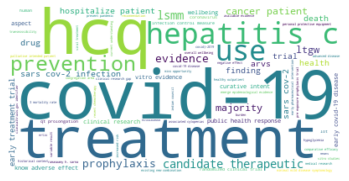


- More frequent chunks: covid-19, hcq, treatment
WordCloud for chunks frequency in the cluster


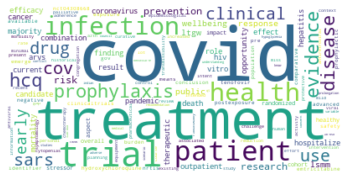


- More frequent words: covid-19, treatment, trial

- Main topics in cluster:
N-95, personal protective equipment, and adherence to infection control measures
Similarity between keywords and proposed clusters: 0.43

Text 1: Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing
Text 6: Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial
Text 8: The negative effects are more pronounced in hospitalized patients. Therefore, with the available evidence, HCQ should not be used in prophylaxis or treatment of patients with COVID-19
Text 10: Focus on

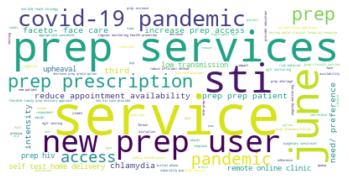


- More frequent chunks: service, prep services, june
WordCloud for chunks frequency in the cluster


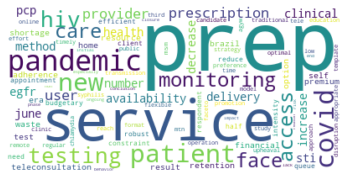


- More frequent words: prep, service, pandemic

- Main topics in cluster:
PrEP teleconsultation and PrEP/HIV self-testing
Similarity between keywords and proposed clusters: 0.32

Text 2: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
Text 3: Whilst it is vital that eGFR testing is not missed, over-testing wastes clinical and financial resources which are at a premium in an era of budgetary constraints and reduced appointment availability due to COVID- 19. As the number of clients taking PrEP increases, it is important for all services to ensure robust and efficient methods of eGFR monitoring.
Text 4: and mandatory pre-registration (to avoid queues), we were able to successfully saved services, and increase the intensity of testing and staging to PrEP for MSM compared to the first ha

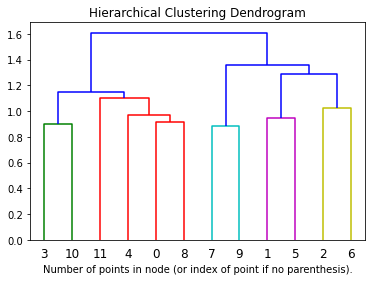

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 6
WordCloud for chunks according to Tf-Idf score:


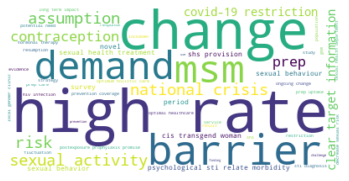


- More frequent chunks: high rate, change, barrier
WordCloud for chunks frequency in the cluster


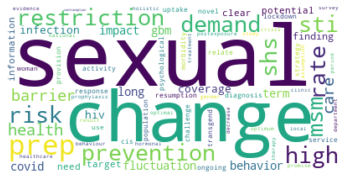


- More frequent words: sexual, change, prep

- Main topics in cluster:
resumption of PrEP and on-demand optimal dosing regimens
Similarity between keywords and proposed clusters: 0.3

Text 0: Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions
Text 3: High rates of sexual activity and STI diagnoses were reported during lockdown. Changes to SHS provision for MSM must respond to high rates of psychological and STI-related morbidity and the challenges faced by this population in accessing services
Text 4: Use of on-demand PrEP is increasing among MSM in the US. Strategies are needed to address barriers to PrEP uptake and persistence among cis-and transgender women. Several nove

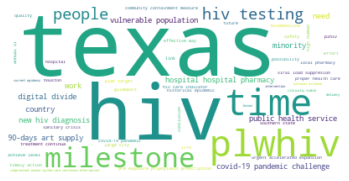


- More frequent chunks: texas, hiv, plwhiv
WordCloud for chunks frequency in the cluster


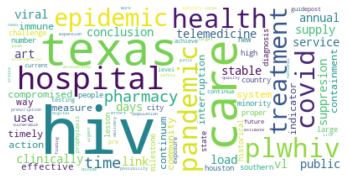


- More frequent words: hiv, care, texas

- Main topics in cluster:
annual VL for those clinically stables, and 90-days ART supply
Similarity between keywords and proposed clusters: 0.3

Text 1: The use of telemedicine, annual VL for those clinically stables, and 90-days ART supply held link to public health services and viral load suppresion. Conclusion: PLWHIV are vulnerable during COVID-19 pandemic due to compromised immune system or care continuum interruption by community containment measures. Monitoring of HIV care indicators associated to timely actions is an effective way to overcome COVID-19 pandemic challenges and guarantee proper health care for PLWHIV
Text 2: Texas is a Southern state that has one of the highest numbers of new HIV diagnoses and people with HIV in the country, and where HIV disproportionately impacts minorities. We retrace the historical epidemic in its largest city, Houston, to illustrate the lessons learned and milestones accomplished, which could serve as

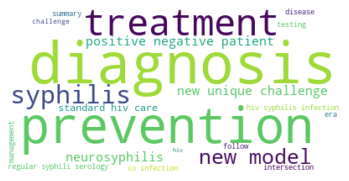


- More frequent chunks: diagnosis, prevention, treatment
WordCloud for chunks frequency in the cluster


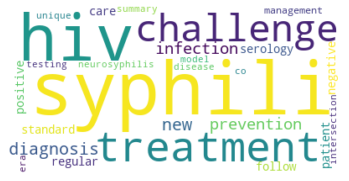


- More frequent words: hiv, syphilis, treatment

- Main topics in cluster:
Challenges remain in the diagnosis and management of neurosyphilis
Similarity between keywords and proposed clusters: 0.32

Text 7: Standard HIV care should include regular syphilis serology.Treatment and serological follow-up of syphilis in HIV positive and negative patients can be conducted similarly. Challenges remain in the diagnosis and management of neurosyphilis. New models for testing and prevention will be crucial next steps in controlling co-infection. Summary: The intersection of HIV and syphilis infections continues to pose new and unique challenges in diagnosis, treatment, and prevention
Text 9: Now in the era of COVID-19, syphilis has yet another disease to imitate
***********************
Sent is ['Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings in

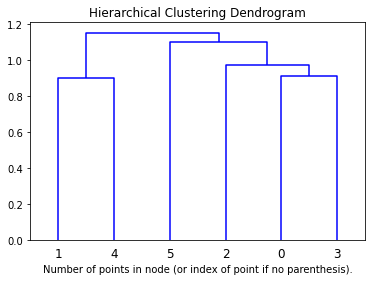

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


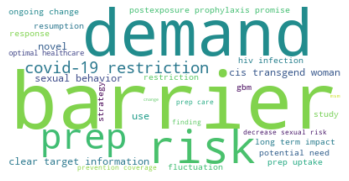


- More frequent chunks: barrier, demand, risk
WordCloud for chunks frequency in the cluster


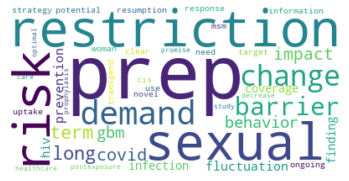


- More frequent words: prep, restriction, sexual

- Main topics in cluster:
resumption of PrEP and on-demand optimal dosing regimens
Similarity between keywords and proposed clusters: 0.31

Text 0: Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions
Text 2: Use of on-demand PrEP is increasing among MSM in the US. Strategies are needed to address barriers to PrEP uptake and persistence among cis-and transgender women. Several novel regimens for postexposure prophylaxis show promise
Text 3: Studies to understand whether changes in PrEP care reflect decreased sexual risk or barriers to optimal healthcare are needed
***********************
*********************
Analysis of the l

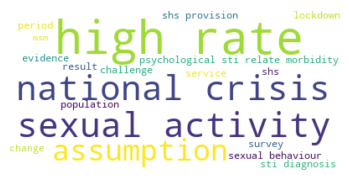


- More frequent chunks: high rate, sexual activity, national crisis
WordCloud for chunks frequency in the cluster


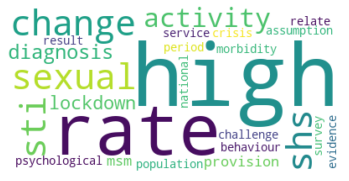


- More frequent words: high, rate, sexual

- Main topics in cluster:
high rates of psychological and STI-related morbidity
Similarity between keywords and proposed clusters: 0.15

Text 1: High rates of sexual activity and STI diagnoses were reported during lockdown. Changes to SHS provision for MSM must respond to high rates of psychological and STI-related morbidity and the challenges faced by this population in accessing services
Text 4: The results proved many of the assumptions in changes in sexual behaviour and sexual health needs during the period. The survey also provided some evidence for structuring SHS under a national crisis
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


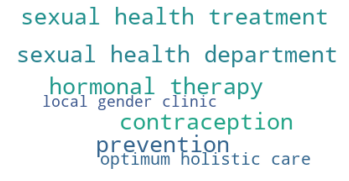


- More frequent chunks: sexual health department, sexual health treatment, contraception
WordCloud for chunks frequency in the cluster


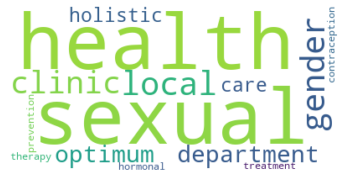


- More frequent words: sexual, health, local

- Main topics in cluster:
sexual health treatment and prevention and contraception
Similarity between keywords and proposed clusters: 0.11

Text 5: The local gender clinic being in our sexual health department ensures optimum holistic care for not just hormonal therapy but also sexual health treatment and prevention and contraception
***********************
Sent is ['Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions', 'Use of on-demand PrEP is increasing among MSM in the US. Strategies are needed to address barriers to PrEP uptake and persistence among cis-and transgender women. Several novel regimens for postexposure prophylax

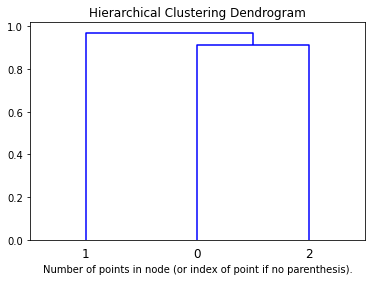

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


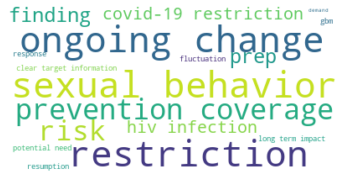


- More frequent chunks: sexual behavior, ongoing change, restriction
WordCloud for chunks frequency in the cluster


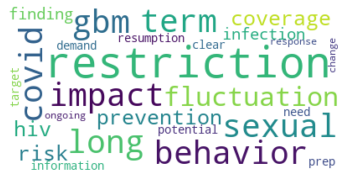


- More frequent words: restriction, long, term

- Main topics in cluster:
resumption of PrEP and on-demand optimal dosing regimens
Similarity between keywords and proposed clusters: 0.39

Text 0: Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


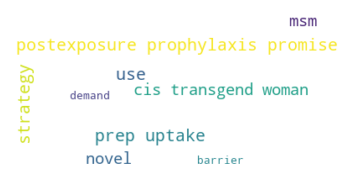


- More frequent chunks: postexposure prophylaxis promise, use, prep uptake
WordCloud for chunks frequency in the cluster


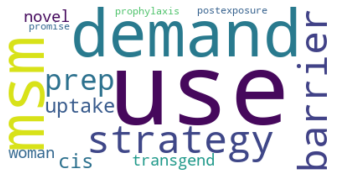


- More frequent words: use, demand, msm

- Main topics in cluster:
barriers to PrEP uptake and persistence among cis-and transgender women
Similarity between keywords and proposed clusters: 0.1

Text 1: Use of on-demand PrEP is increasing among MSM in the US. Strategies are needed to address barriers to PrEP uptake and persistence among cis-and transgender women. Several novel regimens for postexposure prophylaxis show promise
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


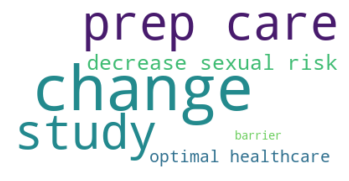


- More frequent chunks: change, prep care, study
WordCloud for chunks frequency in the cluster


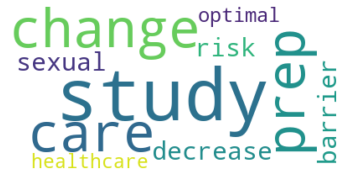


- More frequent words: study, change, prep

- Main topics in cluster:
barriers to optimal healthcare
Similarity between keywords and proposed clusters: 0.14

Text 2: Studies to understand whether changes in PrEP care reflect decreased sexual risk or barriers to optimal healthcare are needed
***********************
Sent is ['Longer-term impacts of COVID-19 restrictions on sexual behaviors among GBM need to be monitored because they may foreshadow fluctuations in prevention coverage and risk of HIV infection. Our findings indicate a potential need for clear, targeted information about resumption of PrEP and on-demand optimal dosing regimens in response to ongoing changes in restrictions']
Hierarchical Clustering dendrogram for label C
Sent is ['Use of on-demand PrEP is increasing among MSM in the US. Strategies are needed to address barriers to PrEP uptake and persistence among cis-and transgender women. Several novel regimens for postexposure prophylaxis show promise']
Hierarchical Clu

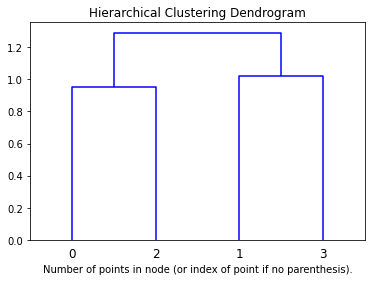

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 2
WordCloud for chunks according to Tf-Idf score:


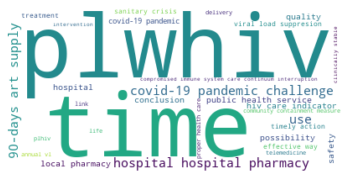


- More frequent chunks: plwhiv, time, hospital hospital pharmacy
WordCloud for chunks frequency in the cluster


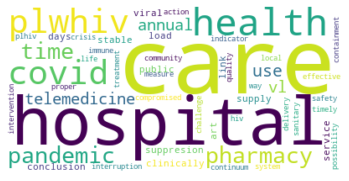


- More frequent words: care, hospital, health

- Main topics in cluster:
annual VL for those clinically stables, and 90-days ART supply
Similarity between keywords and proposed clusters: 0.44

Text 0: The use of telemedicine, annual VL for those clinically stables, and 90-days ART supply held link to public health services and viral load suppresion. Conclusion: PLWHIV are vulnerable during COVID-19 pandemic due to compromised immune system or care continuum interruption by community containment measures. Monitoring of HIV care indicators associated to timely actions is an effective way to overcome COVID-19 pandemic challenges and guarantee proper health care for PLWHIV
Text 2: The possibility to receive treatment via local pharmacies and/or delivery rather than attending hospitals is an intervention that could be considered to improve the quality of life of PLHIV by reducing the amount of times they would need to visit a hospital/hospital pharmacy and increase safety in times of sanit

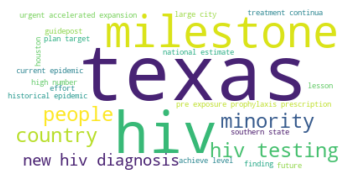


- More frequent chunks: texas, hiv, milestone
WordCloud for chunks frequency in the cluster


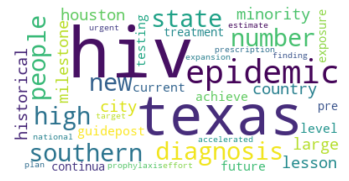


- More frequent words: hiv, texas, epidemic

- Main topics in cluster:
We examine the current epidemic in Texas
Similarity between keywords and proposed clusters: 0.22

Text 1: Texas is a Southern state that has one of the highest numbers of new HIV diagnoses and people with HIV in the country, and where HIV disproportionately impacts minorities. We retrace the historical epidemic in its largest city, Houston, to illustrate the lessons learned and milestones accomplished, which could serve as guideposts for the future. We examine the current epidemic in Texas, including the achieved levels of HIV testing, treatment continua, and pre-exposure prophylaxis prescription, and compare and contrast these with the national estimates and Plan targets. Our findings call for urgent and accelerated expansion of efforts to end HIV in Texas
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:

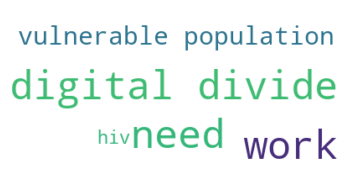


- More frequent chunks: digital divide, work, need
WordCloud for chunks frequency in the cluster


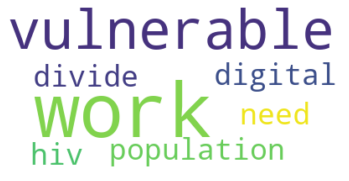


- More frequent words: work, vulnerable, population

- Main topics in cluster:
digital divide
Similarity between keywords and proposed clusters: 0.23

Text 3: Our work demonstrates that to serve the most vulnerable populations living with HIV more needs to be done to address the digital divide
***********************
Sent is ['The use of telemedicine, annual VL for those clinically stables, and 90-days ART supply held link to public health services and viral load suppresion. Conclusion: PLWHIV are vulnerable during COVID-19 pandemic due to compromised immune system or care continuum interruption by community containment measures. Monitoring of HIV care indicators associated to timely actions is an effective way to overcome COVID-19 pandemic challenges and guarantee proper health care for PLWHIV', 'The possibility to receive treatment via local pharmacies and/or delivery rather than attending hospitals is an intervention that could be considered to improve the quality of life of PLHIV 

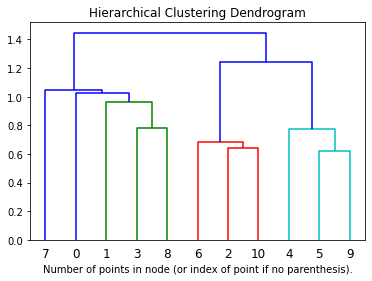

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 5
WordCloud for chunks according to Tf-Idf score:


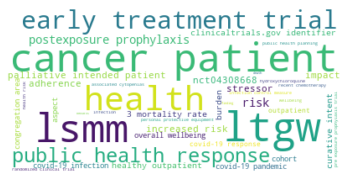


- More frequent chunks: ltgw, cancer patient, lsmm
WordCloud for chunks frequency in the cluster


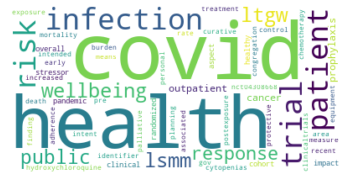


- More frequent words: covid-19, health, infection

- Main topics in cluster:
LSMM and LTGW
Similarity between keywords and proposed clusters: 0.44

Text 0: Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing
Text 1: Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial
Text 3: Focus on pre-and post-exposure, and outpatients, is worthwhile as a means of reducing infections and lessening the health, social, and economic burden of COVID-19
Text 7: Cancer patients living in congregation areas are susceptible to COVID-19 with 3% mortality rate.

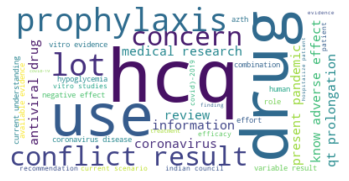


- More frequent chunks: hcq, drug, use
WordCloud for chunks frequency in the cluster


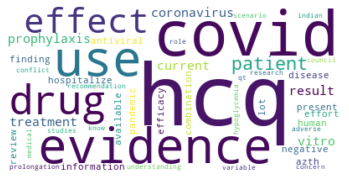


- More frequent words: hcq, covid-19, evidence

- Main topics in cluster:
Clinical studies, case reports, and in vitro studies
Similarity between keywords and proposed clusters: 0.44

Text 2: The negative effects are more pronounced in hospitalized patients. Therefore, with the available evidence, HCQ should not be used in prophylaxis or treatment of patients with COVID-19
Text 6: Our findings do not support the use of HCQ, either alone or in combination with AZTH, as an antiviral drug for the treatment of COVID-19 in humans
Text 10: In the present pandemic of coronavirus disease (COVID)-2019, the drug is being repurposed, based on its in vitro evidence of efficacy against coronavirus. There has been a lot of information, for and against the drug, and this review is an effort to bring forth the evidence and current understanding regarding role of HCQ in COVID-19. Clinical studies, case reports, and in vitro studies have generated conflicting results. There are concerns for use of HCQ 

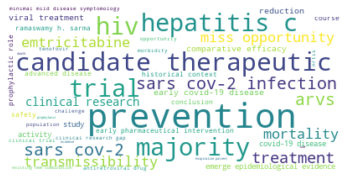


- More frequent chunks: prevention, candidate therapeutic, hepatitis c
WordCloud for chunks frequency in the cluster


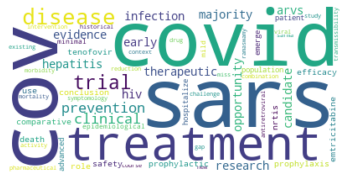


- More frequent words: sars, cov-2, covid-19

- Main topics in cluster:
challenges and opportunities for clinical research
Similarity between keywords and proposed clusters: 0.52

Text 4: NRTIs like tenofovir and emtricitabine might exhibit a prophylactic role against SARS-CoV-2 infection. In conclusion, currently there is no evidence to justify the use of ARVs for prophylaxis against COVID-19
Text 5: The majority of these trials are designed to evaluate the comparative efficacy and safety of candidate therapeutics for the treatment of COVID-19 to prevent death among populations of hospitalized patients with advanced disease. Yet, emerging epidemiological evidence now indicates that the majority of those infected with the SARS-CoV-2, while still infectious, experience minimal or mild disease symptomology. Like HIV and hepatitis C that pioneered treatment as prevention, there is a missed opportunity for trials of early pharmaceutical intervention for COVID-19 disease evaluating not onl

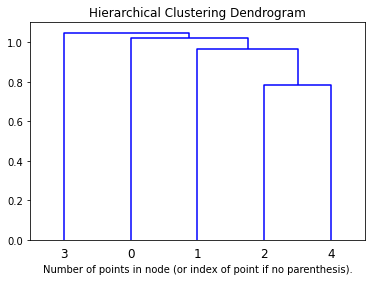

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


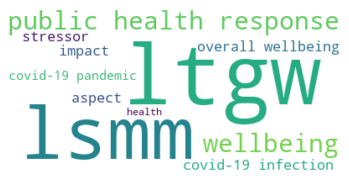


- More frequent chunks: ltgw, lsmm, public health response
WordCloud for chunks frequency in the cluster


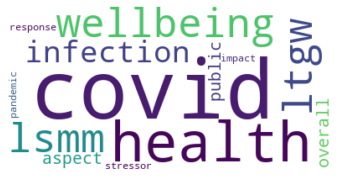


- More frequent words: covid-19, health, wellbeing

- Main topics in cluster:
LSMM and LTGW
Similarity between keywords and proposed clusters: 0.45

Text 0: Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.1: 3
WordCloud for chunks according to Tf-Idf score:


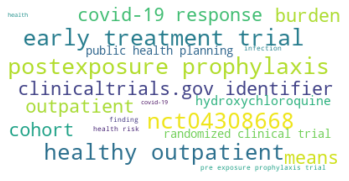


- More frequent chunks: early treatment trial, postexposure prophylaxis, nct04308668
WordCloud for chunks frequency in the cluster


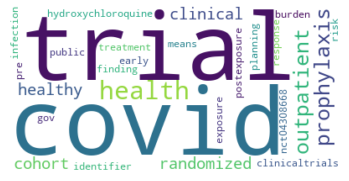


- More frequent words: trial, covid-19, health

- Main topics in cluster:
postexposure prophylaxis and early treatment trials
Similarity between keywords and proposed clusters: 0.44

Text 1: Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial
Text 2: Focus on pre-and post-exposure, and outpatients, is worthwhile as a means of reducing infections and lessening the health, social, and economic burden of COVID-19
Text 4: These findings will support public health planning to mitigate against health risks during and after the COVID-19 response.
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


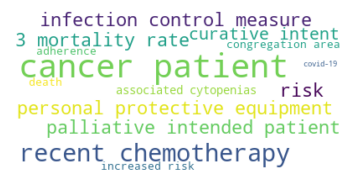


- More frequent chunks: cancer patient, recent chemotherapy, personal protective equipment
WordCloud for chunks frequency in the cluster


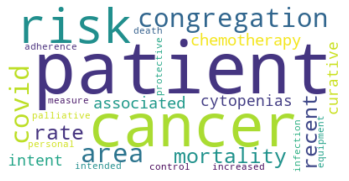


- More frequent words: patient, cancer, risk

- Main topics in cluster:
N-95, personal protective equipment, and adherence to infection control measures
Similarity between keywords and proposed clusters: 0.51

Text 3: Cancer patients living in congregation areas are susceptible to COVID-19 with 3% mortality rate. Recent chemotherapy and associated cytopenias may not increase the risk in cancer patients with COVID-19 treated with curative intent. Palliative intended patients are at increased risk of death. N-95, personal protective equipment, and adherence to infection control measures should be encouraged
***********************
Sent is ['Though no COVID-19 infections were noted, COVID-19 dramatically impacted other aspects of health and overall wellbeing of LSMM and LTGW. Public health responses should address the stressors faced by LSMM and LTGW during the COVID-19 pandemic and the impact on wellbeing']
Hierarchical Clustering dendrogram for label C
Sent is ['Randomized clinical tri

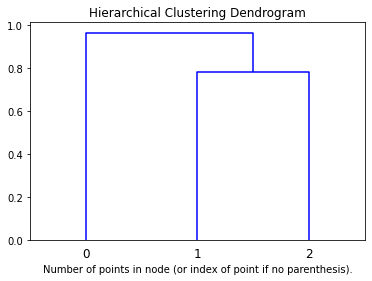

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


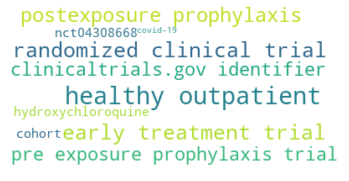


- More frequent chunks: healthy outpatient, randomized clinical trial, early treatment trial
WordCloud for chunks frequency in the cluster


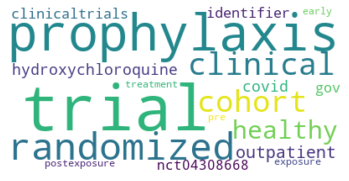


- More frequent words: trial, prophylaxis, randomized

- Main topics in cluster:
postexposure prophylaxis and early treatment trials
Similarity between keywords and proposed clusters: 0.45

Text 0: Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


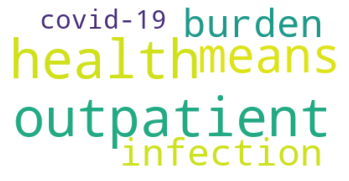


- More frequent chunks: outpatient, health, means
WordCloud for chunks frequency in the cluster


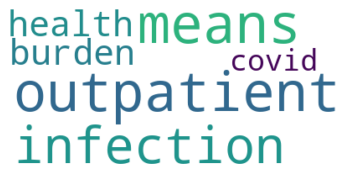


- More frequent words: outpatient, means, infection

- Main topics in cluster:
pre-and post-exposure, and outpatients
Similarity between keywords and proposed clusters: 0.56

Text 1: Focus on pre-and post-exposure, and outpatients, is worthwhile as a means of reducing infections and lessening the health, social, and economic burden of COVID-19
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


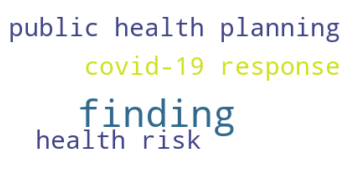


- More frequent chunks: finding, public health planning, health risk
WordCloud for chunks frequency in the cluster


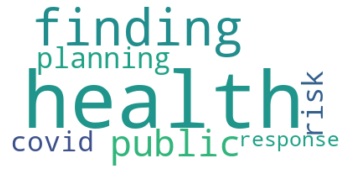


- More frequent words: health, finding, public

- Main topics in cluster:
COVID-19 response.
Similarity between keywords and proposed clusters: 0.48

Text 2: These findings will support public health planning to mitigate against health risks during and after the COVID-19 response.
***********************
Sent is ['Randomized clinical trials, in cohorts of healthy outpatients, can safely investigate whether hydroxychloroquine is efficacious for COVID-19. ClinicalTrials.gov Identifier: NCT04308668 for postexposure prophylaxis and early treatment trials; NCT04328467 for pre-exposure prophylaxis trial']
Hierarchical Clustering dendrogram for label C
Sent is ['Focus on pre-and post-exposure, and outpatients, is worthwhile as a means of reducing infections and lessening the health, social, and economic burden of COVID-19']
Hierarchical Clustering dendrogram for label C
Sent is ['These findings will support public health planning to mitigate against health risks during and after the COVID-19

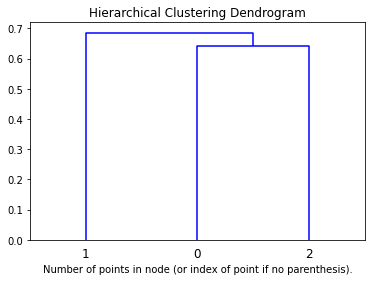

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:
Sent is ['NRTIs like tenofovir and emtricitabine might exhibit a prophylactic role against SARS-CoV-2 infection. In conclusion, currently there is no evidence to justify the use of ARVs for prophylaxis against COVID-19', 'The majority of these trials are designed to evaluate the comparative efficacy and safety of candidate therapeutics for the treatment of COVID-19 to prevent death among populations of hospitalized patients with advanced disease. Yet, emerging epidemiological evidence now indicates that the majority of those infected with the SARS-CoV-2, while still infectious, experience minimal or mild disease symptomology. Like HIV and hepatitis C that pioneered treatment as prevention, there is a missed opportunity for trials of early pharmaceutical intervention for COVID-19 disease evaluating not only reductions in morbidity and mortality but als

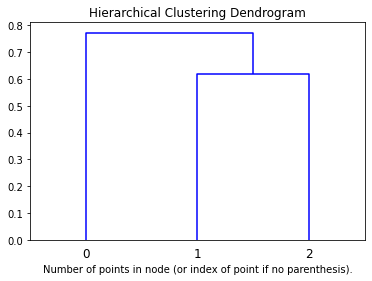

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


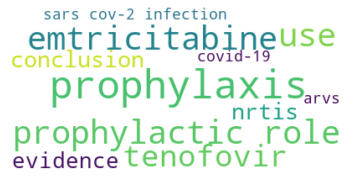


- More frequent chunks: prophylaxis, prophylactic role, emtricitabine
WordCloud for chunks frequency in the cluster


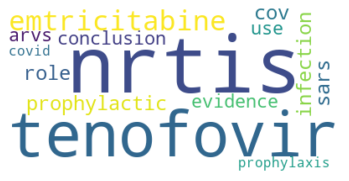


- More frequent words: nrtis, tenofovir, emtricitabine

- Main topics in cluster:
COVID-19
Similarity between keywords and proposed clusters: 0.46

Text 0: NRTIs like tenofovir and emtricitabine might exhibit a prophylactic role against SARS-CoV-2 infection. In conclusion, currently there is no evidence to justify the use of ARVs for prophylaxis against COVID-19
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


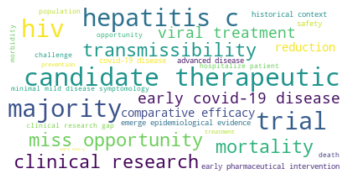


- More frequent chunks: candidate therapeutic, hepatitis c, majority
WordCloud for chunks frequency in the cluster


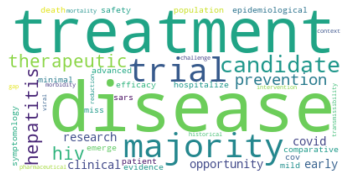


- More frequent words: disease, treatment, majority

- Main topics in cluster:
comment on the challenges and opportunities for clinical research
Similarity between keywords and proposed clusters: 0.55

Text 1: The majority of these trials are designed to evaluate the comparative efficacy and safety of candidate therapeutics for the treatment of COVID-19 to prevent death among populations of hospitalized patients with advanced disease. Yet, emerging epidemiological evidence now indicates that the majority of those infected with the SARS-CoV-2, while still infectious, experience minimal or mild disease symptomology. Like HIV and hepatitis C that pioneered treatment as prevention, there is a missed opportunity for trials of early pharmaceutical intervention for COVID-19 disease evaluating not only reductions in morbidity and mortality but also transmissibility. We discuss this clinical research gap within an historical context of viral treatment as prevention for HIV and hepatitis C, and

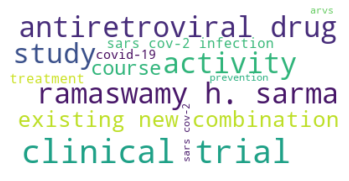


- More frequent chunks: clinical trial, antiretroviral drug, activity
WordCloud for chunks frequency in the cluster


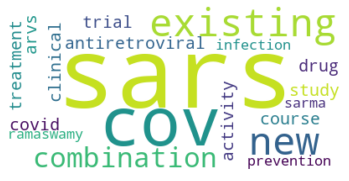


- More frequent words: sars, cov-2, existing

- Main topics in cluster:
Further studies are needed
Similarity between keywords and proposed clusters: 0.52

Text 2: Existing or new combinations of antiretroviral drugs could potentially prevent or ameliorate the course of COVID-19 if shown to inhibit SARS-CoV-2 in vitro and in clinical trials. Further studies are needed to establish the activity of ARVs for treatment or prevention of SARS-CoV-2 infection. Communicated by Ramaswamy H. Sarma
***********************
Sent is ['NRTIs like tenofovir and emtricitabine might exhibit a prophylactic role against SARS-CoV-2 infection. In conclusion, currently there is no evidence to justify the use of ARVs for prophylaxis against COVID-19']
Hierarchical Clustering dendrogram for label C
Sent is ['The majority of these trials are designed to evaluate the comparative efficacy and safety of candidate therapeutics for the treatment of COVID-19 to prevent death among populations of hospitalized patient

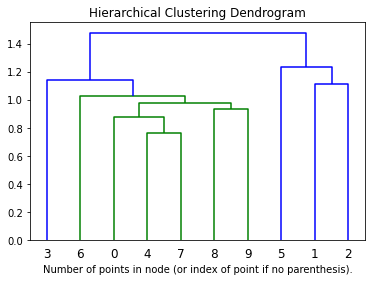

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 7
WordCloud for chunks according to Tf-Idf score:


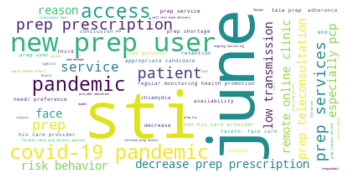


- More frequent chunks: sti, june, new prep user
WordCloud for chunks frequency in the cluster


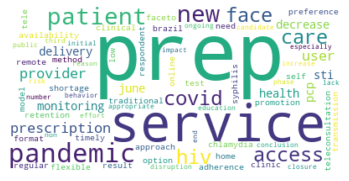


- More frequent words: prep, pandemic, service

- Main topics in cluster:
Ongoing
Similarity between keywords and proposed clusters: 0.36

Text 0: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
Text 3: While most respondents rated the service highly, others identified a need/ preference for face-to-face appointments. Therefore, our service will continue tele-PrEP whilst ensuring availability of faceto- face care for those who require or request it.
Text 4: PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access in a format that some patients prefer
Text 6: The new methods of providing and managing our PrEP service are working well and are robust. N

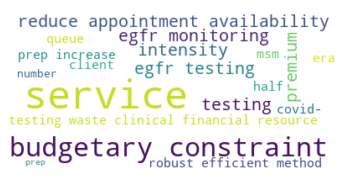


- More frequent chunks: service, budgetary constraint, reduce appointment availability
WordCloud for chunks frequency in the cluster


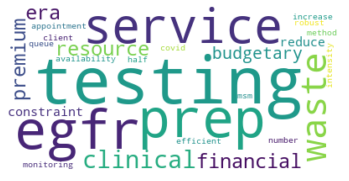


- More frequent words: testing, egfr, prep

- Main topics in cluster:
COVID- 19
Similarity between keywords and proposed clusters: 0.24

Text 1: Whilst it is vital that eGFR testing is not missed, over-testing wastes clinical and financial resources which are at a premium in an era of budgetary constraints and reduced appointment availability due to COVID- 19. As the number of clients taking PrEP increases, it is important for all services to ensure robust and efficient methods of eGFR monitoring.
Text 2: and mandatory pre-registration (to avoid queues), we were able to successfully saved services, and increase the intensity of testing and staging to PrEP for MSM compared to the first half of 2020
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


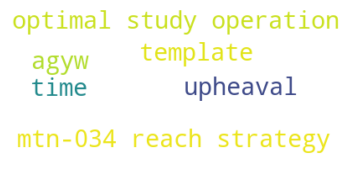


- More frequent chunks: mtn-034 reach strategy, optimal study operation, agyw
WordCloud for chunks frequency in the cluster


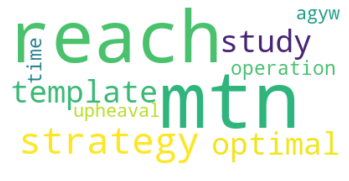


- More frequent words: mtn-034, reach, strategy

- Main topics in cluster:
MTN-034/REACH strategy serves as a template for optimal study
Similarity between keywords and proposed clusters: 0.06

Text 5: The MTN-034/REACH strategy serves as a template for optimal study operations during times of upheaval, especially when supporting AGYW
***********************
Sent is ['Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence', 'While most respondents rated the service highly, others identified a need/ preference for face-to-face appointments. Therefore, our service will continue tele-PrEP whilst ensuring availability of faceto- face care for those who require or request it.', 'PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. Th

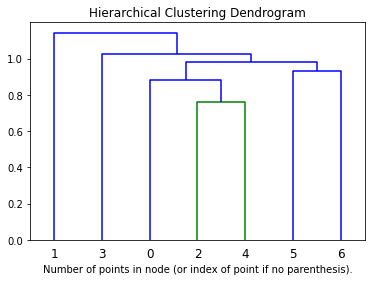

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 5
WordCloud for chunks according to Tf-Idf score:


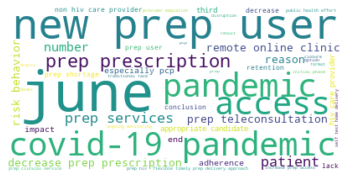


- More frequent chunks: june, new prep user, covid-19 pandemic
WordCloud for chunks frequency in the cluster


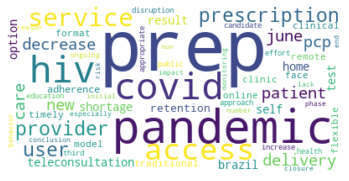


- More frequent words: prep, pandemic, hiv

- Main topics in cluster:
PrEP teleconsultation and PrEP/HIV self-testing
Similarity between keywords and proposed clusters: 0.4

Text 0: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
Text 2: PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access in a format that some patients prefer
Text 4: Patients were still able to access PrEP clinical services during the COVID-19 pandemic. Implementing flexible and timely PrEP delivery approaches in this setting likely minimized the disruption of PrEP care during COVID-19
Text 5: PCPs prescribed over two-thirds of the PrEP prescriptions and most PrEP users were tre

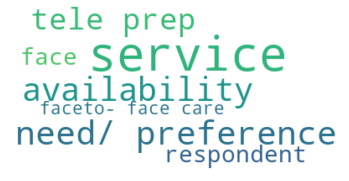


- More frequent chunks: service, need/ preference, availability
WordCloud for chunks frequency in the cluster


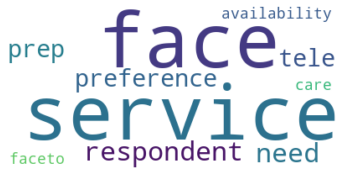


- More frequent words: service, face, respondent

- Main topics in cluster:
appointments
Similarity between keywords and proposed clusters: 0.12

Text 1: While most respondents rated the service highly, others identified a need/ preference for face-to-face appointments. Therefore, our service will continue tele-PrEP whilst ensuring availability of faceto- face care for those who require or request it.
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


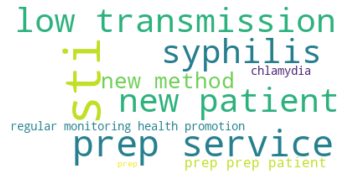


- More frequent chunks: sti, prep service, low transmission
WordCloud for chunks frequency in the cluster


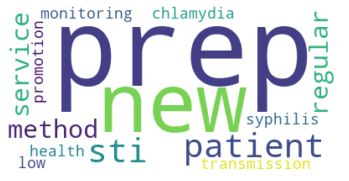


- More frequent words: prep, new, patient

- Main topics in cluster:
health promotion for other STIs
Similarity between keywords and proposed clusters: 0.18

Text 3: The new methods of providing and managing our PrEP service are working well and are robust. New patients can be started on PrEP and PrEP patients monitored appropriately. It is important while providing PrEP to also undertake regular monitoring and health promotion for other STIs such as chlamydia and syphilis to help lower transmission of all STIs
***********************
Sent is ['Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence', 'PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access

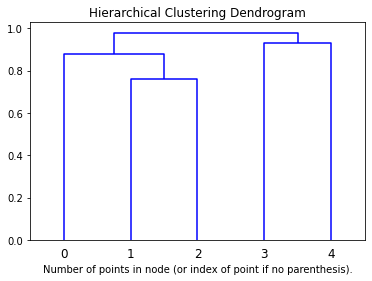

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 3
WordCloud for chunks according to Tf-Idf score:


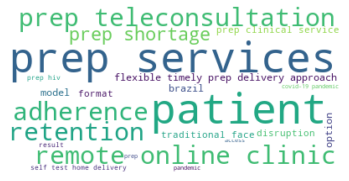


- More frequent chunks: prep services, patient, prep teleconsultation
WordCloud for chunks frequency in the cluster


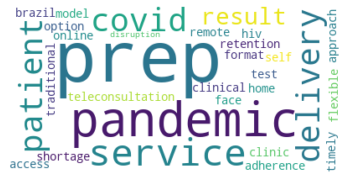


- More frequent words: prep, pandemic, delivery

- Main topics in cluster:
PrEP teleconsultation and PrEP/HIV self-testing
Similarity between keywords and proposed clusters: 0.39

Text 0: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
Text 1: PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access in a format that some patients prefer
Text 2: Patients were still able to access PrEP clinical services during the COVID-19 pandemic. Implementing flexible and timely PrEP delivery approaches in this setting likely minimized the disruption of PrEP care during COVID-19
***********************
*********************
Analysis of the label 'C'

- Number of ele

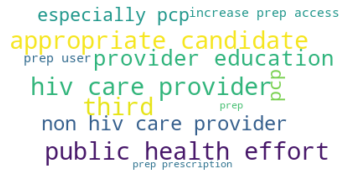


- More frequent chunks: appropriate candidate, hiv care provider, public health effort
WordCloud for chunks frequency in the cluster


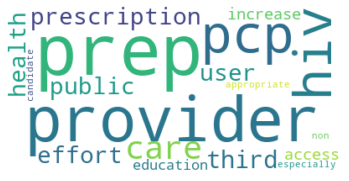


- More frequent words: prep, provider, pcp

- Main topics in cluster:
PrEP
Similarity between keywords and proposed clusters: 0.23

Text 3: PCPs prescribed over two-thirds of the PrEP prescriptions and most PrEP users were treated by an HIV care provider. Public health efforts should focus on increasing PrEP access by enhancing provider education to identify appropriate candidates for PrEP, especially PCPs and non-HIV care providers
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


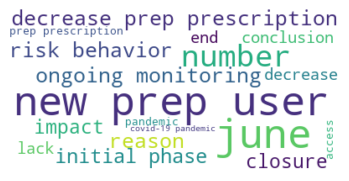


- More frequent chunks: new prep user, june, number
WordCloud for chunks frequency in the cluster


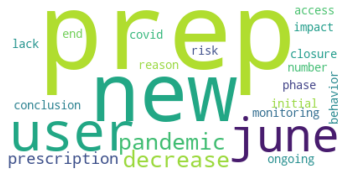


- More frequent words: prep, new, user

- Main topics in cluster:
Closures during the initial phase of the COVID-19 pandemic
Similarity between keywords and proposed clusters: 0.43

Text 4: The number of new PrEP users began to increase towards the end of June 2020. Conclusion: Closures during the initial phase of the COVID-19 pandemic resulted in decreases in PrEP prescriptions and even more in new PrEP users. Ongoing monitoring is warranted to assess whether the impact has abated since June 2020. The reasons for decreased PrEP prescriptions could be lack of access to care or decreased risk behavior during the pandemic
***********************
Sent is ['Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence', 'PrEP services can be safely delivered outside of the traditional face to face set

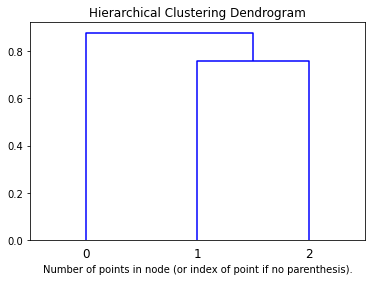

*********************
Analysis of the label 'C'

- Number of elements per cluster n.0: 1
WordCloud for chunks according to Tf-Idf score:


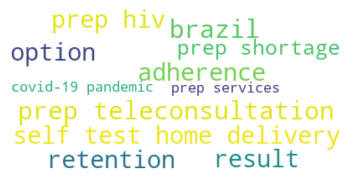


- More frequent chunks: prep teleconsultation, brazil, self test home delivery
WordCloud for chunks frequency in the cluster


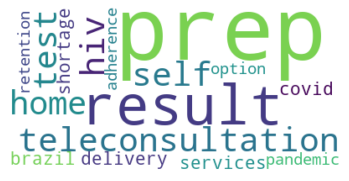


- More frequent words: prep, result, teleconsultation

- Main topics in cluster:
PrEP
Similarity between keywords and proposed clusters: 0.35

Text 0: Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.1: 1
WordCloud for chunks according to Tf-Idf score:


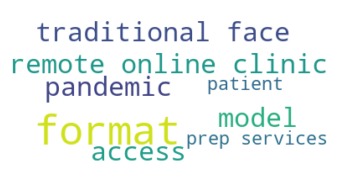


- More frequent chunks: format, remote online clinic, pandemic
WordCloud for chunks frequency in the cluster


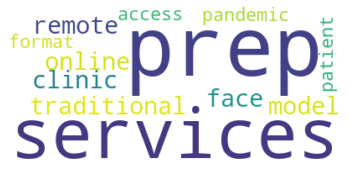


- More frequent words: prep, services, traditional

- Main topics in cluster:
pandemic
Similarity between keywords and proposed clusters: 0.25

Text 1: PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access in a format that some patients prefer
***********************
*********************
Analysis of the label 'C'

- Number of elements per cluster n.2: 1
WordCloud for chunks according to Tf-Idf score:


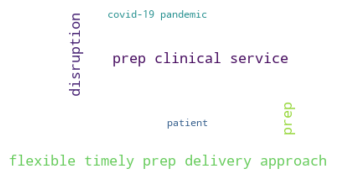


- More frequent chunks: flexible timely prep delivery approach, prep clinical service, prep
WordCloud for chunks frequency in the cluster


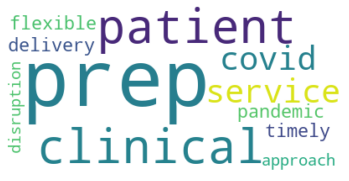


- More frequent words: prep, patient, clinical

- Main topics in cluster:
COVID-19 pandemic.
Similarity between keywords and proposed clusters: 0.46

Text 2: Patients were still able to access PrEP clinical services during the COVID-19 pandemic. Implementing flexible and timely PrEP delivery approaches in this setting likely minimized the disruption of PrEP care during COVID-19
***********************
Sent is ['Our results point out that PrEP teleconsultation and PrEP/HIV self-testing home delivery could be implemented by PrEP services in Brazil to avoid PrEP shortage during the COVID-19 pandemic and thereafter as an option to increase retention and adherence']
Hierarchical Clustering dendrogram for label C
Sent is ['PrEP services can be safely delivered outside of the traditional face to face setting via remote or online clinics. These models could also be applied outside of the pandemic to improve access in a format that some patients prefer']
Hierarchical Clustering dendrogram for 

In [12]:
labels_index = data_preprocessing('sample.xlsx') #rdf

def automatic_execution(labels_index, PICO_label,operation_number, keyword, original_file): #cluster number omesso momentaneamente
  step1 = clustering_manager.execute (labels_index, PICO_label=PICO_label, operation_number = 0, keyword = keyword , original_file='sample.xlsx')  

  for pos,cluster in enumerate(step1[PICO_label[0]]): #[1],2,3 --> [1],2,3 
        step2 = {PICO_label[0]:[ele for pos,ele in cluster]}
        try:
          automatic_execution(step2, PICO_label=PICO_label[0], operation_number=0, keyword = keyword, original_file = original_file) 
        except:
          pass

pico_labels = ['A','P', 'I', 'O', 'M', 'R', 'C']
for label in pico_labels:
  automatic_execution (labels_index, PICO_label=[label],operation_number=0, keyword = ['Covid-19'], original_file='sample.xlsx')
